In [1]:
import datetime
import sys
sys.path.append("..")
import random
from numpy.random import default_rng
from annoy import AnnoyIndex
import torch.autograd as autograd
from typing import List
import anndata
from functools import partial
from copy import deepcopy

from torch.autograd import Variable
import torch.backends.cudnn as cudnn
from sklearn.metrics import (adjusted_rand_score, calinski_harabasz_score,
                             normalized_mutual_info_score, silhouette_score)
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn import preprocessing
import math
import utils
from sklearn import metrics
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.manifold import TSNE
import colorcet as cc

import math
from scipy import sparse
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from random import sample
from torch.nn.parameter import Parameter
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.nn.utils.spectral_norm as spectral_norm
import torch.nn.utils.weight_norm as weight_norm
import torch.optim.lr_scheduler as lr_scheduler
import scanpy as sc
import time
import os
from scipy import sparse
from adabelief_pytorch import AdaBelief
import torch.quantization

import gzip

from torch.utils.data import WeightedRandomSampler

from sklearn.preprocessing import MinMaxScaler
import gc

torch.cuda.set_device(0)

def setup_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True

from anndata import AnnData
    
plt.ion()
plt.show()
%load_ext autoreload
%autoreload 2

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

# import warnings
# warnings.filterwarnings("ignore")

path= "../"

torch.autograd.set_detect_anomaly(True)
torch.autograd.profiler.profile(False)
torch.autograd.profiler.emit_nvtx(False)

########## NEURAL NETWORK UTILITY ##########
cuda = True if torch.cuda.is_available() else False
FloatTensor = torch.cuda.FloatTensor if cuda else torch.FloatTensor
LongTensor = torch.cuda.LongTensor if cuda else torch.LongTensor

CPUTensor =  torch.FloatTensor

In [2]:
# Enable autocompletion
%config Completer.use_jedi = False

In [3]:
# import os
# import psutil

# # Get the current process
# p = psutil.Process(os.getpid())

# # Set the process to run only on the first CPU core
# p.cpu_affinity([0])

In [4]:
sc.settings.verbosity = 1

sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')

In [5]:
## /acrc/jinmiao/CJM_lab/hoatran/demo_normalization/dataset/dataset5_human_pbmc/raw_data_python/myTotalData.h5ad

In [6]:
import scipy.io as sio
import scipy.sparse as sp
import h5py

In [7]:
import sklearn
sklearn.__version__

'1.3.2'

## Reading the data

## Now read the matrix

HiSeq 2500 data for sequencing of PBMCs from SLE patients and 2 controls. We collected 1M cells each from frozen PBMC samples that were Ficoll isolated and prepared using the 10x Single Cell instrument according to standard protocol. Samples A, B, and C were prepared on the instrument directly following thaw, while samples 2.1 and 2.2 were cultured for 6 hours with (B) or without (A) IFN-beta stimulation prior to loading on the 10x Single Cell instrument.

In [8]:
adata = sc.read_h5ad("data/indranil_time.h5ad")
# adata = adata[adata.obs.multiplets == "singlet"].copy()

# remove the null value from the dataset
# adata = adata[np.array(~adata.obs.condition.isna())]
# adata = adata[adata.obs["GSM"].isin(["GSM2836284", "GSM2836288"])].copy()


# adata_test = sc.read_h5ad("data/SchiebingerLander2019_GSE115943.h5ad")
# adata_test = adata_test[np.array(~adata_test.obs.condition.isna())]
# adata_test = adata_test[adata_test.obs["GSM"].isin(["GSM3195770", "GSM3195772"])]

# adata = adata.concatenate(adata_test)

# adata = adata[adata.obs["sample"].isin(["PW032"])]

# adata = adata[np.array(adata.obs["GSM"].isin(["GSM2836281", "GSM2836283"]))]

# remove nan values from the dataset

# storing the layers count
# adata.layers["counts"] = adata.X
# KLF1
# targeted_label = "KLF1"

In [9]:
adata.obs

,orig_ident,nCount_RNA,nFeature_RNA,sample,percent_mt,RNA_snn_res_0_8,seurat_clusters,cell_type,cell_type_score,sampling_weight,Sample,Project,Status,Sample Type,Platform,Cellline,Condition (Hour)
V1_T2,0,36537.0,6474,GSM6047811,0.0,2,2,Cycling keratinocyte,skin,16.554127,GSM6047811,GSE200981,QC pass,Cell Line,SureCell,MCF10A,24
V2_T2,0,34294.0,5971,GSM6047811,0.0,2,2,Cycling keratinocyte,skin,11.905062,GSM6047811,GSE200981,QC pass,Cell Line,SureCell,MCF10A,24
V3_T2,0,32446.0,6093,GSM6047811,0.0,2,2,Cycling keratinocyte,skin,14.764727,GSM6047811,GSE200981,QC pass,Cell Line,SureCell,MCF10A,24
V4_T2,0,31193.0,5902,GSM6047811,0.0,2,2,Cycling keratinocyte,skin,13.485236,GSM6047811,GSE200981,QC pass,Cell Line,SureCell,MCF10A,24
V5_T2,0,30444.0,5808,GSM6047811,0.0,2,2,Cycling keratinocyte,skin,30.009970,GSM6047811,GSE200981,QC pass,Cell Line,SureCell,MCF10A,24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V264_T4,0,1347.0,879,GSM6047813,0.0,0,0,Mammary basal cell,breast_milk,18.437191,GSM6047813,GSE200981,QC pass,Cell Line,SureCell,MCF10A,96
V265_T4,0,1349.0,811,GSM6047813,0.0,1,1,SFN mammary luminal progenitor,breast,14.219676,GSM6047813,GSE200981,QC pass,Cell Line,SureCell,MCF10A,96
V266_T4,0,1257.0,803,GSM6047813,0.0,1,1,SFN mammary luminal progenitor,breast,33.411132,GSM6047813,GSE200981,QC pass,Cell Line,SureCell,MCF10A,96
V267_T4,0,1255.0,727,GSM6047813,0.0,0,0,Mammary basal cell,breast_milk,25.546997,GSM6047813,GSE200981,QC pass,Cell Line,SureCell,MCF10A,96


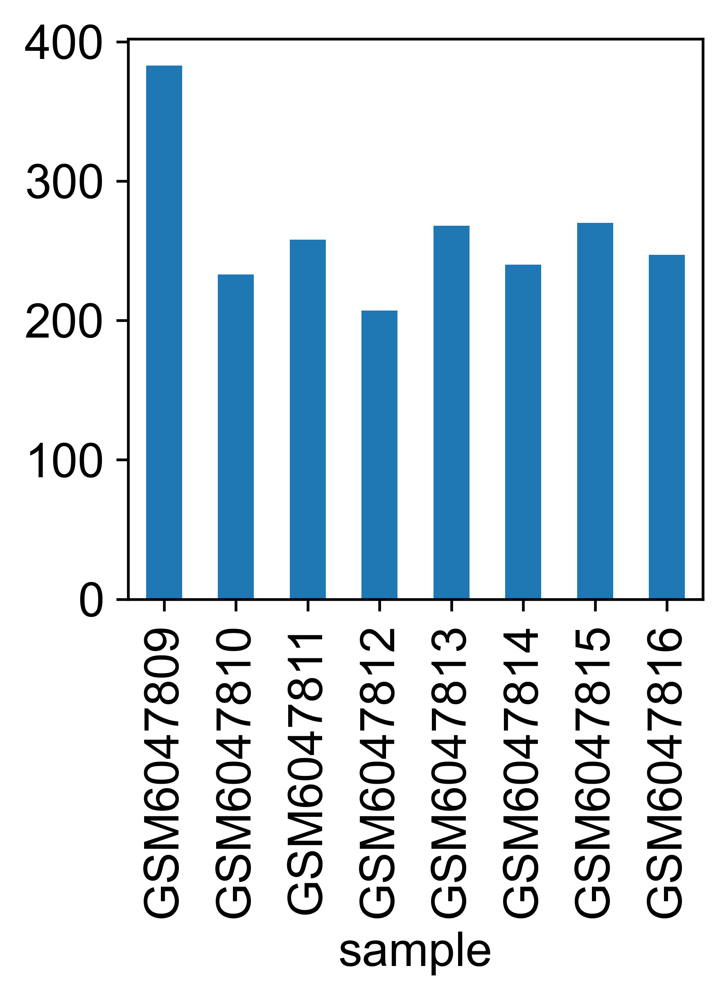

In [10]:
adata.obs.groupby(["sample"]).size().plot(kind="bar")
plt.grid(False)

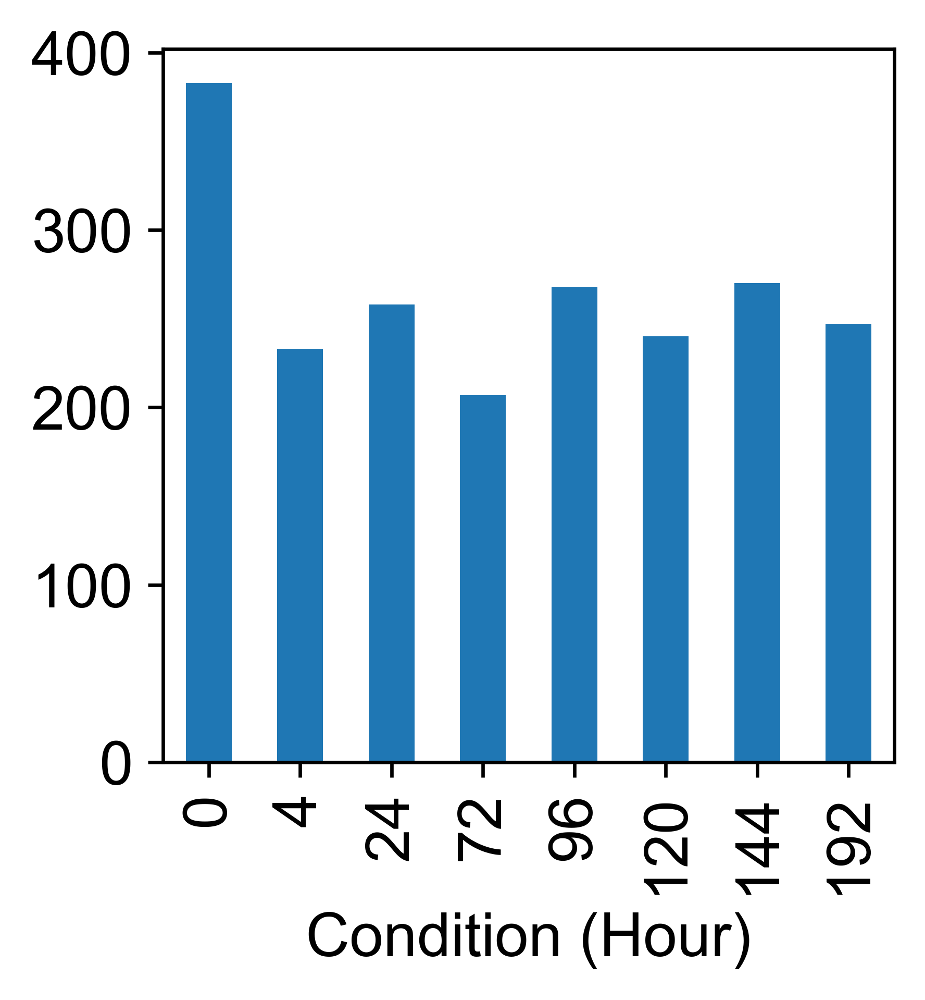

In [11]:
adata.obs.groupby(["Condition (Hour)"]).size().plot(kind="bar")
plt.grid(False)

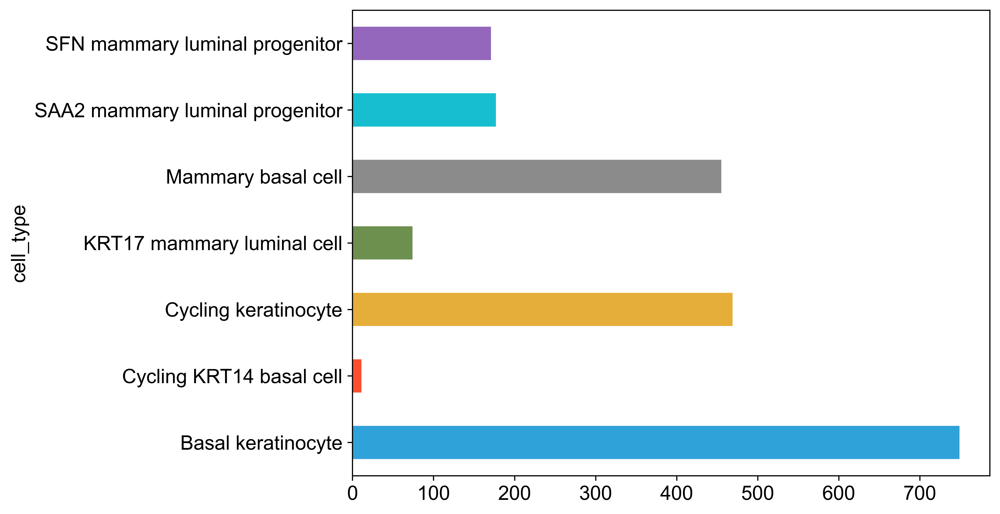

In [12]:
custom_palette = cc.glasbey_hv
adata.obs.groupby(["cell_type"]).size().plot.barh(color=custom_palette, figsize = (8, 6))
plt.grid(False)

In [13]:
targeted_label = "stim"

In [14]:
# adata = adata[adata.obs.condition.isin(["control", "IFNGR1g1", "IFNGR1g2", "IFNGR1g3", "IFNGR1g4"])].copy()

In [15]:
# adata.obs.groupby(["GSM", "condition"]).size()
# adata.obs.groupby(["sample", "tissue"]).size()

In [16]:
# adata.obs

In [17]:
# count the number of unique condition
count_dict = {}

for each in adata.obs["Condition (Hour)"]:
    if each not in count_dict:
        count_dict[each] = 0
        
    count_dict[each] += 1
    
count_dict = dict(sorted(count_dict.items(), key=lambda item: item[1], reverse = True))
count_dict

{0: 383, 144: 270, 96: 268, 24: 258, 192: 247, 120: 240, 4: 233, 72: 207}

In [18]:
# # count the number of unique condition
# count_dict = {}

# for each in adata.obs.GSM:
#     if each not in count_dict:
#         count_dict[each] = 0
        
#     count_dict[each] += 1
    
# count_dict = dict(sorted(count_dict.items(), key=lambda item: item[1], reverse = True))
# count_dict

# # found GSM2836281, and GSM2836283 to be the largest number of batches

In [19]:
np.amax(adata.X)

1119.9999999999995

In [20]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

# sc.pp.filter_cells(adata_test, min_genes=200)
# sc.pp.filter_genes(adata_test, min_cells=3)

In [21]:
adata.var

,n_cells
LINC00115,8
SAMD11,112
NOC2L,878
KLHL17,154
PLEKHN1,107
...,...
C21orf58,239
PCNT,543
DIP2A,624
PRMT2,1376


In [22]:
# for each in adata.var.index:
#     if each.startswith("MT"):
#         print(each)

In [23]:
adata.var['mt'] = adata.var.index.str.startswith('MT')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

# adata_test.var['mt'] = adata_test.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
# sc.pp.calculate_qc_metrics(adata_test, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

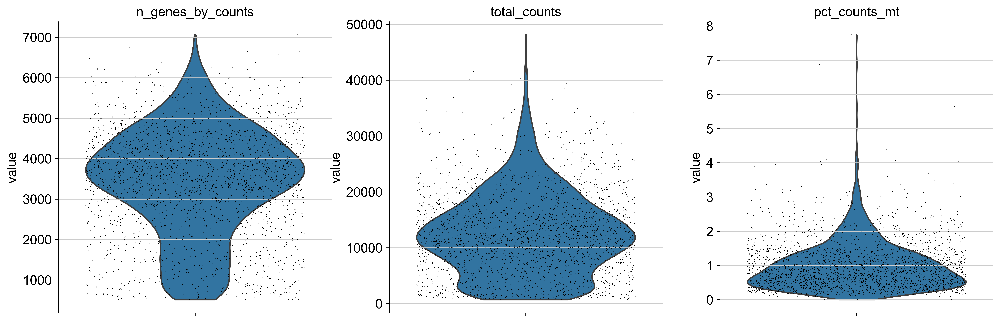

In [24]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

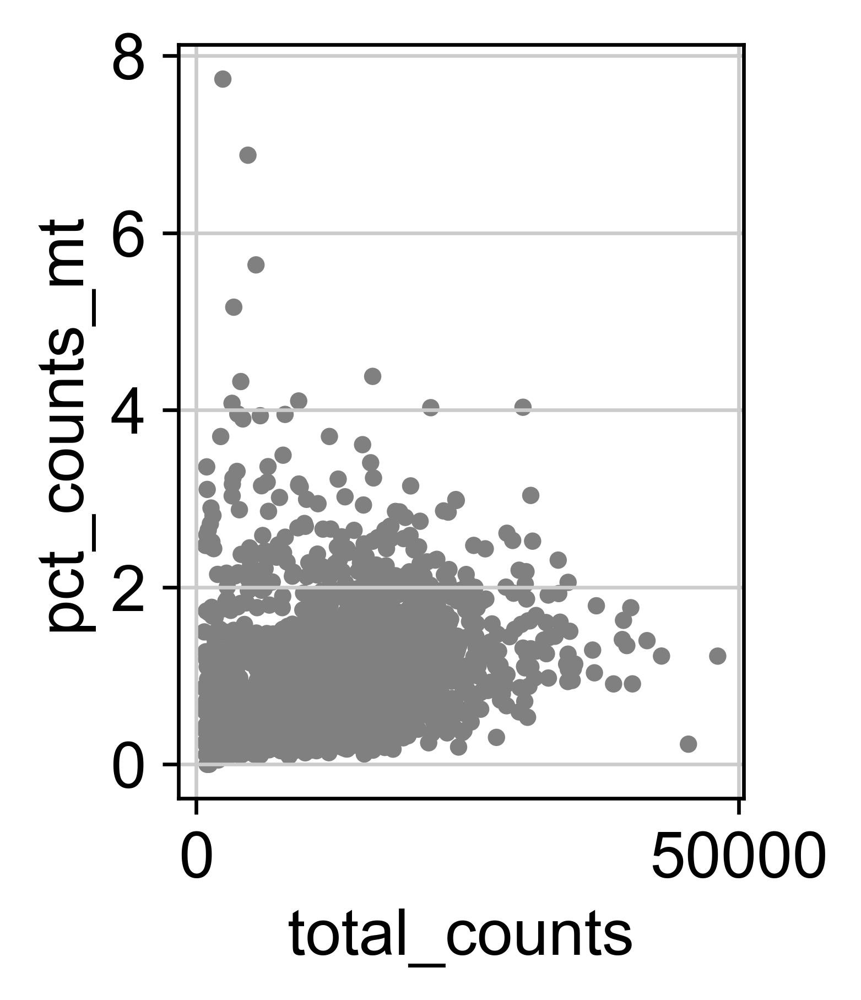

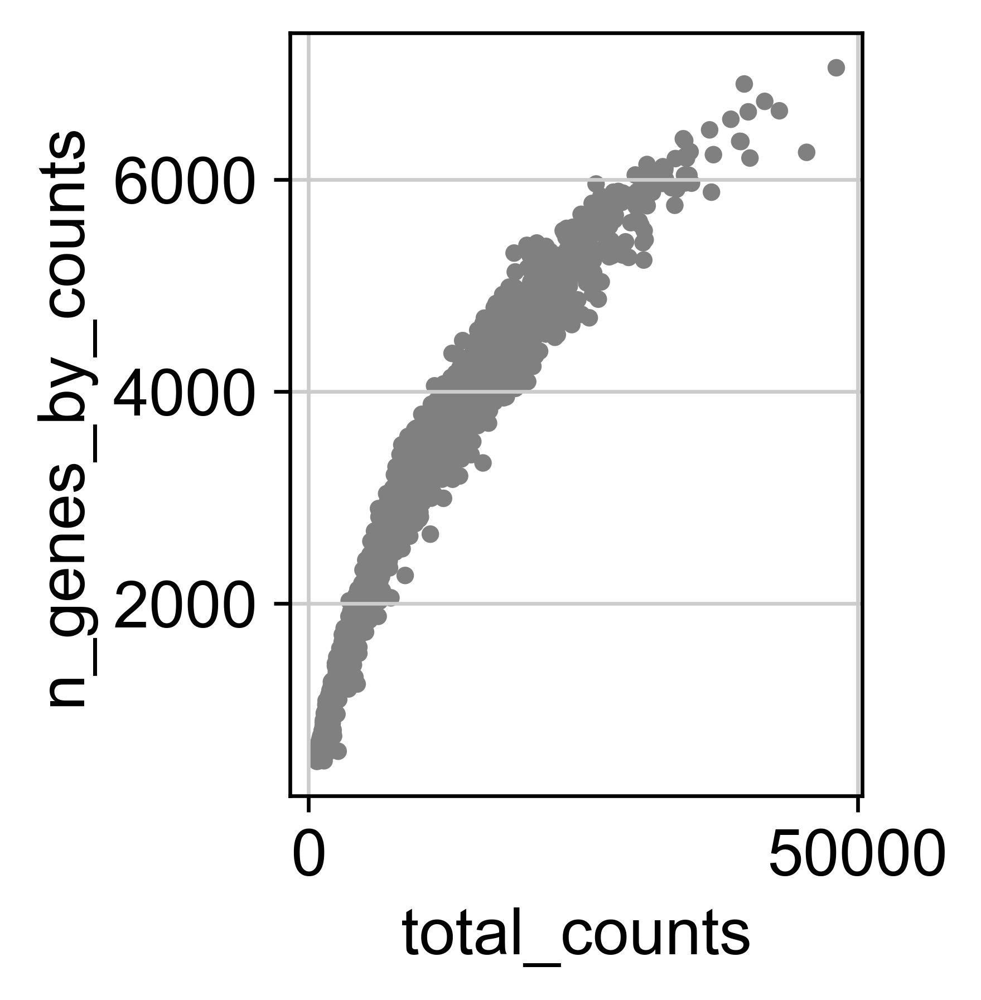

In [25]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [26]:
adata = adata[adata.obs.n_genes_by_counts < 5000, :]
adata = adata[adata.obs.pct_counts_mt < 2, :]

# adata_test = adata_test[adata_test.obs.n_genes_by_counts < 5000, :]
# adata_test = adata_test[adata_test.obs.pct_counts_mt < 8, :]

## Split the dataset into testing and training

In [27]:
# setup_seed(8)
# adata = adata[np.random.choice(165748, 10000, replace=False)]

In [28]:
adata

View of AnnData object with n_obs × n_vars = 1749 × 13062
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_pca', 'X_umap'

In [29]:
# sample_id_list = adata.obs["sample"].unique().to_list()

# # store all array in dictionary data
# sample_X_dict = {}

# # iterate through each sample id
# for each in sample_id_list:
#     temp_array = adata[adata.obs["sample"].isin([each])].X.toarray()
#     sample_X_dict[each] = temp_array

# # compute for correlation
# corr_list = []
# sample_size = len(sample_X_dict)

# for i in sample_id_list:
#     for j in sample_id_list:
#         corr_list.append(np.round(pairwise_feature_correlation(sample_X_dict[i], sample_X_dict[j]), 3))

# corr_list = np.array(corr_list).reshape((sample_size, sample_size))
# # corr_list

In [30]:
# corr_list

In [31]:
# # adata.obs["CellType"] = adata.obs["cell_type"]

# # adata.obs["CellType_tissue"] = adata.obs["CellType"].to_numpy() + adata.obs["tissue"].to_numpy()

# adata.obs["batch"] = adata.obs["condition"]

# le = preprocessing.LabelEncoder()
# new_batch = le.fit_transform(adata.obs["batch"])
# adata.obs["batch"] = new_batch

# new_batch = [str(each) for each in new_batch]
# adata.obs["batch_num"] = new_batch

# # # change also for the groups we want to preserve
# # le_2 = preprocessing.LabelEncoder()
# # new_groups = le_2.fit_transform(adata.obs["condition"])
# # new_groups = [int(each) for each in new_groups]
# # # new_groups = [str(each) for each in new_groups]
# # adata.obs["condition"] = new_groups

# # adata.obs["condition_num"] = le_2.inverse_transform(adata.obs['condition'])
# # adata.obs["condition_num"] = [str(each) for each in adata.obs["condition_num"]]

In [32]:
sc.__version__

'1.9.3'

In [33]:
# import scipy.special
# from sklearn.metrics.cluster import adjusted_rand_score


# def ari(adata, group1, group2, implementation="sklearn"):
#     """Adjusted Rand Index
#     The function is symmetric, so group1 and group2 can be switched
#     For single cell integration evaluation the comparison is between predicted cluster
#     assignments and the ground truth (e.g. cell type)
#     :param adata: anndata object
#     :param group1: string of column in adata.obs containing labels
#     :param group2: string of column in adata.obs containing labels
#     :param implementation: if set to 'sklearn', uses sklearn's implementation,
#         otherwise native implementation is taken
#     """

#     group1 = adata.obs[group1].to_numpy()
#     group2 = adata.obs[group2].to_numpy()

#     if len(group1) != len(group2):
#         raise ValueError(
#             f"different lengths in group1 ({len(group1)}) and group2 ({len(group2)})"
#         )

#     return adjusted_rand_score(group1, group2)

# def compute_ari(adata):

#     resolutions = None

#     if resolutions is None:
#         n = 20
#         resolutions = [2 * x / n for x in range(1, n + 1)]

#     score_max = 0
#     res_max = resolutions[0]
#     clustering = None
#     score_all = []
#     use_rep = "X_pca"
#     cluster_key = "louvain"
#     label_key = "CellType"

#     try:
#         adata.uns["neighbors"]
#     except KeyError:
#         if verbose:
#             print("computing neighbours for opt_cluster")
#         sc.pp.neighbors(adata, use_rep=use_rep)

#     for res in resolutions:
#         sc.tl.louvain(adata, resolution=res, key_added=cluster_key)
#         score = ari(adata, label_key, cluster_key)
#         score_all.append(score)
#         if score_max < score:
#             score_max = score
#             res_max = res
#             clustering = adata.obs[cluster_key]

#     return score_max

In [34]:
# flavor: seurat_v3, cell_ranger & log = false
def sub_data_preprocess(adata: sc.AnnData, n_top_genes: int = 5000, batch_key: str = None, flavor: str = 'seurat_v3', min_genes: int = 200, min_cells: int = 3) -> sc.AnnData:
#     sc.pp.filter_cells(adata, min_genes=min_genes)
#     sc.pp.filter_genes(adata, min_cells=min_cells)
    if flavor == 'seurat_v3':
# #         count data is expected when flavor=='seurat_v3'
#         sc.pp.highly_variable_genes(
#             adata, flavor=flavor, batch_key = batch_key)
        sc.pp.highly_variable_genes(
            adata, flavor=flavor, n_top_genes=n_top_genes)

#     if flavor != 'seurat_v3':.
#         # log-format data is expected when flavor!='seurat_v3'
#         sc.pp.highly_variable_genes(
#             adata, n_top_genes=n_top_genes, flavor=flavor)
    sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
    sc.pp.log1p(adata)
    return adata


def data_preprocess(adata: sc.AnnData, key: str = 'batch', n_top_genes: int = 2000, flavor: str = 'seurat_v3', min_genes: int = 200, min_cells: int = 3, n_batch: int = 2) -> sc.AnnData:
    print('Establishing Adata for Next Step...')
    hv_adata = sub_data_preprocess(adata, n_top_genes=n_top_genes, batch_key = key, flavor=flavor, min_genes=min_genes, min_cells=min_cells)
    if len(adata.var.index) > n_top_genes:
        hv_adata = hv_adata[:, hv_adata.var['highly_variable']]
#     hv_adata.X = np.expm1(hv_adata.X)
    print('PreProcess Done.')
    return hv_adata

In [35]:
# batch_str = "batch_num"

adata = data_preprocess(adata)
adata  # Output the basic information of the preprocessed data.

Establishing Adata for Next Step...


/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


PreProcess Done.


/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:149: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': 'seurat_v3'}


View of AnnData object with n_obs × n_vars = 1749 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p'
    obsm: 'X_pca', 'X_umap'

## EDA

Pairwise average correlation of the PCA embeddings of the control states between patients

In [36]:
# adata.write_h5ad("data/age_SE_hvg.h5ad")
# adata.read_h5ad("data/age_SE_hvg.h5ad")

In [37]:
try:
    adata.X = adata.X.toarray()
except:
    adata

In [38]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

def cosine_similarity_between_matrices(matrix1, matrix2):
    """
    Compute the cosine similarity between the rows of two matrices.

    Parameters:
    - matrix1: numpy array, the first matrix
    - matrix2: numpy array, the second matrix

    Returns:
    - cosine_similarity_score: float, the cosine similarity between the rows of the matrices
    """
    if matrix1.shape[1] != matrix2.shape[1]:
        raise ValueError("Matrices must have the same number of columns.")

    # Compute cosine similarity between the rows
    cosine_similarity_matrix = cosine_similarity(matrix1, matrix2)
    
    # Take the mean cosine similarity score as a measure of overall similarity
    cosine_similarity_score = np.mean(np.diagonal(cosine_similarity_matrix))

    return np.round(cosine_similarity_score, 3)

# Example usage:
matrix1 = np.random.rand(50, 100)  # Replace with your actual matrix1
matrix2 = np.random.rand(10, 100)  # Replace with your actual matrix2

result = cosine_similarity_between_matrices(matrix1, matrix2)
print("Cosine Similarity Score:", result)

Cosine Similarity Score: 0.749


In [39]:
def get_mean_corr(A, B):
    feature_mean_corr = np.corrcoef(A.mean(0), B.mean(0))

    # Set the middle diagonal elements to zero
    np.fill_diagonal(feature_mean_corr, 0)

    feature_mean_corr = np.triu(feature_mean_corr)
    
    return np.round(np.nanmean(np.where(feature_mean_corr!=0,feature_mean_corr,np.nan)), 3)

In [40]:
# This is mainly for the EDA purpose and wiLl not be used for the projection

pca = PCA(n_components = 30, random_state = 8)
pca.fit(adata.X.toarray())
# pca.fit(adata.X)

X_pca = pca.transform(adata.X.toarray())
# X_pca = pca.transform(adata.X)

adata.obsm["X_pca"] = X_pca.copy()

/tmp/ipykernel_84595/4235025148.py:10: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm["X_pca"] = X_pca.copy()


In [41]:
adata

AnnData object with n_obs × n_vars = 1749 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p'
    obsm: 'X_pca', 'X_umap'

In [42]:
sample_id_list = adata.obs["sample"].unique().to_list()

# store all array in dictionary data
sample_X_dict = {}

# iterate through each sample id
for each in sample_id_list:
    temp_array = adata[adata.obs["sample"].isin([each])].obsm["X_pca"]
    sample_X_dict[each] = temp_array

# compute for correlation
cosine_list = []
sample_size = len(sample_X_dict)

# computing sample to sample similarity
for i in sample_id_list:
    for j in sample_id_list:
        cosine_list.append(cosine_similarity_between_matrices(sample_X_dict[i], sample_X_dict[j]))
        # print("done")

# reshape into sample by sample shape
cosine_list = np.array(cosine_list).reshape((sample_size, sample_size))

# check for the matrix
# cosine_list

In [43]:
# compute for correlation
corr_list = []
sample_size = len(sample_X_dict)

# computing sample to sample similarity
for i in sample_id_list:
    for j in sample_id_list:
        corr_list.append(get_mean_corr(sample_X_dict[i], sample_X_dict[j]))
        # print("done")

# reshape into sample by sample shape
corr_list = np.array(corr_list).reshape((sample_size, sample_size))

# check for the matrix
# corr_list

In [44]:
import seaborn as sns

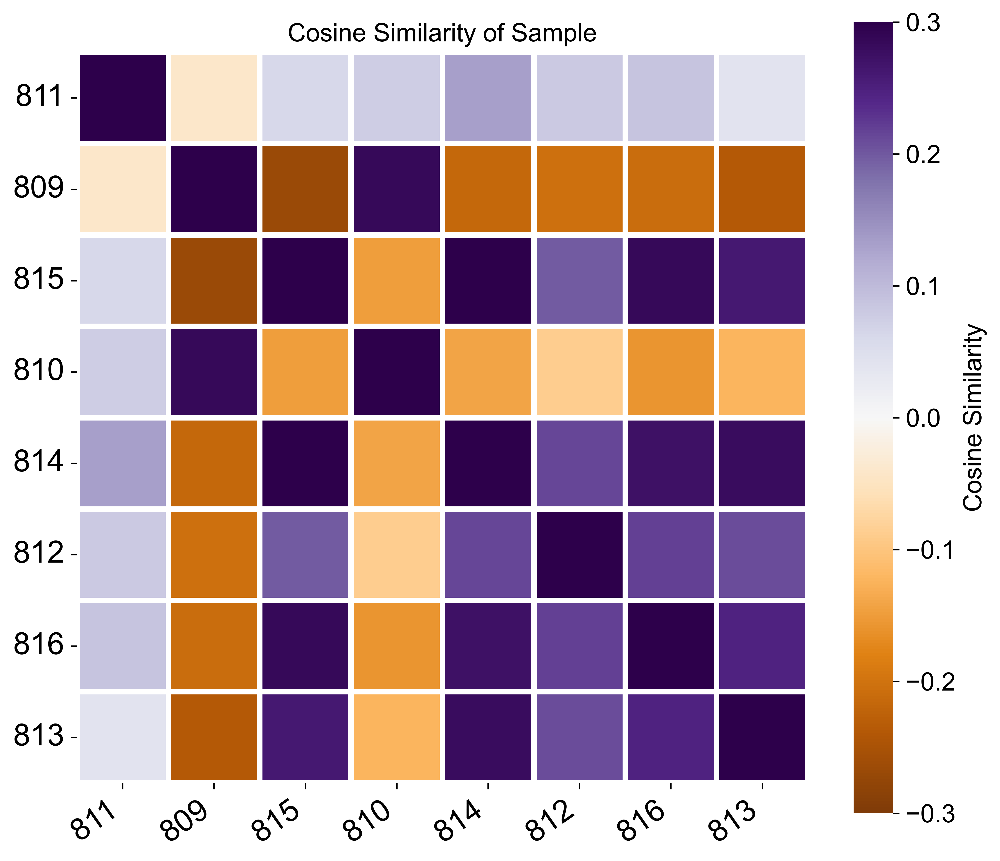

In [45]:
# heatmap plot for EDA
upper_triangle = np.triu(cosine_list, k=1) 
data = cosine_list
# Uncomment to get only the opper triangle
# data = np.triu(data)
data[data == 0] = np.nan 
plt.figure(figsize=(9, 8))

# get the max & min number
max_num = np.amax(upper_triangle)
min_num = np.amin(upper_triangle)

sns.heatmap(data, cmap='PuOr', vmin=-.3, vmax=0.3 , annot=False, fmt='.2f',
            square=True, cbar=True, cbar_kws={'label': 'Cosine Similarity'},
            linewidths=3, linecolor='white') 

# plt.title("Heatmap with Custom Colormap and Range")

# Remove spines (Seaborn doesn't always remove them cleanly)
plt.gca().spines['left'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.grid(False)
plt.title("Cosine Similarity of Sample")

fontsize = 17

plt.xticks(np.arange(0.5, len(sample_id_list) + 0.5, 1), [str(each)[-3:] for each in sample_id_list], rotation = 35, fontsize = fontsize, ha='right')
plt.yticks(np.arange(0.5, len(sample_id_list) + 0.5, 1), [str(each)[-3:] for each in sample_id_list], rotation = 0, fontsize = fontsize)


plt.show()

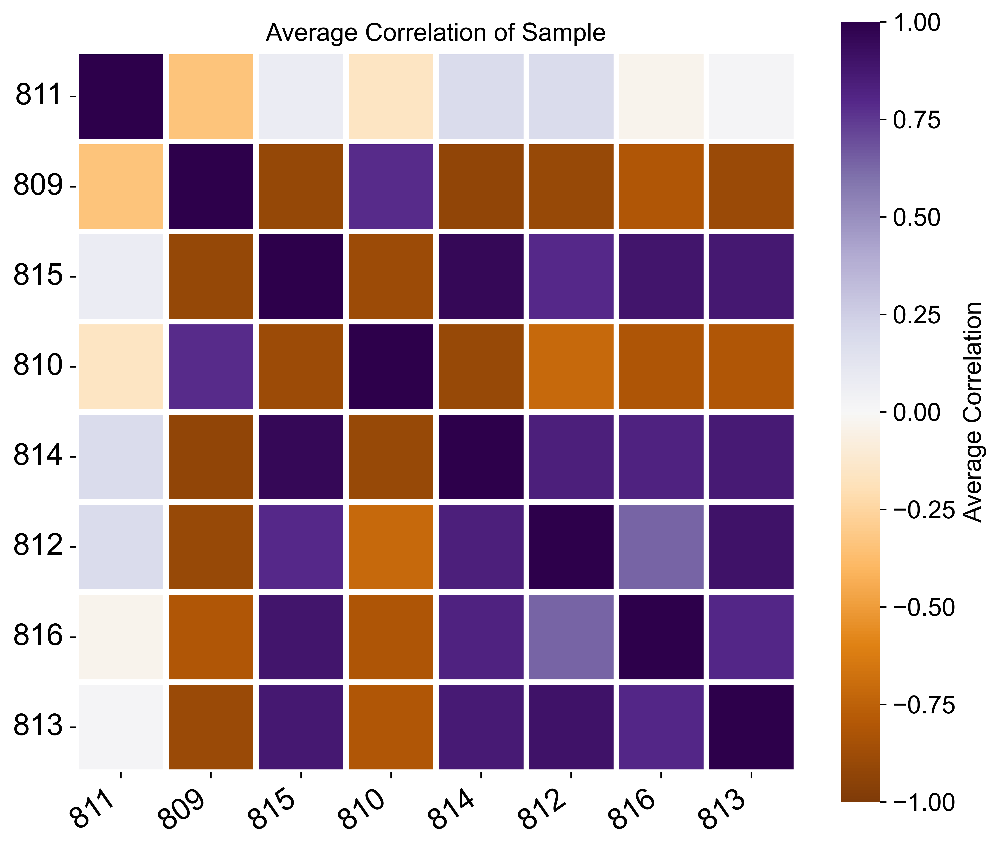

In [46]:
# heatmap plot for EDA
upper_triangle = np.triu(corr_list, k=1) 
data = corr_list
# Uncomment to get only the opper triangle
# data = np.triu(data)
data[data == 0] = np.nan 
plt.figure(figsize=(9, 8))

# get the max & min number
max_num = np.amax(upper_triangle)
min_num = np.amin(upper_triangle)

sns.heatmap(data, cmap='PuOr', vmin=-1, vmax=1 , annot=False, fmt='.2f',
            square=True, cbar=True, cbar_kws={'label': 'Average Correlation'},
            linewidths=3, linecolor='white') 

# plt.title("Heatmap with Custom Colormap and Range")

# Remove spines (Seaborn doesn't always remove them cleanly)
plt.gca().spines['left'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.grid(False)
plt.title("Average Correlation of Sample")

fontsize = 17

plt.xticks(np.arange(0.5, len(sample_id_list) + 0.5, 1), [str(each)[-3:] for each in sample_id_list], rotation = 35, fontsize = fontsize, ha='right')
plt.yticks(np.arange(0.5, len(sample_id_list) + 0.5, 1), [str(each)[-3:] for each in sample_id_list], rotation = 0, fontsize = fontsize)

plt.show()

## Finding the correlation between cell type within the control state

In [47]:
cell_type_list = sorted(list(adata.obs["Condition (Hour)"].unique()))

# store all array in dictionary data
cell_dict = {}

# iterate through each sample id
for each in cell_type_list:
    temp_array = adata[adata.obs["Condition (Hour)"].isin([each])].obsm["X_pca"]
    cell_dict[each] = temp_array

# compute for correlation
cell_corr_list = []
sample_size = len(cell_type_list)

# computing sample to sample similarity
for i in cell_type_list:
    for j in cell_type_list:
        cell_corr_list.append(get_mean_corr(cell_dict[i], cell_dict[j]))
        # print("done")

# reshape into sample by sample shape
cell_corr_list = np.array(cell_corr_list).reshape((sample_size, sample_size))

# check for the matrix
cell_corr_list

array([[ 1.   ,  0.788, -0.34 , -0.903, -0.898, -0.925, -0.908, -0.806],
       [ 0.788,  1.   , -0.162, -0.717, -0.809, -0.901, -0.885, -0.814],
       [-0.34 , -0.162,  1.   ,  0.183,  0.019,  0.183,  0.073, -0.036],
       [-0.903, -0.717,  0.183,  1.   ,  0.902,  0.837,  0.793,  0.638],
       [-0.898, -0.809,  0.019,  0.902,  1.   ,  0.863,  0.869,  0.802],
       [-0.925, -0.901,  0.183,  0.837,  0.863,  1.   ,  0.955,  0.822],
       [-0.908, -0.885,  0.073,  0.793,  0.869,  0.955,  1.   ,  0.884],
       [-0.806, -0.814, -0.036,  0.638,  0.802,  0.822,  0.884,  1.   ]])

In [48]:
import seaborn as sns

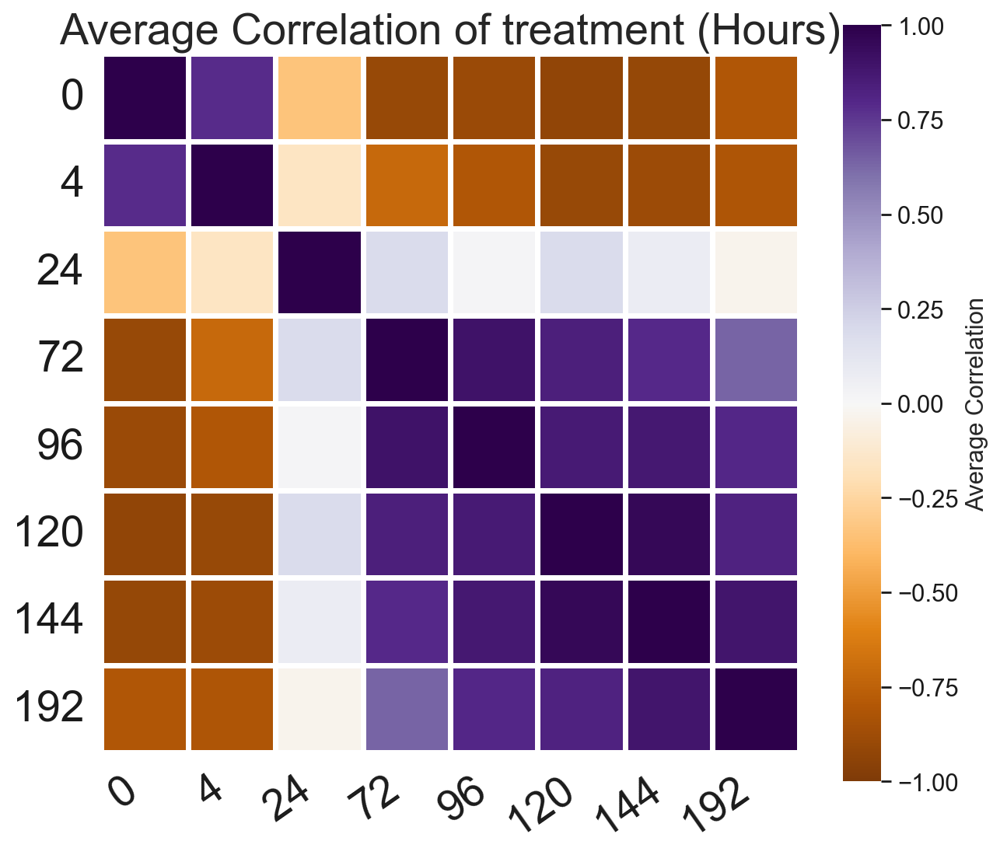

In [594]:
# heatmap plot for EDA
upper_triangle = np.triu(cell_corr_list, k=1) 
data = cell_corr_list
# Uncomment to get only the opper triangle
# data = np.triu(data)
data[data == 0] = np.nan 
plt.figure(figsize=(9, 8))

# get the max & min number
max_num = np.amax(upper_triangle)
min_num = np.amin(upper_triangle)

sns.heatmap(data, cmap='PuOr', vmin=-1, vmax=1 , annot=False, fmt='.1f',
            square=True, cbar=True, cbar_kws={'label': 'Average Correlation'},
            linewidths=3, linecolor='white') 
sns.set(font_scale=2)
# plt.title("Heatmap with Custom Colormap and Range")

# Remove spines (Seaborn doesn't always remove them cleanly)
plt.gca().spines['left'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.grid(False)
plt.title("Average Correlation of treatment (Hours)", fontsize = 25)

fontsize = 25

plt.xticks(np.arange(0.5, len(cell_type_list) + 0.5, 1), [str(each) for each in cell_type_list], rotation = 35, fontsize = fontsize, ha='right')
plt.yticks(np.arange(0.5, len(cell_type_list) + 0.5, 1), [str(each) for each in cell_type_list], rotation = 0, fontsize = fontsize)

plot_save_svg()

In [50]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)

sc.tl.umap(adata)

In [51]:
adata.obs["Condition (Hour)"] = adata.obs["Condition (Hour)"].astype('category')

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


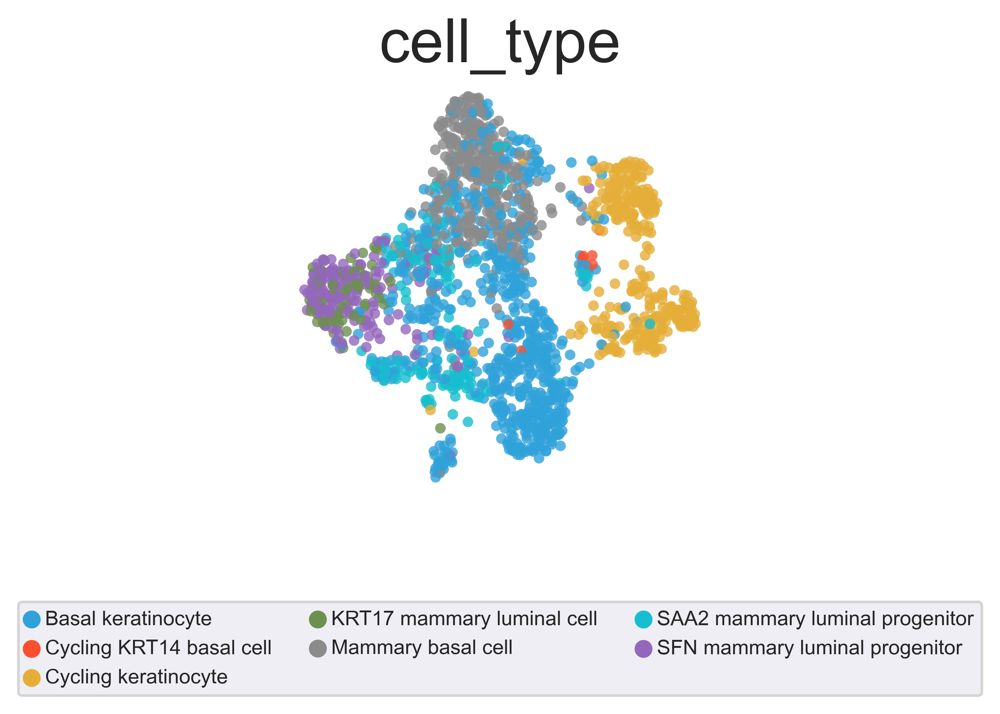

In [52]:
custom_palette = cc.glasbey_hv

setup_seed(8)
random_indices=np.random.permutation(list(range(adata.shape[0])))
sc.pl.umap(adata[random_indices, :], color=["cell_type"], alpha = 0.8, legend_fontsize = 9, return_fig = True,
           palette=custom_palette)

# plot_adata.obs['condition'] = plot_adata.obs['condition'].cat.reorder_categories(desired_order)

plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.5), fontsize = 8, ncol = 3)

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


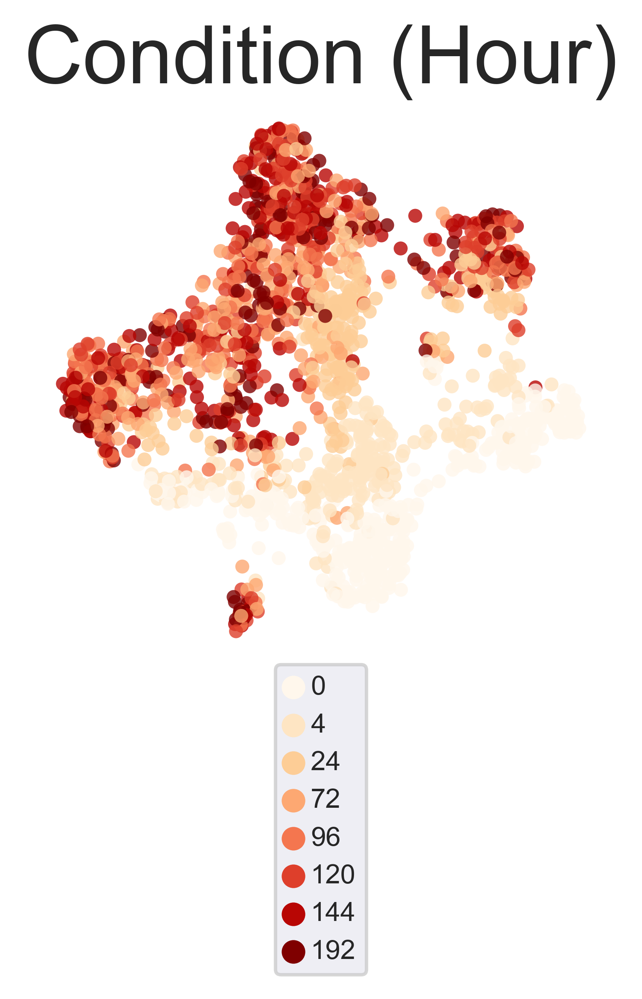

In [53]:
sc.pl.umap(adata[random_indices, :], color=["Condition (Hour)"], alpha = 0.8, legend_fontsize = 9, return_fig = True,
           palette="OrRd")

plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.6), fontsize = 8, ncol = 1)

plt.show()

In [54]:
# sc.pl.umap(adata[random_indices, :], color=["Age"], alpha = 0.8, legend_fontsize = 9, return_fig = False,
#            color_map="inferno")

In [55]:
# custom_palette = cc.glasbey_hv

# setup_seed(8)
# random_indices=np.random.permutation(list(range(adata.shape[0])))
# sc.pl.umap(adata[random_indices, :], color=["cell_type"], alpha = 0.8, legend_fontsize = 9, return_fig = True,
#            palette=custom_palette)

# # plot_adata.obs['condition'] = plot_adata.obs['condition'].cat.reorder_categories(desired_order)

# plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -2), fontsize = 8, ncol = 2)

In [56]:
count_dict

{0: 383, 144: 270, 96: 268, 24: 258, 192: 247, 120: 240, 4: 233, 72: 207}

In [57]:
# get the genes from the training data and then normalising it
# sc.pp.normalize_per_cell(adata_test, counts_per_cell_after=1e4)
# sc.pp.log1p(adata_test)
# adata_test = adata_test[:, adata.var.index].copy()

# 772 & 288 are the control

# adata_test = adata[adata.obs["GSM"].isin(["GSM3195770", "GSM3195772"])]
# adata =  adata[adata.obs["GSM"].isin(["GSM2836284", "GSM2836288", "GSM3195772"])]

In [58]:
adata_raw = adata.copy()

In [59]:
adata_raw

AnnData object with n_obs × n_vars = 1749 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [60]:
###### removed_cell = "NK cells"
age_threshold = 192

# using the difference one to be the testing set
adata_test = adata[np.array(adata.obs["Condition (Hour)"] == age_threshold)].copy()
adata_test

AnnData object with n_obs × n_vars = 166 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [61]:
# remove the data from the training data
adata = adata[~np.array(adata.obs["Condition (Hour)"] == age_threshold)].copy()
adata

AnnData object with n_obs × n_vars = 1583 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [62]:
setup_seed(8)
# held out a portion of control cells for making prediction in the evaluation phase
# condition 0 is the untreated
control_test = adata[np.array(adata.obs["Condition (Hour)"] == 0)]
# control_test = control_test[np.random.choice(control_test.shape[0], 1000, replace=False)]
control_test

View of AnnData object with n_obs × n_vars = 374 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [63]:
# creating a common PCA for all the model.
setup_seed(8)

# Create PCA object and fit it to the data
pca = PCA(n_components=50)
pca.fit(adata.X.toarray())

pca_matrix = pca.components_

# save the principle component
pd.DataFrame(pca.components_).to_csv("pca_component_3.csv", index = False)

In [64]:
# np.amax(adata_test.X.toarray())

In [65]:
pca_matrix

array([[ 6.89644253e-04,  1.55804339e-02,  1.52799118e-03, ...,
         3.40900687e-03,  4.13677818e-04, -4.61704832e-03],
       [ 3.25831881e-04, -7.76398858e-03,  3.34653483e-04, ...,
        -2.72575587e-02, -1.13603257e-03, -3.29534768e-03],
       [ 3.49634512e-04, -1.81690225e-03,  1.23857304e-05, ...,
        -8.56666777e-04, -1.77437159e-04,  1.07022461e-02],
       ...,
       [-9.85691432e-05, -2.31223506e-02, -1.59244806e-03, ...,
        -3.34154448e-02, -6.34534669e-03, -2.35901616e-03],
       [ 4.27511562e-03,  1.88516270e-02,  1.95506483e-03, ...,
        -2.45542664e-03, -1.47312165e-03,  5.72887169e-03],
       [ 3.33221884e-03,  5.34043042e-03, -2.03806831e-03, ...,
        -2.79608661e-02, -4.29055230e-03, -1.64850328e-04]])

In [66]:
# control_test.write_h5ad("normal_control_test.h5ad")

In [67]:
# # remove the testing sample from the training data
# train_index = []

# for each in adata.obs.index:
#     if each in control_test.obs.index:
#         train_index.append(False)
#     else:
#         train_index.append(True)

# # i.i.d
# adata = adata[np.array(train_index)].copy()

In [68]:
# adata.obs["batch"] = adata.obs["condition"]

# le = preprocessing.LabelEncoder()
# new_batch = le.fit_transform(adata.obs["batch"])
# adata.obs["batch"] = new_batch

# new_batch = [str(each) for each in new_batch]
# adata.obs["batch_num"] = new_batch

## Split the data into training and testing

In [69]:
# from sklearn.model_selection import train_test_split

# control_index = adata[(adata.obs.condition == "control")].obs.index
# train_index, test_index = train_test_split(control_index, test_size = 0.2 , random_state = 8)

# # filtering based on the boolean and subsetting the adata
# filter_test_idx = []

# for each in adata.obs.index:
#     if each in test_index:
#         filter_test_idx.append(True)
#     else:
#         filter_test_idx.append(False)
        
# filter_train_idx = [not each for each in filter_test_idx]

In [70]:
# adata_test = adata[filter_test_idx].copy()
# adata = adata[filter_train_idx].copy()

In [71]:
adata.layers["log_norm"] = adata.X.copy()

In [72]:
setup_seed(8)

In [73]:
import scanpy as sc
import pandas as pd
import seaborn as sns

# verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.verbosity = 1
sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')

# check the umap after normalisation

# compute pca and neighbor for calculating the ARI score
# sc.pp.pca(adata)
# sc.pp.neighbors(adata, n_neighbors=30)
# sc.tl.umap(adata)

# sc.pl.umap(adata, color=['sample_id', 'CellType'],
#            palette=sc.pl.palettes.vega_20_scanpy)

# revert based to unscale data
# adata.X = adata.layers["log_norm"]

In [74]:
# adata

In [75]:
sc.__version__

'1.9.3'

In [76]:
# adata.obs["batch_num"]

In [77]:
import colorcet as cc

In [78]:
custom_palette = cc.glasbey_category10

# sc.pl.umap(adata, color=['batch_num'], legend_loc = "none",
#            palette=custom_palette)

In [79]:
# adata.obs["age"]

In [80]:
# sc.pl.umap(adata, color=['sample_id'],
#            palette=custom_palette)

In [81]:
# sc.pl.umap(adata, color=['multiplets'],
#            palette=custom_palette)

In [82]:
# sc.pl.umap(adata, color=['condition'],
#            palette=custom_palette)

In [83]:
# sc.pl.umap(adata, color=['cell_type'],
#            palette=custom_palette)

In [84]:
# {'control': 2386,
#  'IFNGR1g3': 416,
#  'IFNGR1g2': 359,
#  'IFNGR1g1': 285,
#  'IFNGR1g4': 281}

In [85]:
# sc.pl.umap(adata, color='condition', groups=["IFNGR1g1", "IFNGR1g3"],
#            palette=custom_palette)

In [86]:
# sc.pl.umap(adata, color=['condition'], groups = ["IFNGR1", "control"],
#            palette=custom_palette)

In [87]:
# sc.pl.umap(adata, color=['condition'], groups = ["ETV7", "control"],
#            palette=custom_palette)

In [88]:
# sc.pl.umap(adata, color=['condition'], groups = ["CAV1", "control"],
#            palette=custom_palette)

In [89]:
# # Define the colorcet paletteasdasd
# custom_palette = cc.glasbey_category10

# ax = sc.pl.umap(adata, color='Method', palette=custom_palette,
#            frameon=False, legend_fontsize=3.5, show=False)

# # Set the plot title with the desired font size
# ax.set_title('Predicted Cell Type', fontsize=6)

# # Adjust the legend font size
# handles, labels = plt.gca().get_legend_handles_labels()

# # Adjust the size of the circles
# for handle in handles:
#     handle.set_sizes([12])
#     handle.set_edgecolor('black')
#     handle.set_linewidth(0.5)

# # Move the legend to the right side of the plot
# plt.legend(handles=handles, labels=labels, prop={'size': 5}, ncol = 1, 
#            loc='upper center', bbox_to_anchor=(0.5, -0.08))

# # Show the plot
# plt.show()

In [90]:
adata_test

AnnData object with n_obs × n_vars = 166 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [91]:
adata.obs["batch"] = adata.obs["Condition (Hour)"]

le = preprocessing.LabelEncoder()
new_batch = le.fit_transform(adata.obs["batch"])
adata.obs["batch"] = new_batch

new_batch = [str(each) for each in new_batch]
adata.obs["batch_num"] = new_batch
adata.obs["batch"]

V19_T2     2
V20_T2     2
V22_T2     2
V24_T2     2
V25_T2     2
          ..
V264_T4    4
V265_T4    4
V266_T4    4
V267_T4    4
V268_T4    4
Name: batch, Length: 1583, dtype: int64

In [92]:
from sklearn.preprocessing import OneHotEncoder

# le = preprocessing.LabelEncoder()
# enc_batch = OneHotEncoder(handle_unknown='ignore')
# enc_group = OneHotEncoder(handle_unknown='ignore')

# label_str = "batch"
# group_str = "cell_type"

# enc_batch.fit(adata.obs[label_str].to_numpy().reshape(-1, 1))
# enc_group.fit(adata.obs[group_str].to_numpy().reshape(-1, 1))

In [93]:
# le2 = preprocessing.LabelEncoder()
# new_batch = le2.fit_transform(adata.obs["cell_type"])
# adata.obs["cell_type"] = new_batch

# new_batch = [str(each) for each in new_batch]
# adata.obs["cell_type_num"] = new_batch
# adata.obs["cell_type"]

In [94]:
# adding the scaling so that the model can learn effectively
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaler.fit(adata.X.toarray())

MinMaxScaler()

In [95]:
label_str = "Condition (Hour)"
group_str = "cell_type"

In [96]:
########## CLASS SINGLE CELL DATASET ##########
class ScDataset(Dataset):
    def __init__(self, adata):
        self.variable = None
        self.labels = adata.obs[label_str].to_numpy()
        self.org_batch = adata.obs["batch"].to_numpy()
        # self.groups = adata.obs[group_str].to_numpy()
        # self.one_hot_groups = enc_group.transform(adata.obs[group_str].values.reshape(-1, 1)).toarray()
        self.scaler = scaler
        try:
            self.X = adata.X.toarray()
#             self.hvg_X = adata[:, adata.var['highly_variable']].X.copy().toarray()
        except:
            self.X = adata.X
        
        self.min_val = np.amin(adata.X)
        self.max_val = np.amax(adata.X)
#         self.groups = adata.obs[group_str].to_numpy()
        self.transform = None
        self.sample = None
        self.adata = adata
        self.X_scaled = scaler.transform(self.X)
#         self.random_target = np.eye(c_dim)[np.random.choice(c_dim, len(self.labels))]
        
#             self.hvg_X = adata[:, adata.var['highly_variable']].X.copy()

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, index):
#         random_index = random.randint(0, self.X.shape[0] - 1)

        return self.X[index], self.labels[index]

### pre processing step for normalise and scale the for each individual batch

In [97]:
# # apply the pre processing onto the anndata
# # first create layer for the anndata

adata.layers["X_raw"] = adata.layers["log_norm"]

In [98]:
adata.X

<1583x2000 sparse matrix of type '<class 'numpy.float64'>'
	with 682639 stored elements in Compressed Sparse Row format>

## compute ARI score for each batch

In [99]:
# # split per batch into new objects.
# batches = list(set(adata.obs[label_str]))
# alldata = {}
# for batch in batches:
#     alldata[batch] = adata[adata.obs[label_str] == batch,]
    
# # subset only the batches with good ARI score
# subset_batches = []

# # max_ari = 0
    
# for each in batches:
#     print("batch: %s" % each)
#     ari_score = compute_ari(alldata[each])
#     print(ari_score)
#     if ari_score > 0.50:
#         subset_batches.append(each)
        
# #     if ari_score > max_ari:
# #         max_ari = ari_score
# #         batch_anchor = each
        

# # then subset the adata for training the model
# # save the test dataset first
# adata = adata.copy()
# adata_temp = adata[adata.obs["batch"].isin(subset_batches)].copy()

In [100]:
# try try using the normalised data as the input

# adata.X = adata.layers["X_norm"].copy()

In [101]:
# adata.X = adata.X.toarray().copy()

## Normalise the sequencing depth which is the library size

The the batch effect removal starting from removing the library size and then remove the actual batch effect from the technical different.

**Previous issue**: we select one batch as the anchor which become and issue when that batch does not seperate cell type well enough as compare to other batch. Hence, we now change to batch free without selecting any anchored batch. 

In [102]:
# import scanpy as sc
# import pandas as pd
# import seaborn as sns

# # verbosity: errors (0), warnings (1), info (2), hints (3)
# sc.settings.verbosity = 1
# sc.settings.set_figure_params(
#     dpi=150, frameon=False, figsize=(3, 3), facecolor='white')

# # adata.X = adata.layers["X_scaled"].copy()
# # check the umap after normalisation

# sc.pp.pca(adata)
# sc.pp.neighbors(adata)
# sc.tl.umap(adata)

# sc.pl.umap(adata, color=['batch', 'celltype'],
#            palette=sc.pl.palettes.vega_20_scanpy)

In [103]:
max_val = np.amax(adata.X)
min_val = np.amin(adata.X)

print("Upper bound of the gene expression: ", max_val)
print("Lower bound of the gene expression: ", min_val)

Upper bound of the gene expression:  7.822028518148617
Lower bound of the gene expression:  0.0


In [104]:
def calculate_div_gp(prob_real_data, prob_fake_data, real_data, fake_data, k=2, p=2):
# #     real_data = Variable(real_data, requires_grad=True)
#     prob_real_data, _, = D(real_data)

    real_grad_outputs = torch.ones(prob_real_data.size()).cuda() if cuda else torch.ones(prob_real_data.size())

    fake_data.requires_grad_(True)
#     prob_fake_data, _, = D(fake_data)

    fake_grad_outputs = torch.ones(prob_fake_data.size()).cuda() if cuda else torch.ones(prob_fake_data.size())

    real_gradient = torch.autograd.grad(
        outputs=prob_real_data,
        inputs=real_data,
        grad_outputs=real_grad_outputs,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    
    fake_gradient = torch.autograd.grad(
        outputs=prob_fake_data,
        inputs=fake_data,
        grad_outputs=fake_grad_outputs,
        create_graph=True,
        retain_graph=True,
        only_inputs=True, 
    )[0]

    real_gradient_norm = real_gradient.view(real_gradient.size(0), -1).pow(2).sum(1) ** (p / 2)
    fake_gradient_norm = fake_gradient.view(fake_gradient.size(0), -1).pow(2).sum(1) ** (p / 2)

    gradient_penalty = torch.mean(real_gradient_norm + fake_gradient_norm) * k / 2
     
    return gradient_penalty 

In [105]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Linear") != -1:
        torch.nn.init.kaiming_normal_(m.weight.data, 0.2)
    elif classname.find("BatchNorm") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

# def weights_init_normal(m):
#     classname = m.__class__.__name__
#     if classname.find("Conv") != -1:
#         torch.nn.init.normal_(m.weight, 0.0, 0.02)
#     elif classname.find("BatchNorm") != -1:
#         torch.nn.init.normal_(m.weight, 1.0, 0.02)
#         torch.nn.init.zeros_(m.bias)

In [106]:
class AFF(nn.Module):
    def __init__(self, dim):
        super(AFF, self).__init__()

        # attentional feature fusion layer
        self.sigmoid = nn.Sigmoid()

        self.attention = nn.Sequential(
            nn.Linear(dim, dim),
            nn.BatchNorm1d(dim),
            nn.ReLU(inplace=True),
            nn.Linear(dim, dim),
           # nn.BatchNorm1d(dim),
        )
        
    def forward(self, latent_data, style_latent):
        # fusion layer before decoder
        xa = latent_data + style_latent
        xl = self.attention(xa)
        wei = self.sigmoid(xl)

        data = latent_data * wei + style_latent * ((1 - wei))
        return data

In [107]:
def combine(a, b):
    return torch.cat((a, b), -1)

In [108]:
class TrainableWeightedSum(nn.Module):
    def __init__(self):
        super(TrainableWeightedSum, self).__init__()
        self.weights = nn.Parameter(torch.Tensor(2))  # Create learnable weights
        self.reset_parameters()

    def reset_parameters(self):
        nn.init.uniform_(self.weights)  # Initialize weights with uniform distribution

    def forward(self, tensor1, tensor2):
        # Apply element-wise multiplication to the input tensors
        weighted_tensor1 = torch.mul(tensor1, self.weights[0])
        weighted_tensor2 = torch.mul(tensor2, self.weights[1])

        # Sum the weighted tensors
        fused_tensor = torch.add(weighted_tensor1, weighted_tensor2)

        return fused_tensor

class LinearAttention(nn.Module):
    def __init__(self, in_features, out_features, bias = True):
        super(LinearAttention, self).__init__()
        
        self.feed_forward  = nn.Sequential(
            nn.Linear(in_features, in_features, bias),
            nn.ReLU(),
            nn.Linear(in_features, in_features, bias),
            nn.Dropout(0.1),
        )
        
        self.gamma = nn.Parameter(torch.zeros(1))  # Create learnable weights
        
        self.atten = GeneExpressionAttention(in_features, in_features, bias)
#         self.weighted_sum = TrainableWeightedSum()
#         self.weighted_sum.cuda()

        self.norm1 = nn.BatchNorm1d(in_features)
        self.norm2 = nn.BatchNorm1d(out_features)
        
        # Dropout
        self.dropout = nn.Dropout(0.1)
        
        # output layer
        
        self.out = nn.Linear(in_features, out_features, bias)

    def forward(self, x):
        atten_out = self.norm1(self.dropout(self.gamma * self.atten(x)) + x)
#         atten_out_2 = self.atten2(x)
        out = self.feed_forward(atten_out)
        out = atten_out + self.dropout(out)
        out = self.norm2(out)
        return self.out(out)

In [109]:
from utils.sophia import SophiaG
from utils.acprop import ACProp
# from pytorch_optimizer import *
from adabelief_pytorch import AdaBelief
from pytorch_optimizer import clip_grad_norm

In [110]:
# scaled_X, min_val, max_val = minmax_scale(adata.X)

In [111]:
# adata.X = scaled_X

In [112]:
initial_dropout_rate = 0.8
final_dropout_rate = 0.25
stabilization_epochs = 200
dropout_anneal_epochs = 500 - stabilization_epochs
dropout_decay = (initial_dropout_rate - final_dropout_rate) / dropout_anneal_epochs

# Function to anneal the dropout rate
def anneal_dropout_rate(epoch):
    if epoch < stabilization_epochs:
        return initial_dropout_rate
    else:
        return max(initial_dropout_rate - dropout_decay * (epoch - stabilization_epochs), final_dropout_rate)

In [113]:
from torch.nn.utils.parametrizations import orthogonal

In [114]:
def wasserstein1d(x, y):
    x1, _ = torch.sort(x, dim=0)
    y1, _ = torch.sort(y, dim=0)
    z = (x1-y1).view(-1)
    n = x.size(0)
    return torch.dot(z, z)/n

In [115]:
def normalize_gradient(net_D, x, **kwargs):
    """
                     f
    f_hat = --------------------
            || grad_f || + | f |
    """
    x.requires_grad_(True)
    f, c = net_D(x, **kwargs)
    grad = torch.autograd.grad(
        f, [x], torch.ones_like(f), create_graph=True, retain_graph=True)[0]
    grad_norm = torch.norm(torch.flatten(grad, start_dim=1), p=2, dim=1)
    grad_norm = grad_norm.view(-1, *[1 for _ in range(len(f.shape) - 1)])
    f_hat = (f / (grad_norm + torch.abs(f)))
    return f_hat, c

In [116]:
from dog import DoG, LDoG
from dog import PolynomialDecayAverager

In [117]:
def generate_one_hot_vectors(batch_size, num_classes):
    """
    Generates a batch of random one-hot encoded vectors.

    Args:
    batch_size (int): The number of samples in the batch.
    num_classes (int): The number of classes.

    Returns:
    one_hot_vectors (np.ndarray): A NumPy array of shape (batch_size, num_classes)
      containing the one-hot encoded vectors.
    """

    # Generate random integers between 0 and num_classes-1
    random_classes = np.random.randint(0, num_classes, size=(batch_size,))

    # Create a zero-filled array of the desired shape
    one_hot_vectors = np.zeros((batch_size, num_classes))

    # Set the element corresponding to the random class to 1 for each sample
    one_hot_vectors[np.arange(batch_size), random_classes] = 1

    return one_hot_vectors

In [118]:
def generate_random_one_hot(input_vectors):
    """Generates random one-hot encoded vectors with different indices than the input.

    Args:
    input_vectors: A torch tensor of one-hot encoded vectors with shape (batch_size, num_classes).

    Returns:
    A torch tensor of random one-hot encoded vectors with shape (batch_size, num_classes).
    """

    batch_size, num_classes = input_vectors.shape
    output_vectors = torch.zeros_like(input_vectors)

    for i in range(batch_size):
        # Get a list of valid indices (not equal to the input's index)
        valid_indices = torch.where(input_vectors[i] == 0)[0].tolist()

        # Randomly choose an index from the valid indices
        random_index = torch.tensor(random.choice(valid_indices), dtype=torch.long)

        # Set the chosen index to 1 in the output vector
        output_vectors[i, random_index] = 1

    return output_vectors

In [119]:
def generate_random_values(batch_size, value_list):
  """Generates random values from a predefined value list based on batch size.

  Args:
    batch_size: The number of random values to generate.
    value_list: A list of values to choose from.

  Returns:
    A list of random values chosen from the value_list.
  """

  return random.choices(value_list, k = batch_size)

# Example usage
my_predefined_list = list(adata.obs["Condition (Hour)"].unique())
print(my_predefined_list)
batch_size = 100
random_values = generate_random_values(batch_size, my_predefined_list)
print(f"Generated {batch_size} random values:", random_values)

[24, 0, 144, 4, 120, 72, 96]
Generated 100 random values: [0, 96, 24, 120, 24, 0, 96, 0, 120, 4, 4, 4, 0, 72, 24, 0, 24, 0, 144, 96, 144, 24, 0, 96, 24, 120, 144, 120, 144, 120, 4, 120, 96, 120, 24, 24, 96, 4, 0, 96, 120, 72, 96, 0, 144, 96, 24, 72, 24, 120, 120, 96, 72, 4, 0, 0, 4, 4, 24, 96, 4, 120, 0, 0, 24, 144, 0, 144, 144, 72, 96, 0, 144, 0, 120, 96, 0, 72, 144, 24, 72, 144, 0, 4, 0, 144, 4, 144, 120, 144, 24, 24, 24, 4, 144, 72, 4, 120, 96, 24]


In [120]:
def focal_binary_cross_entropy(logits, targets, gamma=2):
    l = logits.reshape(-1)
    t = targets.reshape(-1)
    p = torch.sigmoid(l)
    p = torch.where(t >= 0.5, p, 1-p)
    logp = - torch.log(torch.clamp(p, 1e-4, 1-1e-4))
    loss = logp*((1-p)**gamma)
    loss = targets.shape[1]*loss.mean()
    return loss

def sattolo_shuffle(arr):
    input_arr = arr.copy()
    for i in range(len(arr) - 1):
        j = random.randrange(i + 1, len(arr))  # Exclude i itself
        arr[i], arr[j] = arr[j], arr[i]
        
    return arr

def generate_sampling_num(arr):
    shuffled = sattolo_shuffle(arr.copy())

    bool_index = (shuffled == arr)
    # iteratively resampling to get only the get unique element
    while sum(bool_index) != 0:
        shuffled[bool_index] = sattolo_shuffle(shuffled.copy())[:sum(bool_index)]
        bool_index = (shuffled == arr)
    return shuffled

original_array = np.array([3, 2, 3, 3, 3] * 5000)
shuffled_array = generate_sampling_num(original_array.copy())  # Make a copy
print(shuffled_array) 
# shuffle_no_fixed_points_optimized(np.array([1,2,3,4, 4] * 50))

[2 3 2 ... 2 2 2]


In [121]:
def corr_loss(vx, vy):
    """Trying out correlation loss as the cost function to optimise the model"""
    cost = vx * vy * torch.rsqrt(torch.sum(vx ** 2)) * torch.rsqrt(torch.sum(vy ** 2))
    return cost.mean()

In [122]:
def focal_binary_cross_entropy(logits, targets, gamma=2):
    l = logits.reshape(-1)
    t = targets.reshape(-1)
    p = torch.sigmoid(l)
    p = torch.where(t >= 0.5, p, 1-p)
    logp = - torch.log(torch.clamp(p, 1e-4, 1-1e-4))
    loss = logp*((1-p)**gamma)
    loss = targets.shape[1]*loss.mean()
    return loss

In [123]:
def multi_attention(q, k, v, attn_mask=None, dropout=0.0, n_heads = 4):
    """
    Computes scaled dot product attention over three tensors.
    
    Args:
        q (torch.Tensor): Query tensor of shape (batch_size, num_heads, seq_len, d_k).
        k (torch.Tensor): Key tensor of shape (batch_size, num_heads, seq_len, d_k).
        v (torch.Tensor): Value tensor of shape (batch_size, num_heads, seq_len, d_v).
        attn_mask (torch.Tensor, optional): Attention mask of shape (batch_size, num_heads, seq_len, seq_len).
        dropout (float, optional): Dropout probability.

    Returns:
        torch.Tensor: Output tensor of shape (batch_size, num_heads, seq_len, d_v).
    """

    batch_size, n_heads, seq_len, d_k = q.size()
#     attn = torch.bmm(q, k.transpose(1, 3))
    attn = q @ k.transpose(-2, -1)
    attn = attn / math.sqrt(d_k)
    
    if attn_mask is not None:
        attn = attn.masked_fill(attn_mask, float('-inf'))
        
    # before or after who know    
    attn = torch.nn.functional.dropout(attn, p=dropout)
    attn = torch.softmax(attn, dim=-1)
    
    output = attn @ v
    output = output.view(-1, seq_len * n_heads)    
    return output

class GeneExpressionAttention(nn.Module):
    def __init__(self, n_features, d_k, bias=True, bias_kv = False, n_heads=4):
        super(GeneExpressionAttention, self).__init__()
        self.d_k = d_k // n_heads
        self.bias = bias
        self.bias_kv = bias_kv
        self.n_heads = n_heads

        # Query representation
        self.W_Q = nn.Linear(n_features, self.d_k * n_heads, bias = self.bias)

        # Key and value pair to attend to
        self.W_K = nn.Linear(n_features, self.d_k * n_heads, bias = self.bias_kv)
        self.W_V = nn.Linear(n_features, self.d_k * n_heads, bias = self.bias_kv)

        # self.out = nn.Linear(d_k, d_k)

        # add non linearity to the attention
        # self.nonlin = nn.GELU()

    def forward(self, tabular_data):
        batch_size = tabular_data.shape[0]
        
        # Project tabular data into Q, K, and V matrices
        Q = self.W_Q(tabular_data)
        K = self.W_K(tabular_data)
        V = self.W_V(tabular_data)

        # Split Q, K, and V into n_heads and also include the seq_length
        Q = Q.view(batch_size, self.n_heads, self.d_k, 1)
        K = K.view(batch_size, self.n_heads, self.d_k, 1)
        V = V.view(batch_size, self.n_heads, self.d_k, 1)

        # Apply multi-head attention
        out = multi_attention(Q, K, V, None, 0.0, self.n_heads)
        # out = self.out(out)
        # out = self.nonlin(out)

        return out

In [124]:
def penalty_normalize_gradient(f, x):
    """
                          1 - f
    f_hat = -------------------------------
               ||1 - grad_f ||+ |1 - f|
    """
    x.requires_grad_(True)
    # f = net_D(x, **kwargs)
    grad = torch.autograd.grad(
        f, [x], torch.ones_like(f), create_graph=True, retain_graph=True)[0]
    grad_norm = torch.norm(torch.flatten(1 - grad, start_dim=1), p=2, dim=1)
    grad_norm = grad_norm.view(-1, *[1 for _ in range(len(f.shape) - 1)])
    f_hat = ((1 - f) / (grad_norm + torch.abs(1 - f)))
    return f_hat

In [125]:
def fused_leaky_relu(input, bias, negative_slope=0.2, scale=2 ** 0.5):
    return F.leaky_relu(input + bias, negative_slope) * scale


class FusedLeakyReLU(nn.Module):
    def __init__(self, channel = 1, negative_slope=0.2, scale=2 ** 0.5):
        super().__init__()
        self.bias = nn.Parameter(torch.zeros(1, 1))
        self.negative_slope = negative_slope
        self.scale = scale

    def forward(self, input):
        # print("FusedLeakyReLU: ", input.abs().mean())
        out = fused_leaky_relu(input, self.bias,
                               self.negative_slope,
                               self.scale)
        # print("FusedLeakyReLU: ", out.abs().mean())
        return out

class WSLinear(nn.Module):
    def __init__(
        self, in_features, out_features,
    ):
        super(WSLinear, self).__init__()
        self.linear = nn.Linear(in_features, out_features)
        self.scale = (2 / in_features)**0.5
        self.bias = self.linear.bias
        self.linear.bias = None

        # initialize linear layer
        nn.init.normal_(self.linear.weight)
        nn.init.zeros_(self.bias)

    def forward(self, x):
        return self.linear(x * self.scale) + self.bias

class AdaLayer(nn.Module):
    def __init__(self, n_features, w_dim):
        super().__init__()
        self.instance_norm = nn.LayerNorm(n_features)
        self.style_scale = WSLinear(w_dim, n_features)
        self.style_bias = WSLinear(w_dim, n_features)

    def forward(self, x, w):
        x = self.instance_norm(x)
        style_scale = self.style_scale(w)
        style_bias = self.style_bias(w)
        return style_scale * x + style_bias

class MappingNetwork(nn.Module):
    def __init__(self, z_dim, w_dim):
        super().__init__()
        self.mapping = nn.Sequential(
            PixelNorm(),
            WSLinear(z_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
        )

    def forward(self, x):
        return self.mapping(x)

class PixelNorm(nn.Module):
    def __init__(self):
        super(PixelNorm, self).__init__()
        self.epsilon = 1e-8

    def forward(self, x):
        return x / torch.sqrt(torch.mean(x ** 2, dim=1, keepdim=True) + self.epsilon)

class InjectNoise(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.weight = nn.Parameter(torch.zeros(1, channels))

    def forward(self, x):
        noise = torch.randn((x.shape[0], 1), device=x.device)

        # print(self.weight.shape)
        # print(noise.shape)
        return x + self.weight * noise

# Define FiLM layer
class FiLM(nn.Module):
    def __init__(self, feature_dim, condition_dim):
        super(FiLM, self).__init__()
        self.gamma_fc = nn.Linear(condition_dim, feature_dim)
        self.beta_fc = nn.Linear(condition_dim, feature_dim)
        
    def forward(self, x, condition):
        gamma = self.gamma_fc(condition)
        beta = self.beta_fc(condition)
        return gamma * x + beta

In [126]:
import time

def train(scd, n_epochs):
#     n_epochs = n_epochss
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    data_size = scd.X.shape[1]
    lr = 0.0002
    b1 = 0.5
    b2 = 0.999
    latent_dim = 256
#     style_dim = latent_dim
    embedding_dim = 1
    n_dim = 1024
#     proj_dim = 2000
    n_critic = 10
    global c_dim, ctype_dim
    global nn_emb
    c_dim = 1
    # g_dim = len(list(set(adata.obs[group_str])))
    
    # early stopping function
    trigger_times = 0
    best_loss = 100.0
    
    # condition for when we don't have anything to preserve
    con_dim = c_dim
    
    act_func = nn.ReLU(inplace = True)

    # Define FiLM layer
    class FiLM(nn.Module):
        def __init__(self, feature_dim, condition_dim):
            super(FiLM, self).__init__()
            self.gamma_fc = nn.Linear(condition_dim, feature_dim)
            self.beta_fc = nn.Linear(condition_dim, feature_dim)
            
        def forward(self, x, condition):
            gamma = self.gamma_fc(condition)
            beta = self.beta_fc(condition)
            return gamma * x + beta

    # residual block
    class ResidualBlock(nn.Module):
        def __init__(self, in_features):
            super(ResidualBlock, self).__init__()
            self.block = nn.Sequential(
                nn.Linear(in_features, in_features),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Linear(in_features, in_features),
                nn.LeakyReLU(0.2, inplace=True)
            )
    
        def forward(self, x):
            return x + self.block(x)

    class Generator(nn.Module):
        def __init__(self, dropout_rate = 0.2):
            super(Generator, self).__init__()
            self.relu = nn.ReLU(inplace = True)
            self.dropout_rate = dropout_rate

            self.input_atten_layer = nn.Sequential(
                GeneExpressionAttention(data_size, data_size, n_heads = 4, bias = False),
                # nn.BatchNorm1d(data_size),
                FusedLeakyReLU(0.2),
            )

            # FILM
            self.film1 = FiLM(data_size, embedding_dim)
            
            # encoder for the gene expression
            self.encoder = nn.Sequential(
#                     self.proj, # adding projection layer
                # attention layer to focus on the important in data and it shall be lower than the input layer
                nn.Linear(data_size, n_dim),
                # nn.BatchNorm1d(n_dim),
                nn.Dropout(self.dropout_rate),
                FusedLeakyReLU(0.2),
                nn.Linear(n_dim, n_dim // 2),
                # nn.BatchNorm1d(n_dim // 2),
                # nn.Dropout(self.dropout_rate),
                FusedLeakyReLU(0.2),
                
                nn.Linear(n_dim // 2, latent_dim),
            )
            
            # create a share decoder
            self.decoder = nn.Sequential(
                nn.Linear(latent_dim, n_dim // 2),
                # nn.BatchNorm1d(n_dim // 2),
                # nn.Dropout(self.dropout_rate),
                FusedLeakyReLU(0.2),
                nn.Linear(n_dim // 2, n_dim),
                # nn.BatchNorm1d(n_dim),
                nn.Dropout(self.dropout_rate),
                FusedLeakyReLU(0.2),
                nn.Linear(n_dim, data_size),
            )

            self.decoder_beta = nn.Sequential(
                nn.Linear(latent_dim, n_dim // 2),
                # nn.BatchNorm1d(n_dim // 2),
                # nn.Dropout(self.dropout_rate),
                FusedLeakyReLU(0.2),
                nn.Linear(n_dim // 2, n_dim),
                # nn.BatchNorm1d(n_dim),
                nn.Dropout(self.dropout_rate),
                FusedLeakyReLU(0.2),
                nn.Linear(n_dim, data_size),
            )
            
            
        def forward(self, x, c, test = False):

            c = torch.log(c + 1)

            batch_size = x.shape[0]
            # when the model is trained, we discard the c label
            # if test == True:
            #     # zero out to remove this attribute from the model
            #     c_embeddings = torch.zeros(batch_size, embedding_dim, device = x.device)
            # else:
            #     c_embeddings = self.embedding_layer_c(c)
            
#             g_embeddings = self.embedding_layer_g(g)
            # data = torch.cat((x, self.norm_out(c_embeddings)), -1)
            atten_input = (self.input_atten_layer(x) + x)/2

            # data = torch.cat((atten_input,c_embeddings), -1)

            # film 1
            data = self.film1(atten_input, c)
        
            # content network
            latent_data = self.encoder(data)
#             latent_data = self.resnet(latent_data)
            corrected_gamma = self.decoder(latent_data)
            corrected_beta = self.decoder_beta(latent_data)
            
            return corrected_gamma, corrected_beta

    class residual_layer_linear(nn.Module):
        def __init__(self, input_dim, out_dim, n_heads):
            super(residual_layer_linear, self).__init__()
            # residual connection to the model
            self.embedding_layer = nn.Sequential(
                nn.LayerNorm(input_dim),
                GeneExpressionAttention(input_dim, out_dim, n_heads = n_heads),
                nn.LayerNorm(out_dim),
                nn.LeakyReLU(0.2, inplace = True),
            )

            # adding projection layer
            self.proj = nn.Linear(input_dim, out_dim)

        def forward(self, data):
            residual = self.proj(data)
            x = self.embedding_layer(data)
            return F.leaky_relu(x + residual, 0.2)
    
    class Discriminator(nn.Module):
        def __init__(self, dropout_rate = 0.2):
            super(Discriminator, self).__init__()
            
            self.dropout_rate = dropout_rate

            self.input_atten = nn.Sequential(
                GeneExpressionAttention(data_size, data_size, n_heads = 4, bias = False),
                # residual_layer(n_dim, n_dim, n_heads = 128),
                # nn.BatchNorm1d(data_size),
                FusedLeakyReLU(.2),
            )

            # FILM
            self.film1 = FiLM(data_size, embedding_dim)

            # self.embedding_layer_c = nn.Sequential(
            #         nn.Linear(c_dim, embedding_dim, bias = False),
            #     )
            
            # self.norm_out = nn.BatchNorm1d(embedding_dim)
            
            self.model = nn.Sequential(
                # nn.Dropout(self.dropout_rate),
                nn.Linear(data_size, n_dim),
                # InjectNoise(n_dim),
                # nn.BatchNorm1d(n_dim),
                nn.Dropout(self.dropout_rate),
                FusedLeakyReLU(0.2),
                nn.Linear(n_dim, n_dim // 2),
                # InjectNoise(n_dim // 2),
                # nn.BatchNorm1d(n_dim // 2),
                FusedLeakyReLU(0.2),
                nn.Linear(n_dim // 2, latent_dim),
                # nn.BatchNorm1d(latent_dim),
                FusedLeakyReLU(0.2),
            )
            
            self.adv_layer = nn.Linear(latent_dim, 1)
            

        def forward(self, data, c):
            c = torch.log(c + 1)
            data = (self.input_atten(data) + data) / 2
            data = self.film1(data, c)
            # data = torch.cat((data, c), -1)
            out = self.model(data)
            # validity = [adv(out) for adv in self.adv_layer]
            validity =  self.adv_layer(out)
    
            return validity

    def gradient_penalty(discriminator, real_data, fake_data, labels):
        batch_size = real_data.size(0)
        epsilon = torch.rand(batch_size, 1).to(device_ids[0])
        epsilon = epsilon.expand_as(real_data)
        interpolated = epsilon * real_data + (1 - epsilon) * fake_data
        interpolated = interpolated.to(device_ids[0])
        interpolated.requires_grad_(True)
        prob_interpolated = discriminator(interpolated, labels)
        
        gradients = torch.autograd.grad(
            outputs=prob_interpolated,
            inputs=interpolated,
            grad_outputs=torch.ones(prob_interpolated.size()).to(device_ids[0]),
            create_graph=True,
            retain_graph=True,
        )[0]
        gradients = gradients.view(batch_size, -1)
        gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
        return gradient_penalty
                
    ### End of define model        

    # Initialize generator and discriminator
    G_AB = Generator()
    D_B = Discriminator()

    global device_ids

    device_ids = [0, 3]

    G_AB = nn.DataParallel(G_AB, device_ids = device_ids)
    D_B = nn.DataParallel(D_B, device_ids = device_ids)

    G_AB.to(device_ids[0])
    D_B.to(device_ids[0])
    
    # nn_emb = NN_embed()
#     D_latent = Discriminator_latent()
    
    target = [int(x) for x in scd.org_batch]
    
    class_sample_count = np.array(
        [len(np.where(target == t)[0]) for t in np.unique(target)])
    weight = 1. / class_sample_count

    samples_weight = np.array([weight[t] for t in target])

    samples_weight = torch.from_numpy(samples_weight)
    samples_weight = samples_weight.double()
    sampler = WeightedRandomSampler(samples_weight, 512 * 3)

    dataloader = DataLoader(
        dataset = scd,
        batch_size=512,
        shuffle=False, drop_last = False, num_workers=5, sampler = sampler,
    )
    
#     def criterion_cycle(x_reconst, x_real):
#         return torch.mean(torch.abs(x_real - x_reconst))
    
    criterion_cycle = nn.SmoothL1Loss(reduction = "mean")
#     criterion_batch = KLLossBatches()
#     criterion_match = MMDLoss()
#     criterion_similar = EfficientSupConLoss()
#     criterion_batch_fake = JSLossBatches()
#     criterion_cycle_dist = CombineLoss()
    
    def criterion_cls(logit, target):
        return F.binary_cross_entropy_with_logits(logit, target, size_average=False) / logit.size(0)
    
    # Define the loss function and optimizer
    criterion_c = nn.SmoothL1Loss(reduction = "mean")

    # identity loss function maybe to preserve the feature like how they did it in the image
    # criterion_iden = nn.SmoothL1Loss(reduction = "mean")

    
    # criterion_g = nn.BCEWithLogitsLoss()
#     criterion_g = criterion_cls
#     loss_fn = nn.BCEWithLogitsLoss()
#     criterion_mixing = nn.CrossEntropyLoss(label_smoothing=0.0)
#     criterion_c_latent = nn.CrossEntropyLoss(label_smoothing=0.0)
#     crtierion_div = DistributionMinimization()
#     criterion_g = nn.CrossEntropyLoss()
    
#     criterion_cls = SGVLB(D_B, len(dataloader.dataset), F.binary_cross_entropy_with_logits)
    
    def l1_norm(x):
        return torch.mean(torch.abs(x))

    # Loss weights
    lambda_cls = 1
    lambda_rec = 10
    lambda_gp = 1
    
#     lambda_style = 5
    lambda_adv = 1
    
    if cuda:
        # G_AB.cuda()
        # D_B.cuda()
        # nn_emb.cuda()
#         D_latent.cuda()
        criterion_cycle.cuda()
        criterion_c.cuda()
        # criterion_iden.cuda()
        # criterion_g.cuda()
    
    # Initialize weights
#     G_AB.apply(weights_init_normal)
#     D_B.apply(weights_init_normal)
    
    # adding optimiser
    optimizer_G_AB = torch.optim.Adam(G_AB.parameters(), lr=lr, betas=(b1, b2), weight_decay = 1e-2) # can add W to adam
    optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=lr, betas=(b1, b2), weight_decay = 1e-2)
#     optimizer_D_B_pre = ACProp(D_B.parameters(), lr=lr, betas=(b1, b2), eps=1e-12, weight_decouple = False, rectify = True, amsgrad = True, weight_decay = 0)

    # optimizer_G_AB = DoG(G_AB.parameters(), eps = 1e-12, reps_rel = 1e-4, weight_decay= 1e-4) # can add W to adam
    # optimizer_D_B = DoG(D_B.parameters(), eps = 1e-12, reps_rel = 1e-4, weight_decay= 1e-4)
    
    # adding averager based on author recommendation
    global averager_G
    global averager_D
    averager_G = PolynomialDecayAverager(G_AB)
    averager_D = PolynomialDecayAverager(D_B)
    
    # weight decay parameter is the same as AdamW
#     optimizer_G_AB = ACProp(G_AB.parameters(), lr=lr, betas=(b1, b2), eps=1e-9, weight_decouple = True, rectify = False, amsgrad = True, weight_decay = 0)  
#     optimizer_D_B = ACProp(D_B.parameters(), lr=lr, betas=(b1, b2), eps=1e-9, weight_decouple = True, rectify = False, amsgrad = True, weight_decay = 0)
    
    start_time = time.time()

    G_AB.train()
    D_B.train()
    # nn_emb.train()

    def generate_data(G_AB, imgs, sampled_c):
        fake_gamma, fake_beta = G_AB(imgs, sampled_c)
        fake_imgs = F.relu((imgs * fake_gamma) + fake_beta)
        return fake_imgs
    
    def get_adv_loss(valid):
        adv_loss = 0
        for i in range(1):
            adv_loss += torch.mean(valid[i])
        return adv_loss
    
    def get_adv(valid):
        adv_loss = 0
        for i in range(1):
            adv_loss += valid[i]
        return adv_loss
    
    # trying out pretraining for discriminator
    # lets say pre training for 100 epochs
    
    
    for epoch in range(n_epochs):
        
        for i, (X, labels) in enumerate(dataloader):
            batch_size = X.shape[0]
            # print(batch_size)

             # Model inputs
            imgs = Variable(X.type(FloatTensor), requires_grad=True).to(device_ids[0])
            sampled_c = Variable(FloatTensor(generate_sampling_num(labels.detach().numpy()))).to(device_ids[0]).unsqueeze(1)
#             labels = Variable(labels.type(LongTensor))
            labels = Variable(labels.type(FloatTensor)).to(device_ids[0]).unsqueeze(1)
            # imgs_emb = nn_emb(imgs)
            # sampled_g = Variable(FloatTensor(generate_random_one_hot(one_hot_groups)))
            
#             sampled_c = Variable(LongTensor(np.random.choice(c_dim, batch_size).astype('long')))
#             sampled_g = Variable(LongTensor(np.random.choice(g_dim, batch_size).astype('long')))
#             sampled_c_2 = Variable(LongTensor(np.random.choice(c_dim, batch_size).astype('long')))
#             sampled_g = Variable(LongTensor(np.random.choice(g_dim, batch_size).astype('long')))
#             sampled_c = Variable(sampled_c.type(FloatTensor))

            # Generate fake batch of images
            # adding noise to the generated images
            fake_imgs = generate_data(G_AB, imgs, sampled_c).to(device_ids[0])
            # fake_imgs_emb = nn_emb(fake_imgs)
            
            # ---------------------
            #  Train Discriminator
            # ---------------------

            optimizer_D_B.zero_grad()
            
            # real images
            real_validity = D_B(imgs, labels)
            # Fake images
            fake_validity = D_B(fake_imgs, sampled_c)
            # gradient penalty
#             gradient_penalty = calculate_gradient_penalty(imgs.data, fake_imgs.data, D_B)
            # gradient_penalty = calculate_div_gp(real_validity, fake_validity, imgs, fake_imgs)
            gradient_penalty_gp = gradient_penalty(D_B, imgs, fake_imgs, labels) * 1
    
            # Adversarial loss
            loss_D_adv = torch.mean(real_validity) - torch.mean(fake_validity) + gradient_penalty_gp

            # Classification loss
            # loss_D_cls = criterion_c(pred_c, labels) * 0.1
            
            # total Loss
            loss_D = lambda_adv * loss_D_adv
            
            loss_D.backward()
#             clip_grad_norm(loss_D)
            optimizer_D_B.step()
            
            # -----------------
            #  Train Generator
            # -----------------
            
            
            if i % n_critic == 0:
                
                optimizer_G_AB.zero_grad()
                
                # Translate and reconstruct image
                # adding noise again averager_G.averaged_model
                gen_imgs = generate_data(G_AB, imgs, sampled_c)
                # gen_imgs_emb = nn_emb(gen_imgs)
                recov_imgs = generate_data(G_AB, gen_imgs, labels)
                
                # Discriminator evaluates translated image
                fake_validity = D_B(gen_imgs, sampled_c)
            
                loss_G_adv = torch.mean(fake_validity)
                
                # classification loss
                # loss_G_cls = criterion_c(pred_c_2, sampled_c) * 0.1
                
                # Cycle consistency Reconstruction loss
                # loss_G_iden = criterion_iden(generate_data(G_AB, imgs, labels), imgs) + criterion_iden(generate_data(G_AB, gen_imgs, sampled_c), gen_imgs)
                loss_G_rec = criterion_cycle(recov_imgs, imgs)
                
                # total loss
                loss_G = lambda_adv * loss_G_adv + lambda_rec * loss_G_rec
                loss_G.backward()
#                 clip_grad_norm(loss_G)
                optimizer_G_AB.step()
#                 averager_G.step()


                # --------------
                #  Log Progress
                # --------------

            # Determine approximate time left
            batches_done = epoch * len(dataloader) + i
            batches_left = n_epochs * len(dataloader) - batches_done
            time_left = datetime.timedelta(
                seconds=batches_left * (time.time() - start_time) / (batches_done + 1))

        print(
            "[Epoch %d/%d] [Batch %d/%d] [D adv: %f] [G loss: %f, adv: %f, cycle: %f] ETA: %s"
            % (
                epoch,
                n_epochs,
                i,
                len(dataloader),
                loss_D_adv.item(),
                # loss_D_cls.item(),
                loss_G.item(),
                loss_G_adv.item(),
                # loss_G_cls.item(),
                loss_G_rec.item(),
#                 loss_G_mse.item(),
                time_left,
            )
        )
        #################
        # implement early stopping for 10 iterations
        ###################
        
        # need to train the model at least 500 epochs first
#         if epoch < 1200:
#             continue
        
#         monitor_loss = loss_G_cls.item()
        
#         if monitor_loss > best_loss:
#             trigger_times += 1
            
#             if trigger_times > 30:
#                 return G_AB_best, D_B_best
            
# #             print(trigger_times)
            
#         else:
#             best_loss = monitor_loss
#             trigger_times = 0
#             G_AB_best = G_AB
#             D_B_best = D_B
        
#         if monitor_loss > best_loss + 0.5:
#             best_loss = 100.0 # reset best loss function when the fluctuation is too strong
        
    
#         if best_score < loss_G_adv.item():
#             G_AB_best = G_AB
#             best_score = loss_G_adv.item()
    gc.collect()
    torch.cuda.empty_cache()
        
    return G_AB, D_B

In [127]:
# torch.set_num_threads(1)

In [128]:
### Stage II

seed = 8
n_epochs = 1 

adata.obs[label_str] = [int(each) for each in adata.obs[label_str]]
# adata.obs["organ_tissue"] = [int(each) for each in adata.obs["organ_tissue"]]

scd = ScDataset(adata)

# output_results, scd = integrate_data(adata, key = batch_str, inc=True, n_epochs=5, n_batch = n_classes) #inc = True for multi-batch

setup_seed(seed)

print('Adata Info: ')
print(adata)

G_AB, D_B = train(scd, n_epochs=n_epochs)

Adata Info: 
AnnData object with n_obs × n_vars = 1583 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'batch', 'batch_num'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'log_norm', 'X_raw'
    obsp: 'distances', 'connectivities'


/tmp/ipykernel_84595/3226486021.py:378: UserWarning: The torch.cuda.*DtypeTensor constructors are no longer recommended. It's best to use methods such as torch.tensor(data, dtype=*, device='cuda') to create tensors. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:83.)
  sampled_c = Variable(FloatTensor(generate_sampling_num(labels.detach().numpy()))).to(device_ids[0]).unsqueeze(1)


[Epoch 0/1] [Batch 2/3] [D adv: -0.650111] [G loss: 1.931097, adv: 0.233011, cycle: 0.169809] ETA: 0:00:02.679740


In [129]:
# forgot to run thiss!!

D_B.eval()
G_AB.eval()
# nn_emb.eval()

DataParallel(
  (module): Generator(
    (relu): ReLU(inplace=True)
    (input_atten_layer): Sequential(
      (0): GeneExpressionAttention(
        (W_Q): Linear(in_features=2000, out_features=2000, bias=False)
        (W_K): Linear(in_features=2000, out_features=2000, bias=False)
        (W_V): Linear(in_features=2000, out_features=2000, bias=False)
      )
      (1): FusedLeakyReLU()
    )
    (film1): FiLM(
      (gamma_fc): Linear(in_features=1, out_features=2000, bias=True)
      (beta_fc): Linear(in_features=1, out_features=2000, bias=True)
    )
    (encoder): Sequential(
      (0): Linear(in_features=2000, out_features=1024, bias=True)
      (1): Dropout(p=0.2, inplace=False)
      (2): FusedLeakyReLU()
      (3): Linear(in_features=1024, out_features=512, bias=True)
      (4): FusedLeakyReLU()
      (5): Linear(in_features=512, out_features=256, bias=True)
    )
    (decoder): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): FusedLeakyReL

In [130]:
from sklearn.metrics import mean_absolute_error
from scipy import stats

In [131]:
# train_adata_age = adata.X.toarray()
# # train_adata_age = scd.scaler.transform(train_adata_age)
# print(train_adata_age.shape)

# X_train = FloatTensor(train_adata_age)
# y_train = np.array(adata.obs["Condition (Hour)"])

# X_train_emb = nn_emb(X_train)
# age_pred = D_B(X_train_emb)[1].detach().cpu().numpy().reshape(-1)
# mse_score = mean_absolute_error(y_train, age_pred)
# slope, intercept, r_value, p_value, std_err = stats.linregress(age_pred, y_train)
# r_2 = (r_value)**2

# print(mse_score, r_2)

In [132]:
import scanpy as sc
import pandas as pd
import seaborn as sns
sns.set_theme(style="whitegrid")

# verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.verbosity = 1

sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')

# new_groups = [str(each) for each in new_groups]
new_batch = [str(each) for each in new_batch]

# adata.X = sc.pp.normalize_per_cell(adata.X, copy = True, counts_per_cell_after=1e4, min_counts=0)
# adata.X = sc.pp.log1p(adata.X)
# # observer batch effect
# sc.pp.scale(adata)
# sc.pp.pca(adata)
# sc.pp.neighbors(adata)

# sc.tl.umap(adata)

# sc.pl.umap(adata, color=['Batch', 'celltype'],
#            palette=sc.pl.palettes.vega_20_scanpy)


In [133]:
# for saving good model

# torch.save(G_AB.state_dict(), 'Generator_GENEX_time_%s.pth' % (age_threshold))
G_AB.load_state_dict(torch.load('Generator_GENEX_time_%s.pth' % (age_threshold)))

# torch.save(D_B.state_dict(), 'Discriminator_rom_perturb.pth')
# torch.save(D_B.state_dict(), 'Discriminator_rom_simulation_1.pth')
# D_B.load_state_dict(torch.load('Discriminator_rom_pancreatic.pth'))


# transfer to GPU for Making prediction
# G_AB.cuda()
# D_B.cuda()

<All keys matched successfully>

In [134]:
# count the number of unique condition
count_dict = {}

for each in adata.obs["Condition (Hour)"]:
    if each not in count_dict:
        count_dict[each] = 0
        
    count_dict[each] += 1
    
train_dict = dict(sorted(count_dict.items(), key=lambda item: item[1], reverse = True))
train_dict

{0: 374, 24: 231, 4: 225, 96: 194, 120: 190, 144: 189, 72: 180}

In [135]:
adata.obs["batch"] = [str(each) for each in adata.obs["batch"]]
# adata.obs["organ_tissue"] = [str(each) for each in adata.obs["organ_tissue"]]
adata.obs['batch_num'] = pd.Categorical(adata.obs['batch_num'])

custom_palette = cc.glasbey_category10

In [136]:
adata.obs['batch_num']

V19_T2     2
V20_T2     2
V22_T2     2
V24_T2     2
V25_T2     2
          ..
V264_T4    4
V265_T4    4
V266_T4    4
V267_T4    4
V268_T4    4
Name: batch_num, Length: 1583, dtype: category
Categories (7, object): ['0', '1', '2', '3', '4', '5', '6']

In [137]:
# helper function to see the index of the condition clearly
target_id = []

for each in zip(adata.obs['Condition (Hour)'].unique().tolist(), adata.obs['batch_num'].cat.categories.tolist()):
    target_id.append(each)


# getting the dimension for the total number of the condition for generating one hot encoding vector
c_dim = len(list(set(adata.obs[label_str])))

In [138]:
target_id

[(24, '0'), (0, '1'), (144, '2'), (4, '3'), (120, '4'), (72, '5'), (96, '6')]

In [139]:
targeted_label = "Condition (Hour)"

In [140]:
# test_data_age = adata_test.X.toarray()
# # test_data_age = scd.scaler.transform(test_data_age)
# print(test_data_age.shape)

# X_test = FloatTensor(test_data_age)
# X_test_emb = nn_emb(X_test)
# y_test = np.array(adata_test.obs["Condition (Hour)"])

In [141]:
# age_pred = D_B(X_test_emb)[1].detach().cpu().numpy().reshape(-1)
# adata_test.obsm["GENEX"] = age_pred

In [142]:
# XGBoost_pred = pd.read_csv("XGBoost_age.csv").values.reshape(-1)
# MLP_pred = pd.read_csv("MLP_age.csv").values.reshape(-1)
# LR_pred = pd.read_csv("LR_age.csv").values.reshape(-1)

In [143]:
# adata_test.obsm["XGBoost"] = XGBoost_pred
# adata_test.obsm["MLP"] = MLP_pred
# adata_test.obsm["LR"] = LR_pred

In [144]:
test_data = control_test.X
test_data.shape

(374, 2000)

In [145]:
# target_label = 144

In [146]:
target_obs_label = "Condition (Hour)"

In [147]:
# # create one hot encoding3.
# batch_size = test_data.shape[0]
# # index = 3 # index of the mapping cells

# target_array = [target_label] * batch_size
# target_tensor = FloatTensor(target_array).unsqueeze(1)

# # one_hot_encoded_vectors = one_hot_encode_torch(batch_size, c_dim, [gene_1_index])                                                                             

# # predicting section
# G_AB.eval()
# # anchor_index_oh = enc_batch.transform(np.array([batches[anchor_index]]).reshape(-1, 1)).toarray()[0].tolist().index(1.0)

# with torch.no_grad():
#     imgs = Variable(FloatTensor(test_data.toarray()))
#     src_labels = Variable(target_tensor)

#     # torch.ones(imgs.size()[0]).long().cuda()
#     static_sample = G_AB(imgs, src_labels, test = False)
#     static_sample =  F.relu(FloatTensor(test_data + static_sample.cpu().detach().numpy())).cpu().detach().numpy()
    
# output_results = static_sample

# # creating the metadata for control cells
# data = np.array(["control"])
# repeated_data = np.tile(data[np.newaxis, :], (batch_size, 1))
# pred_meta = pd.DataFrame(repeated_data, columns=[target_obs_label])
# pred_meta["cell_type"] = np.array(control_test.obs["cell_type"])

# # getting the true population and its metadata
# true_perturb_pop = adata[adata.obs[target_obs_label] == target_label].X.toarray()
# pop_meta = adata[adata.obs[target_obs_label] == target_label].obs

# combine_meta = pd.concat([pred_meta[[target_obs_label, "cell_type"]], pop_meta[[target_obs_label, "cell_type"]]])
# combine_gene_exp = np.concatenate([output_results, true_perturb_pop])

# print(combine_meta.head())
# print(combine_gene_exp.shape)

# pred_adata = AnnData(
#     X=combine_gene_exp,
#     obs=combine_meta
# )

# # for reproducibility
# setup_seed(8)

# # pca = PCA(n_components = 50, random_state = 8)
# # pca.fit(pred_adata.X)

# X_pca = pred_adata.X @ pca_matrix.T
# pred_adata.obsm["X_pca"] = X_pca.copy()

# # Sort by cell_type
# # sorted_adata = pred_adata.obs.sort_values(by='condition')

# # Apply the sorting to the AnnData object
# # pred_adata = pred_adata[sorted_adata.index].copy()

# # compute neighbor and plotting function
# pred_adata.obs[target_obs_label].replace("control", "Predicted Cells", inplace = True)

# sc.pp.neighbors(pred_adata, use_rep='X_pca', n_neighbors=30)

# # sc.external.pp.bbknn(adata_all, batch_key='batch', use_rep='X_latent')
# sc.tl.umap(pred_adata)

# custom_palette = cc.glasbey_hv

# pred_adata.obs[target_obs_label] = pd.Categorical(pred_adata.obs[target_obs_label])


# sc.pl.umap(pred_adata, color=[target_obs_label, "cell_type"], wspace = 0.5,
#            palette=custom_palette)

# # pred_adata.obs[target_obs_label].replace("Predicted Cells", "GENEX", inplace = True)

## Create leiden cluster to track down the cell

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


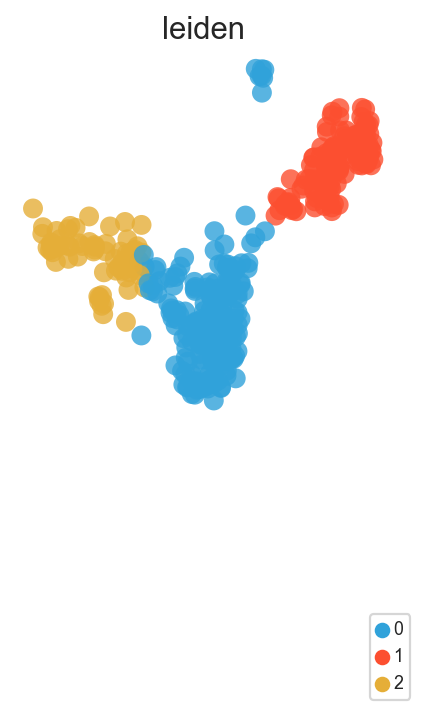

In [636]:
# Create PCA object and fit it to the data
setup_seed(8)

sc.pp.neighbors(control_test, use_rep='X_pca', n_neighbors=30)

# Using the igraph implementation and a fixed number of iterations can be significantly faster, especially for larger datasets
sc.tl.leiden(control_test, resolution=0.25, key_added="leiden 0")

sc.pl.umap(control_test, color=["leiden"], alpha = 0.8, palette = custom_palette, show = False)
plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
plt.show()
# # Visualize
# sc.pl.umap(full_pred_adata, color='celltype', alpha = 0.8, show = False, edgecolor='w', linewidth=0.0, size=80, palette=custom_palette)
# plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
# plt.show()

In [637]:
target_label = age_threshold

In [638]:
adata_test.obs[target_obs_label]

V19_T7     192
V22_T7     192
V24_T7     192
V26_T7     192
V30_T7     192
          ... 
V242_T7    192
V244_T7    192
V246_T7    192
V249_T7    192
V250_T7    192
Name: Condition (Hour), Length: 166, dtype: category
Categories (1, int64): [192]

In [639]:
# def generate_data(G_AB, imgs, sampled_c):
#     # fake_gamma, fake_beta = G_AB(imgs, sampled_c)
#     # fake_imgs = F.relu((imgs + fake_gamma) * fake_beta)
#     fake_imgs = G_AB(imgs, sampled_c)
#     return fake_imgs

def generate_data(G_AB, imgs, sampled_c):
    fake_gamma, fake_beta = G_AB(imgs, sampled_c)
    fake_imgs = F.relu((imgs * fake_gamma) + fake_beta)
    # fake_imgs = F.relu(G_AB(imgs, sampled_c))
    return fake_imgs

  Condition (Hour)                        cell_type
0          control  SAA2 mammary luminal progenitor
1          control             Cycling keratinocyte
2          control             Cycling keratinocyte
3          control             Cycling keratinocyte
4          control             Cycling keratinocyte
(540, 2000)


/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


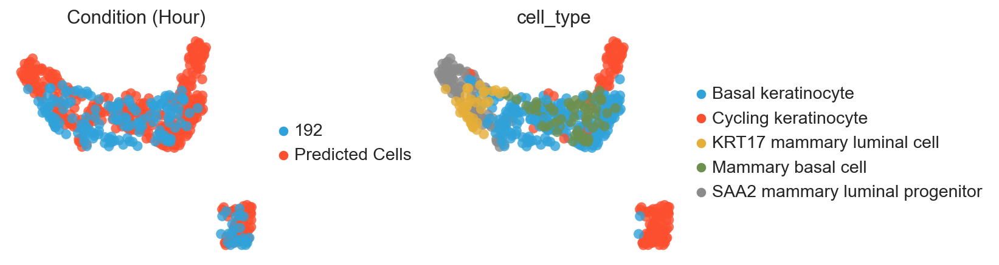

In [640]:
# create one hot encoding3.
batch_size = test_data.shape[0]
# index = 3 # index of the mapping cells

target_array = [target_label] * batch_size
target_tensor = FloatTensor(target_array).unsqueeze(1)

# one_hot_encoded_vectors = one_hot_encode_torch(batch_size, c_dim, [gene_1_index])                                                                             

# predicting section
G_AB.eval()
# anchor_index_oh = enc_batch.transform(np.array([batches[anchor_index]]).reshape(-1, 1)).toarray()[0].tolist().index(1.0)

with torch.no_grad():
    imgs = Variable(FloatTensor(test_data.toarray())).to(device_ids[0])
    src_labels = Variable(target_tensor).to(device_ids[0])

    # torch.ones(imgs.size()[0]).long().cuda()
    # static_sample = G_AB(imgs, src_labels, test = False)
    # fake_gamma, fake_beta = G_AB(imgs, src_labels)

    static_sample = generate_data(G_AB, imgs, src_labels).cpu().detach().numpy()
    # static_sample = test_data * fake_gamma.cpu().detach().numpy() + fake_beta.cpu().detach().numpy()
    # static_sample =  F.relu(FloatTensor(test_data + static_sample.cpu().detach().numpy())).cpu().detach().numpy()
    
output_results = static_sample

# creating the metadata for control cells
data = np.array(["control"])
repeated_data = np.tile(data[np.newaxis, :], (batch_size, 1))
pred_meta = pd.DataFrame(repeated_data, columns=[target_obs_label])
pred_meta["cell_type"] = np.array(control_test.obs["cell_type"])

# getting the true population and its metadata
true_perturb_pop = adata_test[adata_test.obs[target_obs_label] == target_label].X.toarray()
pop_meta = adata_test[adata_test.obs[target_obs_label] == target_label].obs

combine_meta = pd.concat([pred_meta[[target_obs_label, "cell_type"]], pop_meta[[target_obs_label, "cell_type"]]])
combine_gene_exp = np.concatenate([output_results, true_perturb_pop])

print(combine_meta.head())
print(combine_gene_exp.shape)

pred_adata = AnnData(
    X=combine_gene_exp,
    obs=combine_meta
)

# for reproducibility
setup_seed(8)

# pca = PCA(n_components = 50, random_state = 8)
# pca.fit(pred_adata.X)

X_pca = pred_adata.X @ pca_matrix.T
pred_adata.obsm["X_pca"] = X_pca.copy()

# Sort by cell_type
# sorted_adata = pred_adata.obs.sort_values(by='condition')

# Apply the sorting to the AnnData object
# pred_adata = pred_adata[sorted_adata.index].copy()

# compute neighbor and plotting function
pred_adata.obs[target_obs_label].replace("control", "Predicted Cells", inplace = True)

sc.pp.neighbors(pred_adata, use_rep='X_pca', n_neighbors=30)

# sc.external.pp.bbknn(adata_all, batch_key='batch', use_rep='X_latent')
sc.tl.umap(pred_adata)

custom_palette = cc.glasbey_hv

pred_adata.obs[target_obs_label] = pd.Categorical(pred_adata.obs[target_obs_label])

# setup_seed(8)
# random_indices=np.random.permutation(list(range(plot_adata.shape[0])))
# sc.pl.umap(plot_adata[random_indices, :], color=[target_obs_label], alpha = 0.8, legend_fontsize = 9, return_fig = True,
#            palette=customed_color)

sc.pl.umap(pred_adata, color=[target_obs_label, "cell_type"], wspace = 0.5, alpha = 0.8,
           palette=custom_palette)

# pred_adata.obs[target_obs_label].replace("Predicted Cells", "GENEX", inplace = True)

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


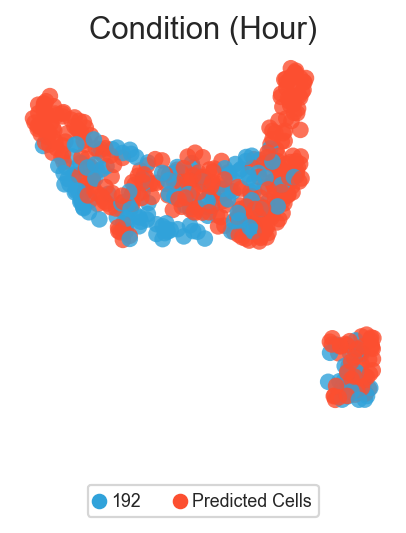

In [641]:
setup_seed(8)
random_indices=np.random.permutation(list(range(pred_adata.shape[0])))
sc.pl.umap(pred_adata[random_indices, :], color=[target_obs_label], alpha = 0.8, legend_fontsize = 9, return_fig = True,
           palette=custom_palette)

# plot_adata.obs[target_obs_label] = plot_adata.obs[target_obs_label].cat.reorder_categories(desired_order)

plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.3), fontsize = 8, ncol = 2)

In [642]:
observed_test = adata_test[adata_test.obs[target_obs_label] == target_label].copy()
observed_test.obsm["X_pca"] = observed_test.X @ pca_matrix.T

observed_test.obs[target_obs_label].replace(target_label, "observed", inplace = True)

In [643]:
# adata_test.var.reset_index(inplace = True)

pred_adata.var = control_test.var
full_adata = pred_adata.concatenate(control_test)


# adding this to the fulladata for evaluating purpose
full_adata = full_adata.concatenate(observed_test)

full_adata.obs[target_obs_label] = full_adata.obs[target_obs_label].astype(str).astype('category')

In [644]:
import ot

def sliced_wasserstein(pred, true, p = 200):
    return ot.sliced_wasserstein_distance(pred, true, n_projections = p)

def downsample_matrices(X, Y):
    """
    Downsamples the smaller matrix to match the size of the larger matrix.

    Args:
      X: First matrix (numpy array).
      Y: Second matrix (numpy array).

    Returns:
      X_downsampled: Downsampled version of X (numpy array).
      Y_downsampled: Downsampled version of Y (numpy array).
    """

    if X.shape[0] < Y.shape[0]:
        # Downsample Y
        indices = np.random.choice(Y.shape[0], size=X.shape[0], replace=False)
        Y_downsampled = Y[indices, :]
        X_downsampled = X
    elif X.shape[0] > Y.shape[0]:
        # Downsample X
        indices = np.random.choice(X.shape[0], size=Y.shape[0], replace=False)
        X_downsampled = X[indices, :]
        Y_downsampled = Y
    else:
        # No downsampling needed
        X_downsampled = X
        Y_downsampled = Y

    return X_downsampled, Y_downsampled

def get_mean_corr(A, B):
    feature_mean_corr = np.corrcoef(A.mean(0), B.mean(0))

    # Set the middle diagonal elements to zero
    np.fill_diagonal(feature_mean_corr, 0)

    feature_mean_corr = np.triu(feature_mean_corr)

    return np.nanmean(np.where(feature_mean_corr!=0,feature_mean_corr,np.nan))

In [645]:
print(sliced_wasserstein(output_results, true_perturb_pop))
print(get_mean_corr(output_results, true_perturb_pop))

0.2634442505673578
0.970935785170762


In [646]:
metric_data = {}

metric_data["GENEX"] = {"sliced_wasserstein": sliced_wasserstein(output_results, true_perturb_pop), "corr mean": get_mean_corr(output_results, true_perturb_pop)}

In [756]:
sns.set_theme(style="whitegrid")

sc.settings.verbosity = 1

sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')

In [757]:
try:
    control_test.var.set_index("symbol", inplace = True)
except:
    control_test

In [758]:
try:
    adata_test.var.set_index("symbol", inplace = True)
except:
    adata_test

In [759]:
adata.obs[target_obs_label].unique().tolist()

[24, 0, 144, 4, 120, 72, 96]

In [760]:
control_test.obsm["X_pca"] = control_test.X @ pca_matrix.T

try:
    control_test.obs[target_obs_label].replace(0, "control", inplace = True)
except:
    pass

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


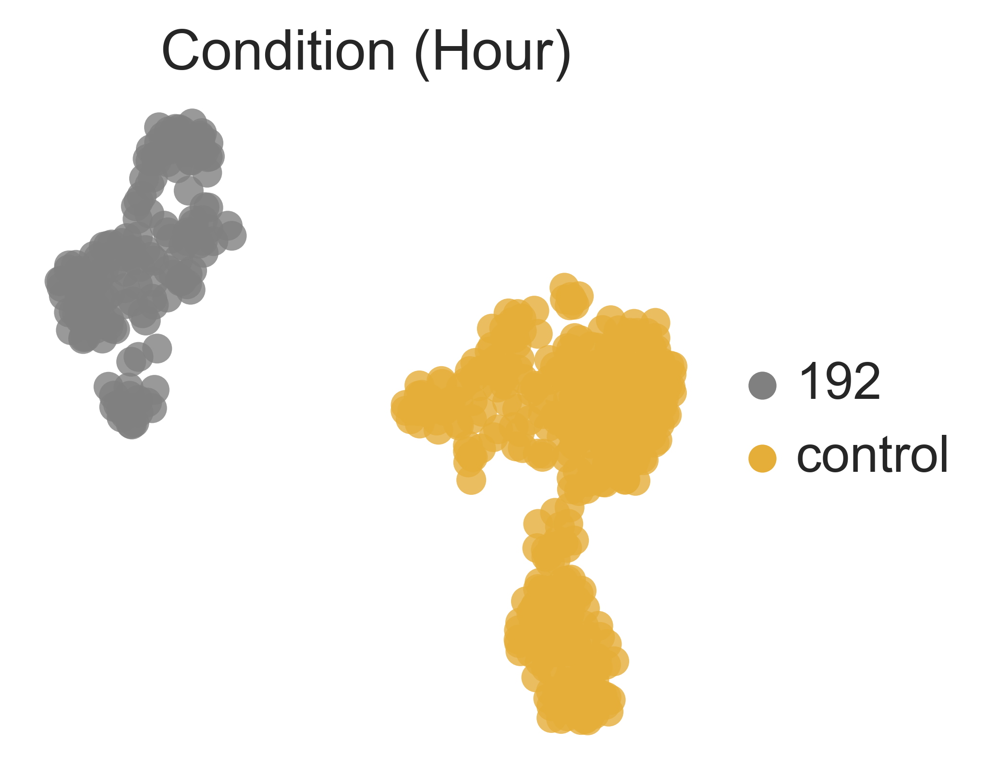

In [761]:
# get the categorical of the condition in aligning with the index and batch number properly
groups = adata.obs[target_obs_label].unique().tolist()

bef_adata = control_test.concatenate(adata_test[adata_test.obs[target_obs_label] == target_label]).copy()
# bef_adata = bef_adata.concatenate(adata[adata.obs.condition.isin([groups[gene_1_index], groups[gene_2_index]])])
# bef_adata = bef_adata.concatenate(adata[adata.obs.condition.isin([groups[gene_1_index]])])

subadata = bef_adata
# plot the raw adata in the training sample
setup_seed(8)

# pca = PCA(n_components = 50, random_state = 8)
# pca.fit(subadata.X)

X_pca = subadata.X @ pca_matrix.T
subadata.obsm["X_pca"] = X_pca.copy()

sc.pp.neighbors(subadata, use_rep='X_pca', n_neighbors=30)
# sc.external.pp.bbknn(adata_all, batch_key='batch', use_rep='X_latent')
sc.tl.umap(subadata)

custom_palette = cc.glasbey_hv

sc.pl.umap(subadata, color=[target_obs_label], alpha = 0.8,
           palette=['grey', custom_palette[2]])

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


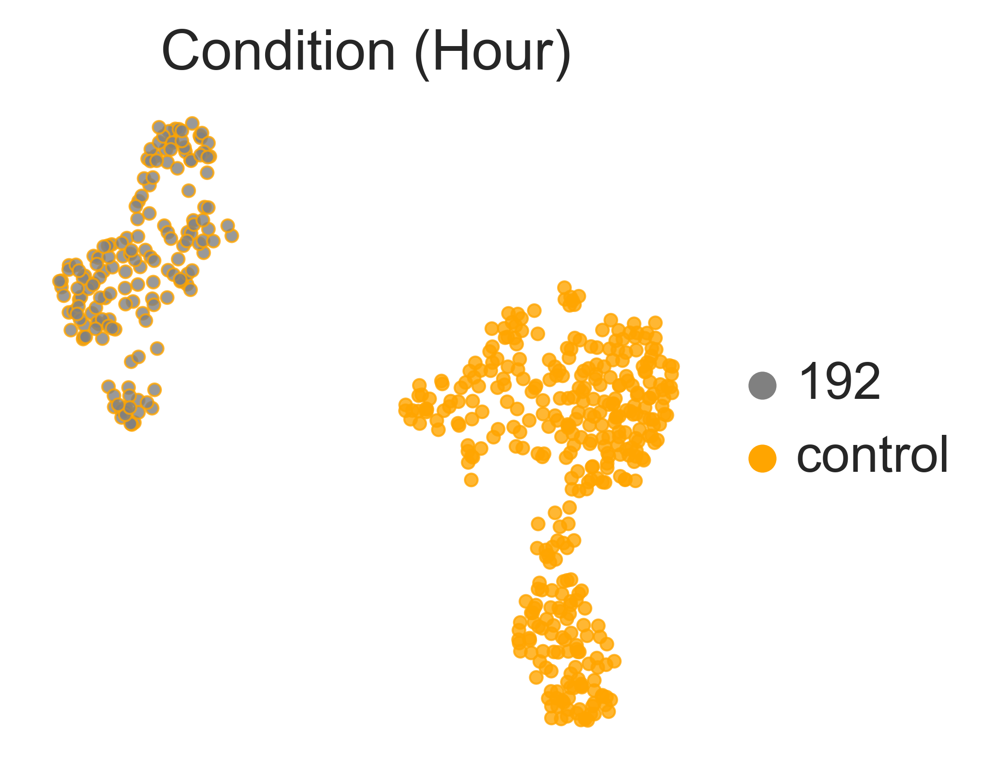

In [762]:
sc.pl.umap(subadata, color=[target_obs_label], alpha = 0.8, show = False, edgecolor='orange', linewidth=0.5, size=40,
           palette=["grey", "orange"])
plt.show()

## Contour Plot for the figure generation

In [763]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm 
import scipy.stats as st

In [764]:
data_umap = subadata.obsm["X_umap"]
meta_umap = subadata.obs[target_obs_label]
meta_umap.unique()

['control', 192]
Categories (2, object): [192, 'control']

In [765]:
np.amax(data_umap)

15.900113

In [766]:
np.amin(data_umap)

-1.7354351

In [767]:
# Set scanpy to use Matplotlib
from IPython.display import display, HTML

def plot_save_svg():
    import scanpy as sc
    import matplotlib.pyplot as plt
    sc.settings.set_figure_params(format='svg', frameon=False, figsize=(3, 3), facecolor='white', vector_friendly=False)
    
    # output_filename
    output_filename = "fig.svg"
    plt.grid(False)
    # plt.tight_layout()
    plt.savefig(output_filename, format='svg', bbox_inches='tight', dpi=600, backend = "svg")
    display(HTML(f'<a href="{output_filename}" download>Download {output_filename}</a>'))

/tmp/ipykernel_84595/100665805.py:40: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color = cm.get_cmap(contour_colormaps[i % len(contour_colormaps)])


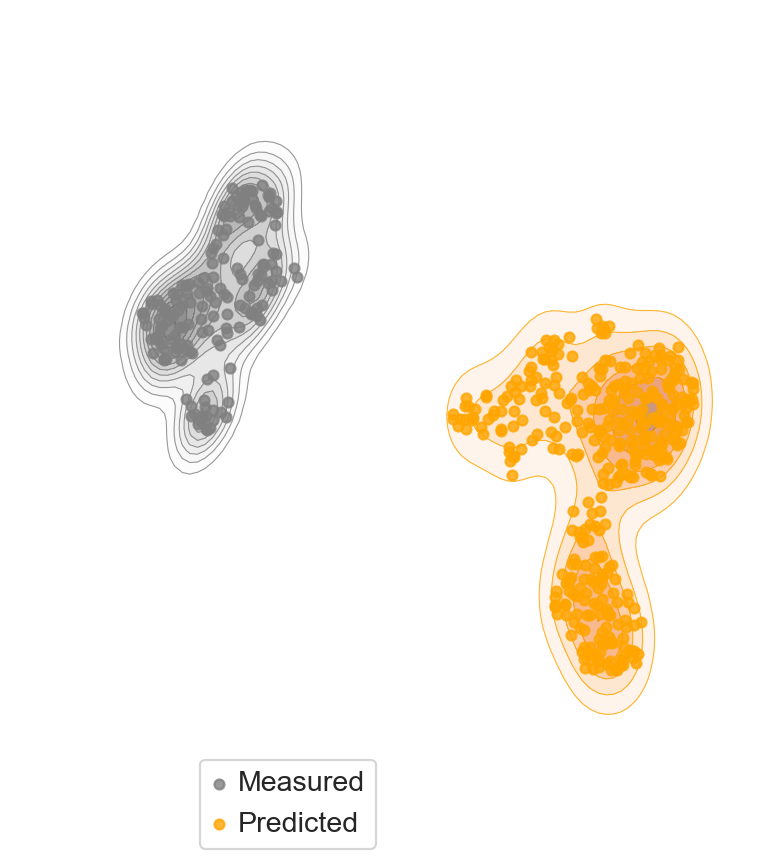

In [769]:
sub_model = [192, "control"]

# metadata_plot = meta_umap.unique()
metadata_plot = sub_model

# List of aesthetically chosen scatter plot colors
scatter_colors = ["grey", 'orange', 'green', 'red', 'purple', 'blue']

# List of colormaps for the contour plot
contour_colormaps = ["Greys", "Oranges", "Greens", "Reds", "Purples", "Blues"]

fig, ax = plt.subplots(figsize=(6, 6))

def contour_cloud(x, y, cmap, color):
    xmin, xmax = -4, 18
    ymin, ymax = -4, 18

    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values)
    f = np.reshape(kernel(positions).T, xx.shape)

    step = 0.006
    m = np.amax(f)
    levels = np.arange(0.0, m, step) + step
    plt.contour(xx,yy,f,levels, colors = color, linewidths = 0.5, alpha = 0.8)
    plt.contourf(xx, yy, f, levels, cmap=cmap, alpha=0.5)

# size of the dot plot
s = 20

for i, each in enumerate(metadata_plot):
    # get the index based on value of perturbation
    index = meta_umap == each
    temp_data = data_umap[index]
    
    # Use a different color for each group
    color = cm.get_cmap(contour_colormaps[i % len(contour_colormaps)])
    color_2 = scatter_colors[i % len(scatter_colors)]
    
    contour_cloud(x=temp_data[:, 0], y=temp_data[:, 1], cmap = color, color = color_2)

# lets test with just two first

for i, each in enumerate(metadata_plot):
    # get the index based on value of perturbation
    index = meta_umap == each
    
    temp_data = data_umap[index]
    
    # Use a different color for each group
    color = scatter_colors[i % len(scatter_colors)]
    
    # plt.scatter(x=temp_data[:,0], y=temp_data[:,1], s=s, color = color, label=each, alpha = 0.8)

    # adding label for the predicted cells
    if each == "GENEX":
        plt.scatter(x=temp_data[:,0], y=temp_data[:,1], s=s, color = color, label="GENEX", alpha = 0.8)
        
    elif each == 192:
        plt.scatter(x=temp_data[:,0], y=temp_data[:,1], s=s, color = color, label="Measured", alpha = 0.8)
    else:
        plt.scatter(x=temp_data[:,0], y=temp_data[:,1], s=s, color = color, label="Control", alpha = 0.8)
    
# fig = plt.gcf()
# ax = plt.gca()
ax.set_frame_on(False)
ax.tick_params(left=False, right=False, bottom=False, top=False, labelleft=False, labelbottom=False)

plt.grid(False)
plt.legend(loc="upper right", bbox_to_anchor=(0.5, -.0))
plot_save_svg()
# plt.show()

## scatter plot and contour for the predicted value

In [660]:
data_umap = full_adata.obsm["X_umap"]
meta_umap = full_adata.obs[target_obs_label]
meta_umap.unique()

['Predicted Cells', '192', 'control', 'observed']
Categories (4, object): ['192', 'Predicted Cells', 'control', 'observed']

In [661]:
np.amax(data_umap)

13.938977

In [662]:
np.amin(data_umap)

-3.1556113

/tmp/ipykernel_84595/2917632288.py:40: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color = cm.get_cmap(contour_colormaps[i % len(contour_colormaps)])


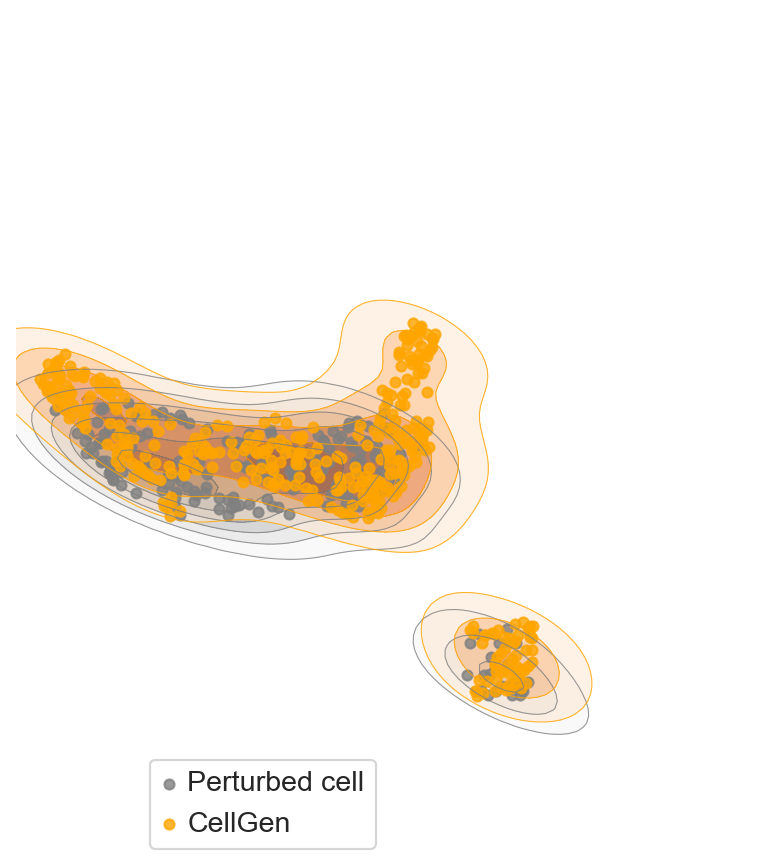

In [663]:
sub_model = ["192", "Predicted Cells"]

# metadata_plot = meta_umap.unique()
metadata_plot = sub_model

# List of aesthetically chosen scatter plot colors
scatter_colors = ["grey", 'orange', 'green', 'red', 'purple', 'blue']

# List of colormaps for the contour plot
contour_colormaps = ["Greys", "Oranges", "Greens", "Reds", "Purples", "Blues"]

fig, ax = plt.subplots(figsize=(6, 6))

def contour_cloud(x, y, cmap, color):
    xmin, xmax = -4, 22
    ymin, ymax = -4, 22

    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values)
    f = np.reshape(kernel(positions).T, xx.shape)

    step = 0.003
    m = np.amax(f)
    levels = np.arange(0.0, m, step) + step
    plt.contour(xx,yy,f,levels, colors = color, linewidths = 0.5, alpha = 0.8)
    plt.contourf(xx, yy, f, levels, cmap=cmap, alpha=0.5)

# size of the dot plot
s = 20

for i, each in enumerate(metadata_plot):
    # get the index based on value of perturbation
    index = meta_umap == each
    temp_data = data_umap[index]
    
    # Use a different color for each group
    color = cm.get_cmap(contour_colormaps[i % len(contour_colormaps)])
    color_2 = scatter_colors[i % len(scatter_colors)]
    
    contour_cloud(x=temp_data[:, 0], y=temp_data[:, 1], cmap = color, color = color_2)

# lets test with just two first

for i, each in enumerate(metadata_plot):
    # get the index based on value of perturbation
    index = meta_umap == each
    
    temp_data = data_umap[index]
    
    # Use a different color for each group
    color = scatter_colors[i % len(scatter_colors)]
    
    # plt.scatter(x=temp_data[:,0], y=temp_data[:,1], s=s, color = color, label=each, alpha = 0.8)

    # adding label for the predicted cells
    if each == "Predicted Cells":
        plt.scatter(x=temp_data[:,0], y=temp_data[:,1], s=s, color = color, label="CellGen", alpha = 0.8)
        
    # elif each == 192:
    #     plt.scatter(x=temp_data[:,0], y=temp_data[:,1], s=s, color = color, label="Perturbed Cell", alpha = 0.8)
    else:
        plt.scatter(x=temp_data[:,0], y=temp_data[:,1], s=s, color = color, label="Perturbed cell", alpha = 0.8)
    
# fig = plt.gcf()
# ax = plt.gca()
ax.set_frame_on(False)
ax.tick_params(left=False, right=False, bottom=False, top=False, labelleft=False, labelbottom=False)

plt.grid(False)
plt.legend(loc="upper right", bbox_to_anchor=(0.5, -.0))
plot_save_svg()
# plt.show()

In [664]:
subadata[subadata.obs[target_obs_label] == target_label].X.toarray()

array([[0.        , 0.37298264, 0.        , ..., 0.        , 0.        ,
        0.37298264],
       [0.        , 0.        , 0.        , ..., 1.44682886, 0.        ,
        0.        ],
       [0.        , 0.38859118, 0.        , ..., 0.38859118, 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        3.39234606]])

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


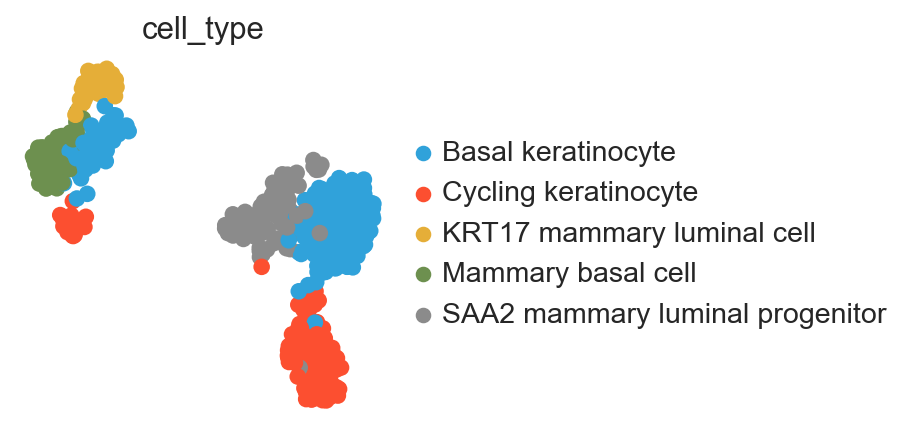

In [665]:
sc.pl.umap(subadata, color=["cell_type"],
           palette=custom_palette)

In [666]:
# for the Control
control_expr = subadata[subadata.obs[target_obs_label] == "control"].copy().X.toarray()
perturbed_expr = subadata[subadata.obs[target_obs_label] == target_label].copy().X.toarray()

print(sliced_wasserstein(control_expr, perturbed_expr))
print(get_mean_corr(control_expr, perturbed_expr))

0.32294441243992855
0.7715839259531628


In [667]:
metric_data["Control"] = {"sliced_wasserstein": sliced_wasserstein(control_expr, perturbed_expr), "corr mean": get_mean_corr(control_expr, perturbed_expr)}

In [668]:
# for observed data
perturbed_expr = subadata[subadata.obs[target_obs_label] == target_label].copy().X.toarray()

print(sliced_wasserstein(perturbed_expr, perturbed_expr))
print(get_mean_corr(perturbed_expr, perturbed_expr))

0.0
0.9999999999999999


In [669]:
metric_data

{'GENEX': {'sliced_wasserstein': 0.25843619289245157,
  'corr mean': 0.970935785170762},
 'Control': {'sliced_wasserstein': 0.3475882748973746,
  'corr mean': 0.7715839259531628}}

In [670]:
metric_data["Observed"] = {"sliced_wasserstein": sliced_wasserstein(perturbed_expr, perturbed_expr), "corr mean": get_mean_corr(perturbed_expr, perturbed_expr)}

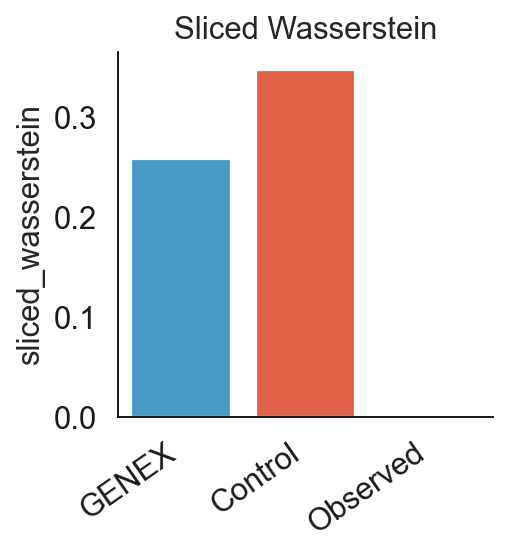

In [671]:
metric_data_df = pd.DataFrame(metric_data).transpose()

colors_list = cc.glasbey_hv

data = metric_data_df[["sliced_wasserstein"]]

# create desirable order of the x axis
data = data.loc[["GENEX", "Control", "Observed"]]
sns.barplot(x = data.index, y = "sliced_wasserstein", data = data, palette = colors_list)

plt.grid(False)
# plt.xlabel('')
# plt.ylabel('Log-Scaled')
plt.xticks(rotation = 35, ha='right')
plt.title("Sliced Wasserstein")
sns.despine()

In [672]:
from sklearn.metrics.pairwise import rbf_kernel

def mmd_distance(x, y, gamma):
    xx = rbf_kernel(x, x, gamma)
    xy = rbf_kernel(x, y, gamma)
    yy = rbf_kernel(y, y, gamma)

    return xx.mean() + yy.mean() - 2 * xy.mean()
    
def compute_mmd_loss(lhs, rhs, gammas):
    return np.mean([mmd_distance(lhs, rhs, g) for g in gammas])

def compute_scalar_mmd(target, transport, gammas=None):
    if gammas is None:
        gammas = [2, 1, 0.5, 0.1, 0.01, 0.005]

    def safe_mmd(*args):
        try:
            mmd = mmd_distance(*args)
        except ValueError:
            mmd = np.nan
        return mmd

    return np.mean(list(map(lambda x: safe_mmd(target, transport, x), gammas)))

In [673]:
target_label

192

In [674]:
pred_adata.obs[target_obs_label].replace("Predicted Cells", "GENEX", inplace = True)

In [675]:
observed_test.obs

,orig_ident,nCount_RNA,nFeature_RNA,sample,percent_mt,RNA_snn_res_0_8,seurat_clusters,cell_type,cell_type_score,sampling_weight,...,Sample Type,Platform,Cellline,Condition (Hour),n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_counts
V19_T7,0,22122.0,4922,GSM6047816,0.0,2,2,Cycling keratinocyte,skin,16.358635,...,Cell Line,SureCell,MCF10A,observed,4922,4921,22121.0,219.0,0.990009,22121.0
V22_T7,0,21541.0,4782,GSM6047816,0.0,0,0,Mammary basal cell,breast_milk,8.241216,...,Cell Line,SureCell,MCF10A,observed,4782,4782,21541.0,344.0,1.596955,21541.0
V24_T7,0,21057.0,4871,GSM6047816,0.0,0,0,Mammary basal cell,breast_milk,10.050919,...,Cell Line,SureCell,MCF10A,observed,4871,4871,21057.0,286.0,1.358218,21057.0
V26_T7,0,20643.0,4610,GSM6047816,0.0,0,0,Mammary basal cell,breast_milk,9.142596,...,Cell Line,SureCell,MCF10A,observed,4610,4610,20643.0,291.0,1.409679,20643.0
V30_T7,0,20529.0,4812,GSM6047816,0.0,2,2,Cycling keratinocyte,skin,18.902679,...,Cell Line,SureCell,MCF10A,observed,4812,4808,20525.0,254.0,1.237515,20525.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V242_T7,0,925.0,598,GSM6047816,0.0,1,1,Basal keratinocyte,skin,11.961389,...,Cell Line,SureCell,MCF10A,observed,598,598,925.0,16.0,1.729730,925.0
V244_T7,0,866.0,589,GSM6047816,0.0,1,1,Basal keratinocyte,skin,9.704292,...,Cell Line,SureCell,MCF10A,observed,589,589,866.0,6.0,0.692841,866.0
V246_T7,0,842.0,541,GSM6047816,0.0,1,1,Basal keratinocyte,skin,16.218570,...,Cell Line,SureCell,MCF10A,observed,541,541,842.0,5.0,0.593824,842.0
V249_T7,0,738.0,543,GSM6047816,0.0,1,1,Basal keratinocyte,skin,13.411332,...,Cell Line,SureCell,MCF10A,observed,543,541,736.0,11.0,1.494565,736.0


In [676]:
# adata_test.var.reset_index(inplace = True)

pred_adata.var = control_test.var
full_adata = pred_adata.concatenate(control_test)


# adding this to the fulladata for evaluating purpose
full_adata = full_adata.concatenate(observed_test)

full_adata.obs[target_obs_label] = full_adata.obs[target_obs_label].astype(str).astype('category')

In [677]:
def compute_mmd_metric(model_name, full_adata):
    
    pred_adata = full_adata[full_adata.obs[target_obs_label].isin([model_name])].copy()
    X_pred = pred_adata.X.toarray()
    
    obs_adata = full_adata[full_adata.obs[target_obs_label].isin([str(target_label)])].copy()
    X_true = obs_adata.X.toarray()
    
    return compute_scalar_mmd(X_true, X_pred).round(4)

compute_mmd_metric("GENEX", full_adata)

0.0616

In [678]:
metric_data["GENEX"]["MMD"] = compute_mmd_metric("GENEX", full_adata)
metric_data["Control"]["MMD"] = compute_mmd_metric("control", full_adata)
metric_data["Observed"]["MMD"] = compute_mmd_metric("observed", full_adata)

In [679]:
metric_data

{'GENEX': {'sliced_wasserstein': 0.25843619289245157,
  'corr mean': 0.970935785170762,
  'MMD': 0.0616},
 'Control': {'sliced_wasserstein': 0.3475882748973746,
  'corr mean': 0.7715839259531628,
  'MMD': 0.0195},
 'Observed': {'sliced_wasserstein': 0.0,
  'corr mean': 0.9999999999999999,
  'MMD': 0.0}}

In [680]:
def compute_pairwise_corrs(df):
    corr = df.corr().rename_axis(index='lhs', columns='rhs')
    return (
        corr
        .where(np.triu(np.ones(corr.shape), k=1).astype(bool))
        .stack()
        .reset_index()
        .set_index(['lhs', 'rhs'])
        .squeeze()
        .rename()
    )

# def compute_mmd_metric(model_name, full_adata):


def compute_r2_feature(model_name, full_adata):
    
    pred_adata = full_adata[full_adata.obs[target_obs_label].isin([model_name])].copy()
    X_pred = pred_adata.X.toarray()
    
    obs_adata = full_adata[full_adata.obs[target_obs_label].isin([str(target_label)])].copy()
    X_true = obs_adata.X.toarray()
    
    pwct = compute_pairwise_corrs(pd.DataFrame(X_true))
    pwci = compute_pairwise_corrs(pd.DataFrame(X_pred))
    
    return pd.Series.corr(pwct, pwci).round(4)

def compute_r2_mean(model_name, full_adata):
    
    pred_adata = full_adata[full_adata.obs[target_obs_label].isin([model_name])].copy()
    X_pred = pred_adata.X.toarray()
    
    obs_adata = full_adata[full_adata.obs[target_obs_label].isin([str(target_label)])].copy()
    X_true = obs_adata.X.toarray()
    
    return pd.Series.corr(pd.Series(X_true.mean(0)), pd.Series(X_pred.mean(0))).round(4)

In [681]:
metric_data["GENEX"]["r2"] = compute_r2_mean("GENEX", full_adata)
metric_data["Control"]["r2"] = compute_r2_mean("control", full_adata)
metric_data["Observed"]["r2"] = compute_r2_mean("observed", full_adata)

In [682]:
try:
    adata_test.var.set_index("symbol", inplace = True)
except:
    adata_test

adata_test_deg = adata_test.copy()

adata_test_deg = adata_test_deg.concatenate(control_test)
adata_test_deg.obs[target_obs_label] = adata_test_deg.obs[target_obs_label].astype(str).astype('category')
adata_test_deg

AnnData object with n_obs × n_vars = 540 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'leiden 0', 'batch'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'X_pca', 'X_umap'

In [683]:
def compute_logfc(cell_adata, group, group_name, layer):
#     cell_adata = deg_adata[deg_adata.obs["CellType"] == cell_type_name]
    group_list = sorted(list(set(cell_adata.obs[group_name])))
    
    pseudocount = 1

    group_A = cell_adata[cell_adata.obs[group_name] == group] #BMA
    group_A_log = np.log2(np.mean(np.expm1(group_A.layers[layer].toarray()), axis = 0) + pseudocount)
    
    list_logfc = []
    
    for each in group_list:
        if each != group:
            group_B = cell_adata[cell_adata.obs[group_name] == each] #LLN
            group_B_log = np.log2(np.mean(np.expm1(group_B.layers[layer].toarray()), axis = 0) + pseudocount)

    #         logfc = pd.DataFrame(np.around(group_A_log - group_B_log, 4), index = cell_adata.var.index, columns = ["logfc"])
            logfc = np.around(group_A_log - group_B_log, 4)
            list_logfc.append(logfc)
    if len(list_logfc) == 1:
        return pd.DataFrame(list_logfc[0], index = cell_adata.var.index, columns = ["logfc"])
    else:
        return pd.DataFrame(np.mean(list_logfc, axis = 0), index = cell_adata.var.index, columns = ["logfc"])

In [684]:
def get_deg(adata_test_deg, layer_name = "X_raw", top = 20):

    '''
    layer_name must be either X_raw or X_pred
    '''
    adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
    
    # uncomment for raw data degs
    adata_test_deg.obsm[f'{layer_name}_pca'] = adata_test_deg.layers[layer_name] @ pca_matrix.T

    sc.tl.dendrogram(adata_test_deg, use_rep = f'{layer_name}_pca', groupby = group_name, optimal_ordering=False)
    
    group_index = 0
    adata_test_deg.X = adata_test_deg.layers[layer_name]
    adata_test_deg.X[adata_test_deg.X < 1] = 0
    adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
    sc.tl.rank_genes_groups(adata_test_deg, group_name, method='wilcoxon', use_raw = False, corr_method='benjamini-hochberg', layer = layer_name, pts = True)

    deg_fc = compute_logfc(adata_test_deg, groups[group_index], group_name, layer_name)

    
    deg_df = sc.get.rank_genes_groups_df(adata_test_deg, group = groups[group_index], key='rank_genes_groups')
    deg_df.set_index("names", inplace = True)
    # deg_df = deg_df.loc[genes]
    deg_df["logfoldchanges"] = deg_fc

    # setting the filter parameters
    # deg_df = deg_df[(deg_df["pct_nz_group"] >= 0.5) & (deg_df["pct_nz_reference"] >= 0.05) & (deg_df["pvals_adj"] < 0.05)]

    deg_df = deg_df[(deg_df["pvals_adj"] < 0.05)]
    
    filtered_deg = deg_df.sort_values("logfoldchanges", ascending = False)
    
    raw_deg = list(filtered_deg.index.values)

    # we only want to get top 20
    return raw_deg[:top]

In [685]:
group_name = target_obs_label
groups = sorted(list(set(adata_test_deg.obs[group_name])))
# groups = sorted(list(set(adata_int.obs["Group"])))

groups

['192', 'control']

In [686]:
# get the maximum number of DEGs in the dataset
len(get_deg(adata_test_deg, top = 50))

/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


50

In [687]:
adata_test_deg

AnnData object with n_obs × n_vars = 540 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'leiden 0', 'batch'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'dendrogram_Condition (Hour)', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'X_raw_pca'
    layers: 'X_raw'

In [688]:
celltype_list = list(adata_test.obs["cell_type"].unique())
celltype_list

['Cycling keratinocyte',
 'Mammary basal cell',
 'Basal keratinocyte',
 'KRT17 mammary luminal cell']

In [689]:
target_label

192

In [690]:
import rbo

def compute_rbo(adata_test_deg, full_adata, model_name, celltype):
    rbo_list = []
    
    # define the number of deg to test
    top_deg_num = [10, 20, 30, 40, 50]

    # adata_test_deg = adata_test_deg[adata_test_deg.obs["cell_type"] == celltype].copy()

    # print(adata_test_deg.obs.cell_type)
    # print(adata_test_deg[adata_test_deg.obs.condition.isin(["ctrl"])].X.shape)

    for top_num in top_deg_num:
        # get the ground truth DEGs
        observed_deg = get_deg(adata_test_deg, top = top_num)
    
        # get the DEGs from the predicted gene expressions
        adata_pred_deg = full_adata[full_adata.obs[target_obs_label].isin(["control", model_name])].copy()

        # subset to the given cell type for the DEGs
        # adata_pred_deg = adata_pred_deg[adata_pred_deg.obs["cell_type"] == celltype].copy()

        # print(adata_pred_deg[adata_pred_deg.obs.condition.isin(["ctrl"])].X.shape)

        # print(adata_pred_deg.obs.cell_type)
        adata_pred_deg.obs[target_obs_label].replace(model_name, str(target_label), inplace = True)
        adata_pred_deg.obs[target_obs_label] = adata_pred_deg.obs[target_obs_label].astype('category')

        pred_deg = get_deg(adata_pred_deg, "X_pred", top = top_num)
    
        rbo_score = round(rbo.RankingSimilarity(pred_deg, observed_deg).rbo(p=1.0), 4)
        rbo_list.append(rbo_score)

    return rbo_list

compute_rbo(adata_test_deg, full_adata, model_name = "GENEX", celltype = celltype_list[0])

/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero 

[0.8619, 0.7696, 0.7504, 0.7529, 0.7492]

In [691]:
metric_data

{'GENEX': {'sliced_wasserstein': 0.25843619289245157,
  'corr mean': 0.970935785170762,
  'MMD': 0.0616,
  'r2': 0.9709},
 'Control': {'sliced_wasserstein': 0.3475882748973746,
  'corr mean': 0.7715839259531628,
  'MMD': 0.0195,
  'r2': 0.7716},
 'Observed': {'sliced_wasserstein': 0.0,
  'corr mean': 0.9999999999999999,
  'MMD': 0.0,
  'r2': 1.0}}

In [692]:
metric_data["GENEX"]["RBO_total"] = compute_rbo(adata_test_deg, full_adata, model_name = "GENEX", celltype = celltype_list[0])

/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero 

In [693]:
metric_data

{'GENEX': {'sliced_wasserstein': 0.25843619289245157,
  'corr mean': 0.970935785170762,
  'MMD': 0.0616,
  'r2': 0.9709,
  'RBO_total': [0.8619, 0.7696, 0.7504, 0.7529, 0.7492]},
 'Control': {'sliced_wasserstein': 0.3475882748973746,
  'corr mean': 0.7715839259531628,
  'MMD': 0.0195,
  'r2': 0.7716},
 'Observed': {'sliced_wasserstein': 0.0,
  'corr mean': 0.9999999999999999,
  'MMD': 0.0,
  'r2': 1.0}}

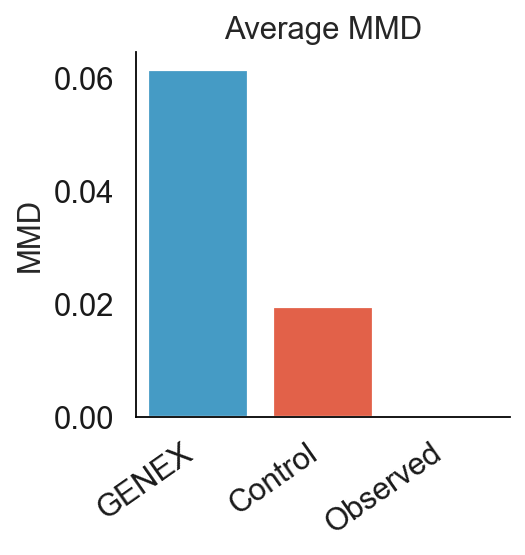

In [694]:
metric_data_df = pd.DataFrame(metric_data).transpose()

colors_list = cc.glasbey_hv

data = metric_data_df[["MMD"]]

# create desirable order of the x axis
data = data.loc[["GENEX","Control", "Observed"]]
sns.barplot(x = data.index, y = "MMD", data = data, palette = colors_list)

plt.grid(False)
# plt.xlabel('')
# plt.ylabel('Log-Scaled')
plt.xticks(rotation = 35, ha = "right")
plt.title("Average MMD")
sns.despine()

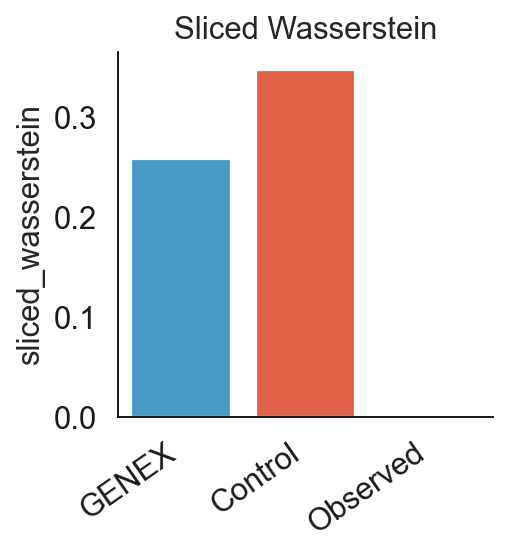

In [695]:
metric_data_df = pd.DataFrame(metric_data).transpose()

colors_list = cc.glasbey_hv

data = metric_data_df[["sliced_wasserstein"]]

# create desirable order of the x axis
data = data.loc[["GENEX", "Control", "Observed"]]
sns.barplot(x = data.index, y = "sliced_wasserstein", data = data, palette = colors_list)

plt.grid(False)
# plt.xlabel('')
# plt.ylabel('Log-Scaled')
plt.xticks(rotation = 35, ha='right')
plt.title("Sliced Wasserstein")
sns.despine()

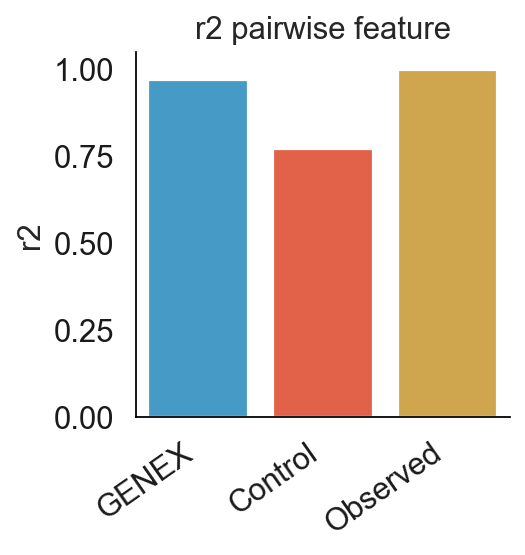

In [696]:
metric_data_df = pd.DataFrame(metric_data).transpose()

colors_list = cc.glasbey_hv

data = metric_data_df[["r2"]]

# create desirable order of the x axis
data = data.loc[["GENEX", "Control", "Observed"]]
sns.barplot(x = data.index, y = "r2", data = data, palette = colors_list)

plt.grid(False)
# plt.xlabel('')
# plt.ylabel('Log-Scaled')
plt.xticks(rotation = 35, ha = "right")
plt.title("r2 pairwise feature")
sns.despine()

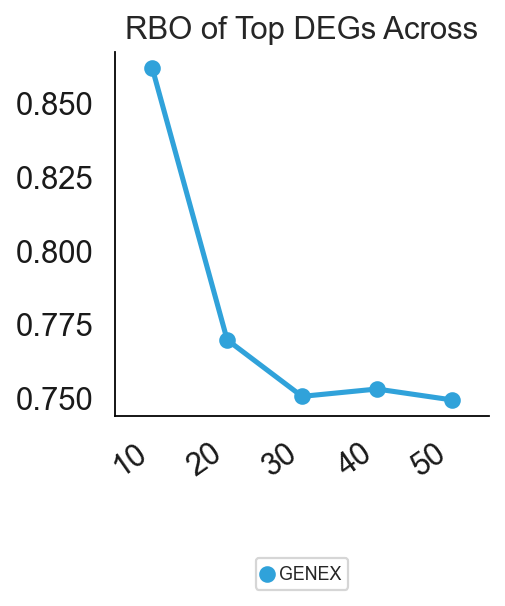

In [697]:
metric_data_df = pd.DataFrame(metric_data).transpose()

data = metric_data_df[["RBO_total"]]
data = data.loc[["GENEX"]]
data = data.explode("RBO_total")
# data
data.reset_index(inplace = True)
data.columns = ["model", "RBO_total"]
data["RBO_total"] = pd.to_numeric(data["RBO_total"])
data["DEGs"] = pd.to_numeric([10, 20, 30, 40, 50] * 1)

# # data

# # # create desirable order of the x axis

sns.pointplot(x = "DEGs", y = "RBO_total", data = data, palette = colors_list, hue = "model", scale = 0.85)

plt.grid(False)
plt.xlabel('')
plt.ylabel('')
plt.xticks(rotation = 35, ha = "right")
plt.title("RBO of Top DEGs Across")
plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.5), fontsize = 8, ncol = 4)
sns.despine()
plt.show()

In [698]:
full_adata.obs[target_obs_label]

0-0-0           GENEX
1-0-0           GENEX
2-0-0           GENEX
3-0-0           GENEX
4-0-0           GENEX
               ...   
V242_T7-1    observed
V244_T7-1    observed
V246_T7-1    observed
V249_T7-1    observed
V250_T7-1    observed
Name: Condition (Hour), Length: 1080, dtype: category
Categories (4, object): ['192', 'GENEX', 'control', 'observed']

In [699]:
import numpy as np
import pandas as pd
from sklearn.neighbors import NearestNeighbors
from typing import Iterable

def compute_lisi(
    X: np.array,
    metadata: pd.DataFrame,
    label_colnames: Iterable[str],
    perplexity: float=40
):
    """Compute the Local Inverse Simpson Index (LISI) for each column in metadata.
    LISI is a statistic computed for each item (row) in the data matrix X.
    The following example may help to interpret the LISI values.
    Suppose one of the columns in metadata is a categorical variable with 3 categories.
        - If LISI is approximately equal to 3 for an item in the data matrix,
          that means that the item is surrounded by neighbors from all 3
          categories.
        - If LISI is approximately equal to 1, then the item is surrounded by
          neighbors from 1 category.
    
    The LISI statistic is useful to evaluate whether multiple datasets are
    well-integrated by algorithms such as Harmony [1].
    [1]: Korsunsky et al. 2019 doi: 10.1038/s41592-019-0619-0
    """
    n_cells = metadata.shape[0]
    n_labels = len(label_colnames)
    # We need at least 3 * n_neigbhors to compute the perplexity
    knn = NearestNeighbors(n_neighbors = perplexity * 3, algorithm = 'kd_tree').fit(X)
    distances, indices = knn.kneighbors(X)
    # Don't count yourself
    indices = indices[:,1:]
    distances = distances[:,1:]
    # Save the result
    lisi_df = np.zeros((n_cells, n_labels))
    for i, label in enumerate(label_colnames):
        labels = pd.Categorical(metadata[label])
        n_categories = len(labels.categories)
        simpson = compute_simpson(distances.T, indices.T, labels, n_categories, perplexity)
        
#         print(simpson)
        lisi_df[:,i] = 1 / simpson
    return lisi_df

def compute_simpson(
    distances: np.ndarray,
    indices: np.ndarray,
    labels: pd.Categorical,
    n_categories: int,
    perplexity: float,
    tol: float=1e-5
):
    n = distances.shape[1]
    P = np.zeros(distances.shape[0])
    simpson = np.zeros(n)
    logU = np.log(perplexity)
    # Loop through each cell.
    for i in range(n):
        beta = 1
        betamin = -np.inf
        betamax = np.inf
        # Compute Hdiff
        P = np.exp(-distances[:,i] * beta)
        P_sum = np.sum(P)
        if P_sum == 0:
            H = 0
            P = np.zeros(distances.shape[0])
        else:
            H = np.log(P_sum) + beta * np.sum(distances[:,i] * P) / P_sum
            P = P / P_sum
        Hdiff = H - logU
        n_tries = 50
        for t in range(n_tries):
            # Stop when we reach the tolerance
            if abs(Hdiff) < tol:
                break
            # Update beta
            if Hdiff > 0:
                betamin = beta
                if not np.isfinite(betamax):
                    beta *= 2
                else:
                    beta = (beta + betamax) / 2
            else:
                betamax = beta
                if not np.isfinite(betamin):
                    beta /= 2
                else:
                    beta = (beta + betamin) / 2
            # Compute Hdiff
            P = np.exp(-distances[:,i] * beta)
            P_sum = np.sum(P)
            if P_sum == 0:
                H = 0
                P = np.zeros(distances.shape[0])
            else:
                H = np.log(P_sum) + beta * np.sum(distances[:,i] * P) / P_sum
                P = P / P_sum
            Hdiff = H - logU
        # distancesefault value
        if H == 0:
            simpson[i] = -1
        # Simpson's index
        for label_category in labels.categories:
            ix = indices[:,i]
            q = labels[ix] == label_category
            if np.any(q):
                P_sum = np.sum(P[q])
                simpson[i] += P_sum * P_sum
    return simpson

In [700]:
target_label

192

In [701]:
full_adata.obs[target_obs_label]

0-0-0           GENEX
1-0-0           GENEX
2-0-0           GENEX
3-0-0           GENEX
4-0-0           GENEX
               ...   
V242_T7-1    observed
V244_T7-1    observed
V246_T7-1    observed
V249_T7-1    observed
V250_T7-1    observed
Name: Condition (Hour), Length: 1080, dtype: category
Categories (4, object): ['192', 'GENEX', 'control', 'observed']

In [702]:
sum(full_adata.obs[target_obs_label].isin(["192", "observed"]))

332

In [703]:
# define model to compute for the ilisi score

# take number of cell into consideration
def compute_ilisi(model_name, full_adata):

    # subset to the model of interest
    sub_model = [str(target_label), model_name]
    
    metric_adata = full_adata[full_adata.obs[target_obs_label].isin(sub_model)].copy()

    print(metric_adata)
    
    X_array_test = metric_adata.X @ pca_matrix.T
    metadata = metric_adata.obs
    
    # computing the ilisi score
    batch_str = target_obs_label
    ilisi = compute_lisi(X_array_test, metadata, [batch_str], perplexity = 15)
    
    # for scaling purpose
    # ilisi = (ilisi - 1) / (n_batch - 1)
    
    temp_df = pd.DataFrame({"score": ilisi.transpose().reshape(-1),
                  "meta": metadata[batch_str].values})

    print()
    
    # gp_temp_df_raw = temp_df.groupby("meta")
    
    # # Calculate the median and IQR for each group
    # summary_stats = gp_temp_df_raw['score'].agg(
    #     median = np.nanmedian,
    #     q1 = lambda x: np.percentile(x, 25),
    #     q3 = lambda x: np.percentile(x, 75)
    # )
    
    # # Calculate the IQR
    # summary_stats['iqr'] = summary_stats['q3'] - summary_stats['q1']
    
    # # Display the summary statistics
    # summary_stats[["median", "iqr"]].round(5)

    # print(summary_stats)
    
    # return the average of the median lisi score for each condition
    return temp_df[temp_df["meta"] == model_name].round(3)["score"].values

In [704]:
metric_data["Control"]["iLISI"] = compute_ilisi("control", full_adata)
metric_data["GENEX"]["iLISI"] = compute_ilisi("GENEX", full_adata)
metric_data["Observed"]["iLISI"] = compute_ilisi("observed", full_adata)

AnnData object with n_obs × n_vars = 540 × 2000
    obs: 'Condition (Hour)', 'cell_type', 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'leiden 0', 'batch'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'X_pca', 'X_umap'

AnnData object with n_obs × n_vars = 540 × 2000
    obs: 'Condition (Hour)', 'cell_type', 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'n_genes', 'n_genes_by_counts', 'total_counts', 'tot

In [705]:
metric_data

{'GENEX': {'sliced_wasserstein': 0.25843619289245157,
  'corr mean': 0.970935785170762,
  'MMD': 0.0616,
  'r2': 0.9709,
  'RBO_total': [0.8619, 0.7696, 0.7504, 0.7529, 0.7492],
  'iLISI': array([1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.174, 1.   , 1.   ,
         1.053, 1.   , 1.001, 1.   , 1.   , 1.   , 1.   , 1.   , 1.013,
         1.   , 1.   , 1.015, 1.   , 1.   , 1.   , 1.   , 1.002, 1.   ,
         1.   , 1.005, 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
         1.002, 1.   , 1.   , 1.01 , 1.   , 1.   , 1.   , 1.   , 1.   ,
         1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
         1.   , 1.   , 1.002, 1.001, 1.   , 1.   , 1.   , 1.   , 1.   ,
         1.   , 1.   , 1.   , 1.003, 1.   , 1.   , 1.   , 1.   , 1.   ,
         1.   , 1.   , 1.001, 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
         1.021, 1.   , 1.147, 1.   , 1.   , 1.   , 1.   , 1.   , 1.001,
         1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.002, 1.   ,
         1.   , 1.   

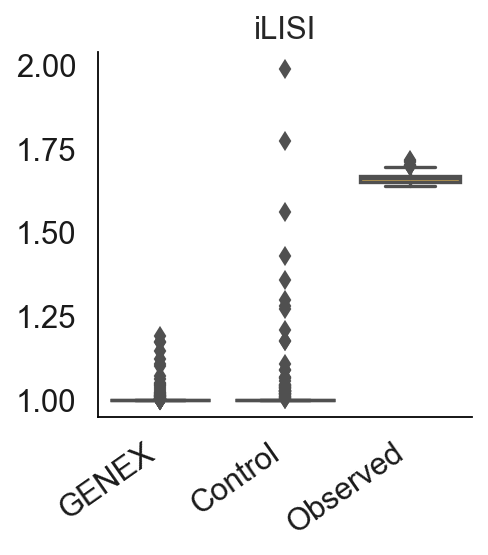

In [706]:
metric_data_df = pd.DataFrame(metric_data).transpose()

colors_list = cc.glasbey_hv

data = metric_data_df[["iLISI"]]
data = data.loc[["GENEX", "Control", "Observed"]]
data = data.explode("iLISI")
data.reset_index(inplace = True)
data.columns = ["model", "iLISI"]
data["iLISI"] = pd.to_numeric(data["iLISI"])
# data

# # create desirable order of the x axis

sns.boxplot(x = "model", y = "iLISI", data = data, palette = colors_list, orient = "v")

plt.grid(False)
plt.xlabel('')
plt.ylabel('')
plt.xticks(rotation = 35, ha = "right")
plt.title("iLISI")
sns.despine()

In [707]:
import rbo

def compute_rbo(adata_test_deg, full_adata, model_name, celltype):
    rbo_list = []
    
    # define the number of deg to test
    top_deg_num = [10, 20, 30, 40, 50]

    # adata_test_deg = adata_test_deg[adata_test_deg.obs["cell_type"] == celltype].copy()

    # print(adata_test_deg.obs.cell_type)
    # print(adata_test_deg[adata_test_deg.obs.condition.isin(["ctrl"])].X.shape)

    for top_num in top_deg_num:
        # get the ground truth DEGs
        observed_deg = get_deg(adata_test_deg, top = top_num)
    
        # get the DEGs from the predicted gene expressions
        adata_pred_deg = full_adata[full_adata.obs[target_obs_label].isin(["control", model_name])].copy()

        # subset to the given cell type for the DEGs
        # adata_pred_deg = adata_pred_deg[adata_pred_deg.obs["cell_type"] == celltype].copy()

        # print(adata_pred_deg[adata_pred_deg.obs.condition.isin(["ctrl"])].X.shape)

        # print(adata_pred_deg.obs.cell_type)
        adata_pred_deg.obs[target_obs_label].replace(model_name, str(target_label), inplace = True)
        adata_pred_deg.obs[target_obs_label] = adata_pred_deg.obs[target_obs_label].astype('category')

        pred_deg = get_deg(adata_pred_deg, "X_pred", top = top_num)
    
        rbo_score = round(rbo.RankingSimilarity(pred_deg, observed_deg).rbo(p=1.0), 4)
        rbo_list.append(rbo_score)

    return rbo_list

compute_rbo(adata_test_deg, full_adata, model_name = "GENEX", celltype = celltype_list[0])

/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero 

[0.8619, 0.7696, 0.7504, 0.7529, 0.7492]

In [708]:
from utils import venn4py

group_name = target_obs_label
groups = sorted(list(set(adata_test_deg.obs[group_name])))
# groups = sorted(list(set(adata_int.obs["Group"])))

groups

['192', 'control']

Cycling keratinocyte


/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Unique elements in Observed: {'ITGA6', 'RUNX1', 'SPINK6', 'SKIL', 'ACKR3', 'KIF20B', 'MISP', 'FTL', 'VCAN', 'AMIGO2', 'MRC2', 'TUBB', 'CCL20', 'TNFSF10', 'KIF3C', 'CALM1', 'CDC42EP3', 'MOB3B', 'KRT16', 'TIMP3', 'KLK5', 'PLSCR1', 'CRYAB', 'FSCN1', 'PHF20', 'TNFAIP8', 'TGFBR1', 'PLXDC2', 'ITGB5', 'CLDN7', 'SPSB1', 'CLEC16A', 'LTBP2', 'MT2A', 'ARHGAP32', 'TNFAIP2', 'IGFBP6', 'MDK', 'SAT1', 'ATP2C1', 'AMTN', 'PTPRM', 'SYNPO', 'SLC22A5', 'PXDC1', 'LSR', 'PTGS2', 'TUFT1', 'TP63', 'ZFHX3', 'FSTL1', 'SOD2', 'TPST1', 'ALOX5AP', 'NAV1', 'NEK2', 'LBH'}
Unique elements in GENEX: {'IL1A', 'MIR22HG', 'CUL4B', 'PTGES', 'IGFL1', 'ARL6IP1', 'SMC1A', 'PI3', 'HNRNPA2B1', 'IRF1', 'HTRA1', 'CDKN1C', 'MZT1', 'STK17A', 'MDM2', 'PDIA4', 'C15orf48', 'DAAM1', 'FAM213A', 'TMPO', 'PGM1', 'OTUD1', 'PCNA', 'SERPINB2', 'HSP90B1', 'TXNRD1', 'MAD2L1', 'POLH', 'MKI67', 'HMGA1', 'VANGL1', 'HERPUD1', 'NOP16', 'NFKBIA', 'DSC2', 'ALKBH5', 'IFI44L', 'CCND2', 'IGFBP3', 'LAMB1', 'IL6R', 'PHACTR3', 'PDP1', 'NDC1', 'LMO7', 'TNF

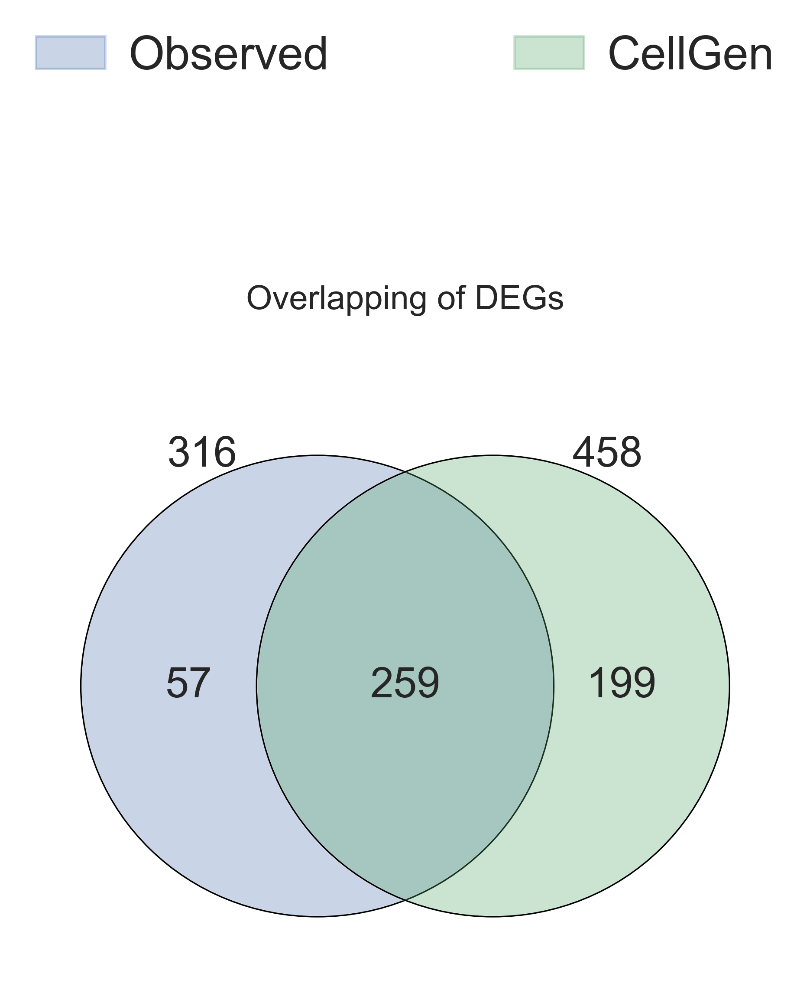

In [709]:
from matplotlib_venn import venn3, venn3_circles
from collections import defaultdict

celltype_index = 0
print(celltype_list[celltype_index])

def venn_diagrams(adata_test_deg, full_adata, model_name):
    
    # adata_test_deg = adata_test_deg[adata_test_deg.obs["cell_type"] == celltype].copy()

    # print(adata_test_deg.obs.cell_type)
    # print(adata_test_deg[adata_test_deg.obs.condition.isin(["ctrl"])].X.shape)
    # get the ground truth DEGs
    top_num = 2000
    observed_deg = get_deg(adata_test_deg, top = top_num)

    # print(observed_deg)

    # variable to store all the degs gene set
    deg_dict = {}

    deg_dict["Observed"] = set(observed_deg)
    
    for model in model_name:
        # get the DEGs from the predicted gene expressions
        adata_pred_deg = full_adata[full_adata.obs[target_obs_label].isin(["control", model])].copy()
    
        # subset to the given cell type for the DEGs
        # adata_pred_deg = adata_pred_deg[adata_pred_deg.obs["cell_type"] == celltype].copy()
        adata_pred_deg.obs[target_obs_label].replace(model, str(target_label), inplace = True)
        adata_pred_deg.obs[target_obs_label] = adata_pred_deg.obs[target_obs_label].astype('category')
        pred_deg = get_deg(adata_pred_deg, "X_pred", top = top_num)

        deg_dict[model] = set(pred_deg)

    sets = [set(deg_dict[key]) for key in deg_dict]

    # Create a dictionary to store element counts across sets
    element_counts = defaultdict(int)
    for elements in deg_dict.values():
        for element in elements:
            element_counts[element] += 1
    
    # Find elements unique to each set
    unique_elements = {key for key, value in element_counts.items() if value == 1}

    GENEX_uniq_set = {}
    
    # Print unique elements for each set
    for set_name, elements in deg_dict.items():
        unique_in_set = {element for element in unique_elements if element in elements} 
        if unique_in_set:
            print(f"Unique elements in {set_name}: {unique_in_set}")
            if set_name == "GENEX":
                GENEX_uniq_set = unique_in_set

    # print(deg_dict)
    
    deg_dict["CellGen"] = deg_dict.pop("GENEX")
    venn4py.venny4py(deg_dict, ext = "svg", size = 5.0)
    
    plt.title("Overlapping of DEGs")
    # plt.show()

    return list(GENEX_uniq_set)


GENEX_gene = venn_diagrams(adata_test_deg, full_adata, model_name = ["GENEX"])
plot_save_svg()
# GENEX_gene

## Pathway enrichment analysis for the non overlapping genes

In [710]:
import gseapy
from matplotlib.lines import Line2D 

In [711]:
def deg_geneset(adata_test_deg, full_adata, model_name):
    
    # adata_test_deg = adata_test_deg[adata_test_deg.obs["cell_type"] == celltype].copy()

    # print(adata_test_deg.obs.cell_type)
    # print(adata_test_deg[adata_test_deg.obs.condition.isin(["ctrl"])].X.shape)
    # get the ground truth DEGs
    top_num = 2000
    observed_deg = get_deg(adata_test_deg, top = top_num)

    # print(observed_deg)

    # variable to store all the degs gene set
    deg_dict = {}

    deg_dict["Observed"] = set(observed_deg)
    
    for model in model_name:
        # get the DEGs from the predicted gene expressions
        adata_pred_deg = full_adata[full_adata.obs[target_obs_label].isin(["control", model])].copy()
    
        # subset to the given cell type for the DEGs
        # adata_pred_deg = adata_pred_deg[adata_pred_deg.obs["cell_type"] == celltype].copy()
        adata_pred_deg.obs[target_obs_label].replace(model, str(target_label), inplace = True)
        adata_pred_deg.obs[target_obs_label] = adata_pred_deg.obs[target_obs_label].astype('category')
        pred_deg = get_deg(adata_pred_deg, "X_pred", top = top_num)

        deg_dict[model] = set(pred_deg)

    sets = [set(deg_dict[key]) for key in deg_dict]

    # Create a dictionary to store element counts across sets
    element_counts = defaultdict(int)
    for elements in deg_dict.values():
        for element in elements:
            element_counts[element] += 1
    
    # Find elements unique to each set
    unique_elements = {key for key, value in element_counts.items() if value == 1}

    GENEX_uniq_set = {}
    
    # Print unique elements for each set
    for set_name, elements in deg_dict.items():
        unique_in_set = {element for element in unique_elements if element in elements} 
        if unique_in_set:
            # print(f"Unique elements in {set_name}: {unique_in_set}")
            if set_name == "GENEX":
                GENEX_uniq_set = unique_in_set
            elif set_name == "Observed":
                observed_uniq_set = unique_in_set

    # print(deg_dict)
    return deg_dict, observed_uniq_set, GENEX_uniq_set

deg_dict, uniq_dict, GENEX_uniq_set = deg_geneset(adata_test_deg, full_adata, model_name = ["GENEX"])

/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/3819068628.py:15: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


/tmp/ipykernel_84595/713386629.py:30: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(all_data["Term"], fontsize=18)


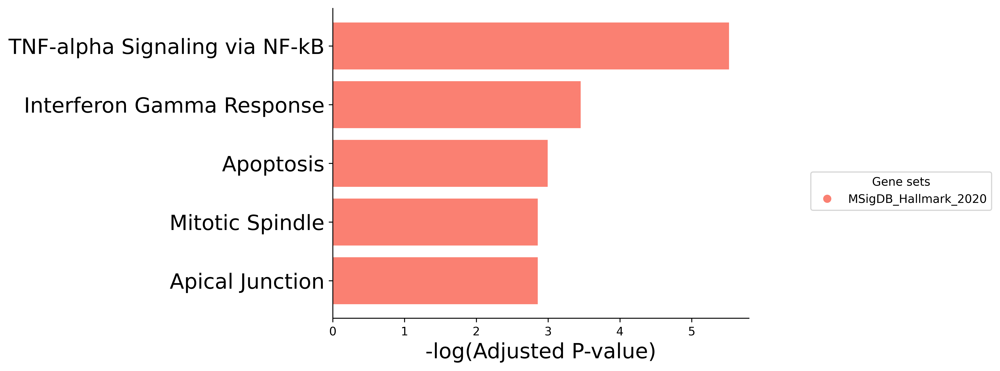

In [712]:
# gene sets
gene_sets = ['MSigDB_Hallmark_2020']

# enrichment analysis
enr_res = gseapy.enrichr(gene_list=list(uniq_dict),
                     organism='Human',
                     gene_sets=gene_sets,
                     # description='Ontologies',
                     cutoff = 0.5)

# changing the term and get the top 5
GO_BP = enr_res.results[enr_res.results["Gene_set"] == "MSigDB_Hallmark_2020"].head(5)

# concatenate
# all_data = pd.concat([GO_BP, GO_CC,KEGG]).sort_values("Adjusted P-value")
all_data = pd.concat([GO_BP]).sort_values("Adjusted P-value")

# plotting function
plt.rcdefaults()
fig, ax = plt.subplots(dpi = 300)

# colors = {"MSigDB_Hallmark_2020": "salmon", "Reactome_2022": "palegreen", "KEGG_2021_Human": "plum"}
colors = {"MSigDB_Hallmark_2020": "salmon"}

ax.barh(all_data["Term"], -np.log10(all_data["Adjusted P-value"]), align='center', color = all_data["Gene_set"].map(colors))
# ax.barh(GO_CC["Term"].str.split(" \(GO").str[0], -np.log10(GO_CC["Adjusted P-value"]), align='center', label = "GO:CC")
# ax.barh(KEGG["Term"], -np.log10(KEGG["Adjusted P-value"]), align='center', label = "KEGG")
ax.invert_yaxis()  # labels read top-to-bottom
ax.grid(False)
ax.set_yticklabels(all_data["Term"], fontsize=18)
ax.set_xlabel('-log(Adjusted P-value)', fontsize = 18)
axbox = ax.get_position()
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in colors.items()]
ax.legend(loc='center right', handles = handles, bbox_to_anchor=(axbox.x0 + axbox.width * 1.9, axbox.y0 + 0.3), title = "Gene sets")
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
# ax.spines['left'].set_visible(False)
# plt.show()
# plot_save_svg()

/tmp/ipykernel_84595/4284027705.py:30: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(all_data["Term"], fontsize=18)


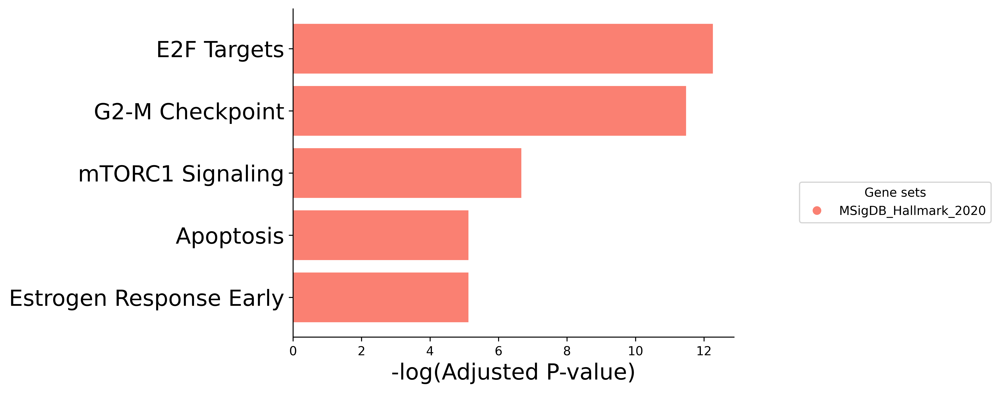

In [713]:
# gene sets
gene_sets = ['MSigDB_Hallmark_2020']

# enrichment analysis
enr_res = gseapy.enrichr(gene_list=list(GENEX_uniq_set),
                     organism='Human',
                     gene_sets=gene_sets,
                     # description='Ontologies',
                     cutoff = 0.5)

# changing the term and get the top 5
GO_BP = enr_res.results[enr_res.results["Gene_set"] == "MSigDB_Hallmark_2020"].head(5)

# concatenate
# all_data = pd.concat([GO_BP, GO_CC,KEGG]).sort_values("Adjusted P-value")
all_data = pd.concat([GO_BP]).sort_values("Adjusted P-value")

# plotting function
plt.rcdefaults()
fig, ax = plt.subplots(dpi = 300)

# colors = {"MSigDB_Hallmark_2020": "salmon", "Reactome_2022": "palegreen", "KEGG_2021_Human": "plum"}
colors = {"MSigDB_Hallmark_2020": "salmon"}

ax.barh(all_data["Term"], -np.log10(all_data["Adjusted P-value"]), align='center', color = all_data["Gene_set"].map(colors))
# ax.barh(GO_CC["Term"].str.split(" \(GO").str[0], -np.log10(GO_CC["Adjusted P-value"]), align='center', label = "GO:CC")
# ax.barh(KEGG["Term"], -np.log10(KEGG["Adjusted P-value"]), align='center', label = "KEGG")
ax.invert_yaxis()  # labels read top-to-bottom
ax.grid(False)
ax.set_yticklabels(all_data["Term"], fontsize=18)
ax.set_xlabel('-log(Adjusted P-value)', fontsize = 18)
axbox = ax.get_position()
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in colors.items()]
ax.legend(loc='center right', handles = handles, bbox_to_anchor=(axbox.x0 + axbox.width * 1.9, axbox.y0 + 0.3), title = "Gene sets")
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
# ax.spines['left'].set_visible(False)
plt.show()

## Checking the trajectory of the 3 different type of cluster and how are have they change and move

In [714]:
def get_fc(adata_test_deg, layer_name = "X_raw"):

    '''
    layer_name must be either X_raw or X_pred
    '''
    adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
    
    # uncomment for raw data degs
    adata_test_deg.obsm[f'{layer_name}_pca'] = adata_test_deg.layers[layer_name] @ pca_matrix.T
    sc.tl.dendrogram(adata_test_deg, use_rep = f'{layer_name}_pca', groupby = group_name, optimal_ordering=False)
    
    group_index = 1
    adata_test_deg.X = adata_test_deg.layers[layer_name]
    adata_test_deg.X[adata_test_deg.X < 1] = 0
    adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
    sc.tl.rank_genes_groups(adata_test_deg, group_name, method='wilcoxon', use_raw = False, corr_method='benjamini-hochberg', layer = layer_name, pts = True)

    deg_fc = compute_logfc(adata_test_deg, groups[group_index], group_name, layer_name)

    
    deg_df = sc.get.rank_genes_groups_df(adata_test_deg, group = groups[group_index], key='rank_genes_groups')
    deg_df.set_index("names", inplace = True)
    # deg_df = deg_df.loc[genes]
    deg_df["logfoldchanges"] = deg_fc

    # filter only the significant gene
    deg_df = deg_df[(deg_df["pvals_adj"] < 0.05)]

    # sort based on the logfoldchange
    # filtered_deg = deg_df.sort_values("logfoldchanges", ascending = False)
    
    # foldchange_values = list(deg_df["logfoldchanges"].values)

    # we want to get all the logfoldchange for all the gene
    return deg_df

In [715]:
target_label

192

In [716]:
full_adata.obs[target_obs_label]

0-0-0           GENEX
1-0-0           GENEX
2-0-0           GENEX
3-0-0           GENEX
4-0-0           GENEX
               ...   
V242_T7-1    observed
V244_T7-1    observed
V246_T7-1    observed
V249_T7-1    observed
V250_T7-1    observed
Name: Condition (Hour), Length: 1080, dtype: category
Categories (4, object): ['192', 'GENEX', 'control', 'observed']

In [717]:
sns.set_theme(style="whitegrid")

sc.settings.verbosity = 1

sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')

/tmp/ipykernel_84595/636740465.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/636740465.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


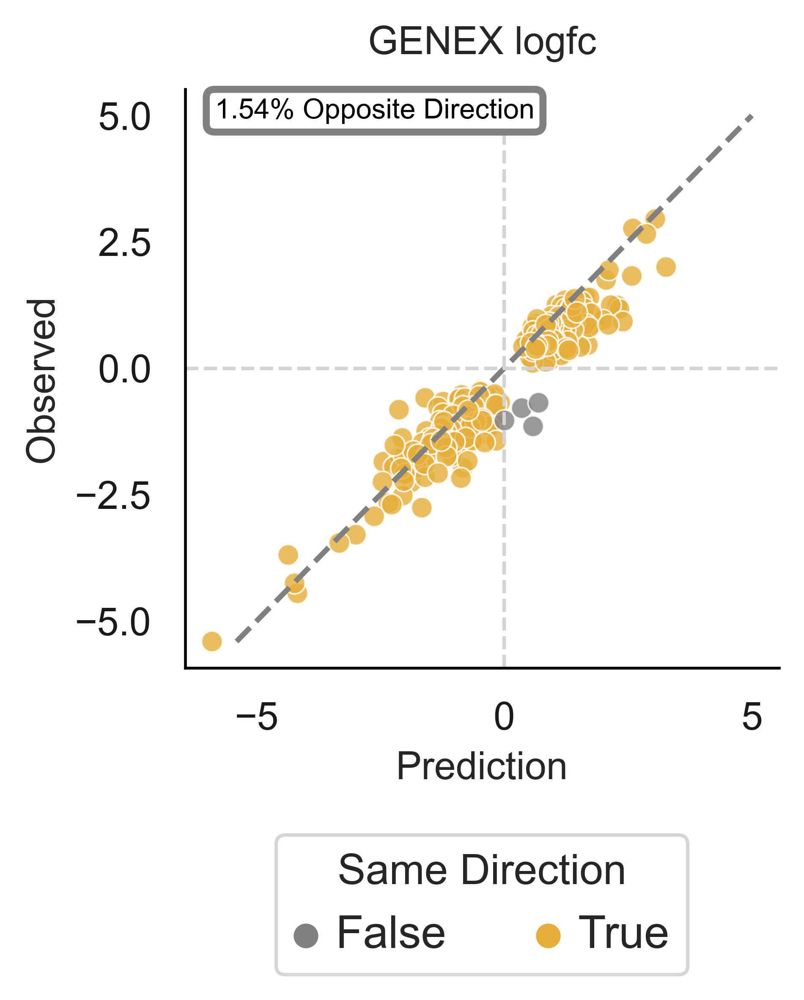

In [718]:
# print(celltype_list[celltype_index])

def logfc_plot(adata_test_deg, full_adata, model_name, celltype):
    
    # adata_test_deg_sub = adata_test_deg[adata_test_deg.obs["cell_type"] == celltype].copy()
    adata_test_deg_sub = adata_test_deg.copy()

    observed_df = get_fc(adata_test_deg_sub)

    # print(observed_fc)

    # print(len(observed_fc))

    for model in model_name:
        adata_pred = full_adata[(full_adata.obs[target_obs_label].isin(["control", model]))].copy()
        # adata_pred = adata_pred[adata_pred.obs["cell_type"] == celltype].copy()

        # print(adata_pred)
        adata_pred.obs[target_obs_label].replace(model, str(target_label), inplace = True)
        adata_pred.obs["target_obs_label"] = adata_pred.obs[target_obs_label].astype('category')

        pred_df = get_fc(adata_pred)

        common_df = pd.merge(observed_df, pred_df, left_index=True, right_index=True, suffixes=('', '_2'))

        observed_fc = common_df["logfoldchanges"].values
        pred_fc = common_df["logfoldchanges_2"].values

        # Create a mask for top right and bottom left quadrants
        mask_top_right = np.logical_and(np.array(observed_fc) >= 0, np.array(pred_fc) >= 0)
        mask_bottom_left = np.logical_and(np.array(observed_fc) < 0, np.array(pred_fc) < 0)

        combine_mask = np.logical_or(mask_top_right, mask_bottom_left)

        data = {"observed": observed_fc, "prediction": pred_fc, "direction" : combine_mask}
        sns.scatterplot(x = "prediction", y = "observed", hue = "direction", palette={False: 'grey', True: colors_list[2]} , data = data, alpha = 0.8, color = colors_list[2])
        plt.plot([min(observed_fc), 5], [min(observed_fc), 5], color="grey", linestyle='--')
        plt.grid(False)
        sns.despine()
        plt.title(model + " logfc", pad = 10, fontsize = 11)
        # Add horizontal and vertical lines at 0
        plt.axhline(0, color='lightgrey', linestyle='--', linewidth=1)
        plt.axvline(0, color='lightgrey', linestyle='--', linewidth=1)
        plt.legend(title = "Same Direction", loc="upper center", bbox_to_anchor = (0.5, -0.25), ncols = 2, fancybox=True)

        # adding the percentage of opposite direction of the log fold change
        # Compute the percentage of False values (opposite directions of logfoldchange)
        # percentage_false = np.mean(~combine_mask) * 100

        percentage_false = 100 - ((sum(combine_mask) / len(combine_mask)) * 100)
        
        # Annotate the percentage of False values
        plt.annotate(f'{percentage_false:.2f}% Opposite Direction', xy=(0.05, 0.95), xycoords='axes fraction', fontsize=8, color='black', bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="grey", lw=2))
        plt.xlabel("Prediction", fontsize = 11)
        plt.ylabel("Observed", fontsize = 11)
        plt.xticks(fontsize = 11)
        plt.yticks(fontsize = 11)
        # plt.show()

logfc_plot(adata_test_deg, full_adata, ["GENEX"], celltype_list[celltype_index])
plot_save_svg()

In [719]:
def get_deg_metric(adata_test_deg, layer_name = "X_raw", genes = []):

    '''
    layer_name must be either X_raw or X_pred
    '''
    adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
    
    # uncomment for raw data degs
    adata_test_deg.obsm[f'{layer_name}_pca'] = adata_test_deg.layers[layer_name] @ pca_matrix.T
    sc.tl.dendrogram(adata_test_deg, use_rep = f'{layer_name}_pca', groupby = group_name, optimal_ordering=False)
    
    group_index = 0
    adata_test_deg.X = adata_test_deg.layers[layer_name]
    adata_test_deg.X[adata_test_deg.X < 1] = 0
    adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
    sc.tl.rank_genes_groups(adata_test_deg, group_name, method='wilcoxon', use_raw = False, corr_method='benjamini-hochberg', layer = layer_name, pts = True)
    # raw_deg = sc.get.rank_genes_groups_df(adata_test_deg, group = groups[group_index], pval_cutoff=1.0, key='rank_genes_groups')["names"]

    deg_fc = compute_logfc(adata_test_deg, groups[group_index], group_name, layer_name).loc[genes]

    deg_df = sc.get.rank_genes_groups_df(adata_test_deg, group = groups[group_index], key='rank_genes_groups')
    deg_df.set_index("names", inplace = True)
    deg_df = deg_df.loc[genes]
    deg_df["logfoldchanges"] = deg_fc

    # filtered_deg = deg_fc.sort_values("logfc", ascending = False)
    # print(deg_df)

    return deg_df

In [720]:
def get_deg_metric_data(adata_test_deg, full_adata, model_name, model_genes = [], celltype = None):

    # init the matrix to turn the data
    p_values_matrix = []
    logfc_matrix = []
    pct_nz_group_matrix = []
    method_list = ["Observed"] + model_name

    # adata_test_deg = adata_test_deg[adata_test_deg.obs["cell_type"] == celltype].copy()
    print(adata_test_deg)
    
    for gene in model_genes:
    
        # obtain the deg for the observed data
        observed_deg = get_deg_metric(adata_test_deg, genes = list(model_genes))

        # init list of data holder & append the data
        p_values_list = []
        logfc_list = []
        pct_nz_group_list = []
    
        logfc_list.append(observed_deg["logfoldchanges"][gene])
        # p_values_list.append(1 - observed_deg["pvals_adj"][gene])
        if observed_deg["pvals_adj"][gene] < 0.05:
            p_values_list.append("Significant")
        else:
            p_values_list.append("Not Significant")
        pct_nz_group_list.append(observed_deg["pct_nz_group"][gene])
    
        # iterate through each model passed
        for model in model_name:
            # get the DEGs from the predicted gene expressions
            adata_pred_deg = full_adata[full_adata.obs[target_obs_label].isin(["control", model])].copy()
            
            # subset to the given cell type for the DEGs
            # adata_pred_deg = adata_pred_deg[adata_pred_deg.obs["cell_type"] == celltype].copy()
            
            adata_pred_deg.obs[target_obs_label].replace(model, str(target_label), inplace = True)
            adata_pred_deg.obs[target_obs_label] = adata_pred_deg.obs[target_obs_label].astype('category')
            
            pred_deg = get_deg_metric(adata_pred_deg, "X_pred", genes = list(model_genes))
    
            logfc_list.append(pred_deg["logfoldchanges"][gene])
            # p_values_list.append(1 - pred_deg["pvals_adj"][gene])
            if pred_deg["pvals_adj"][gene] < 0.05:
                p_values_list.append("Significant")
            else:
                p_values_list.append("Not Significant")
                
            pct_nz_group_list.append(pred_deg["pct_nz_group"][gene])

        print(p_values_list)
        p_values_matrix.append(p_values_list)
        logfc_matrix.append(logfc_list)
        pct_nz_group_matrix.append(pct_nz_group_list)

    return np.array(p_values_matrix), np.array(logfc_matrix), method_list, pct_nz_group_matrix

p_values_matrix, logfc_matrix, model_list, pct_nz_group_matrix = get_deg_metric_data(adata_test_deg, full_adata, model_name = ["GENEX"], model_genes = GENEX_gene)

AnnData object with n_obs × n_vars = 540 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'leiden 0', 'batch'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'dendrogram_Condition (Hour)', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'X_raw_pca'
    layers: 'X_raw'


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/tmp/ipykernel_84595/1176653006.py:14: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scipy/sparse/_index.py:145: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


['Not Significant', 'Significant']


In [721]:
# p_values_matrix

In [722]:
# logfc_matrix

In [723]:
# convert matrix into long data type
plot_data = pd.DataFrame(columns = ["methods", "genes", "logfc", "pval_adj", "Fraction of cells in group val"])

for i in range(len(GENEX_gene)):
    for j in range(len(model_list)):
        # Data to append
        data_to_append = pd.DataFrame({'methods': [model_list[j]], 'genes': [GENEX_gene[i]], 'logfc':[logfc_matrix[i][j]], 'pval_adj':[p_values_matrix[i][j]],
                                      'Fraction of cells in group val': pct_nz_group_matrix[i][j]})
        
        # Append data to the DataFrame
        plot_data = pd.concat([plot_data, data_to_append], ignore_index=True)

print(plot_data)

      methods    genes   logfc         pval_adj  \
0    Observed     IL1A -0.2802  Not Significant   
1       GENEX     IL1A -0.7750      Significant   
2    Observed  MIR22HG  0.5838  Not Significant   
3       GENEX  MIR22HG -0.5623      Significant   
4    Observed    CUL4B  0.1544  Not Significant   
..        ...      ...     ...              ...   
393     GENEX   FAM89A -0.4202      Significant   
394  Observed    ACTG1  0.3958  Not Significant   
395     GENEX    ACTG1  1.8386      Significant   
396  Observed   BCL11A  0.2562  Not Significant   
397     GENEX   BCL11A -0.4368      Significant   

     Fraction of cells in group val  
0                          0.078313  
1                          0.000000  
2                          0.198795  
3                          0.000000  
4                          0.174699  
..                              ...  
393                        0.000000  
394                        0.891566  
395                        0.994652  
396    

In [724]:
plot_data["Fraction of cells in group"] = pd.cut(plot_data['Fraction of cells in group val'], bins=[-1.0, 0.5, 0.7, 0.8, 0.9, 1.0], labels=['0.0', '0.5', '0.75', '0.9', '1.0'])
# plot_data["logfc"] = pd.cut(plot_data['logfc'], bins=4)
plot_data

,methods,genes,logfc,pval_adj,Fraction of cells in group val,Fraction of cells in group
0,Observed,IL1A,-0.2802,Not Significant,0.078313,0.0
1,GENEX,IL1A,-0.7750,Significant,0.000000,0.0
2,Observed,MIR22HG,0.5838,Not Significant,0.198795,0.0
3,GENEX,MIR22HG,-0.5623,Significant,0.000000,0.0
4,Observed,CUL4B,0.1544,Not Significant,0.174699,0.0
...,...,...,...,...,...,...
393,GENEX,FAM89A,-0.4202,Significant,0.000000,0.0
394,Observed,ACTG1,0.3958,Not Significant,0.891566,0.9
395,GENEX,ACTG1,1.8386,Significant,0.994652,1.0
396,Observed,BCL11A,0.2562,Not Significant,0.156627,0.0


In [725]:
# GENEX_gene

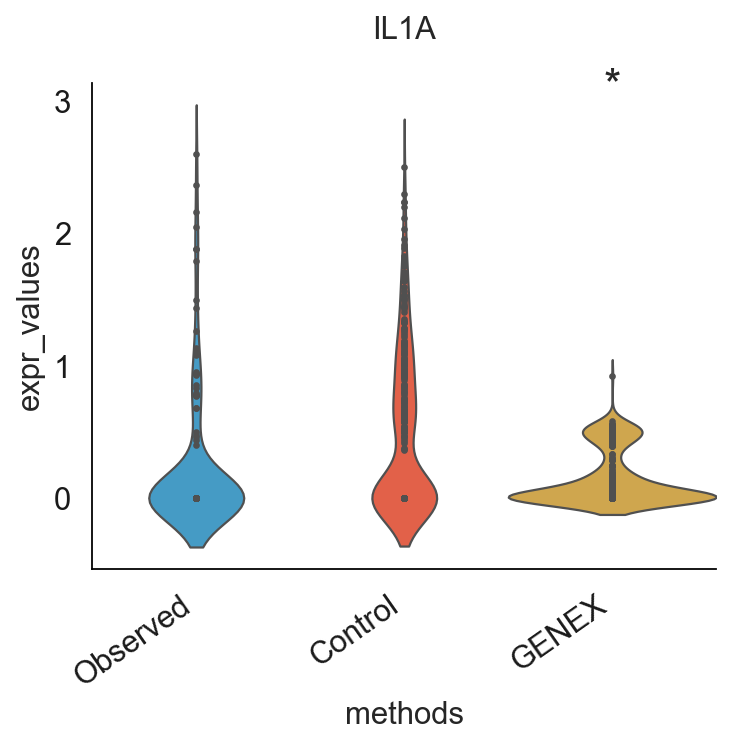

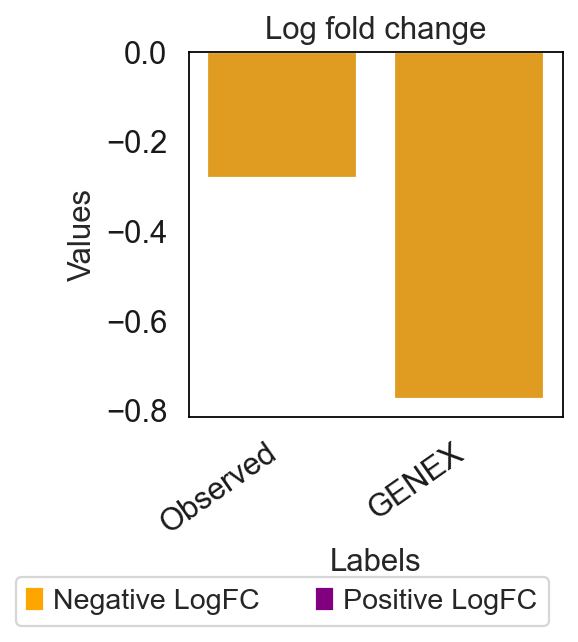

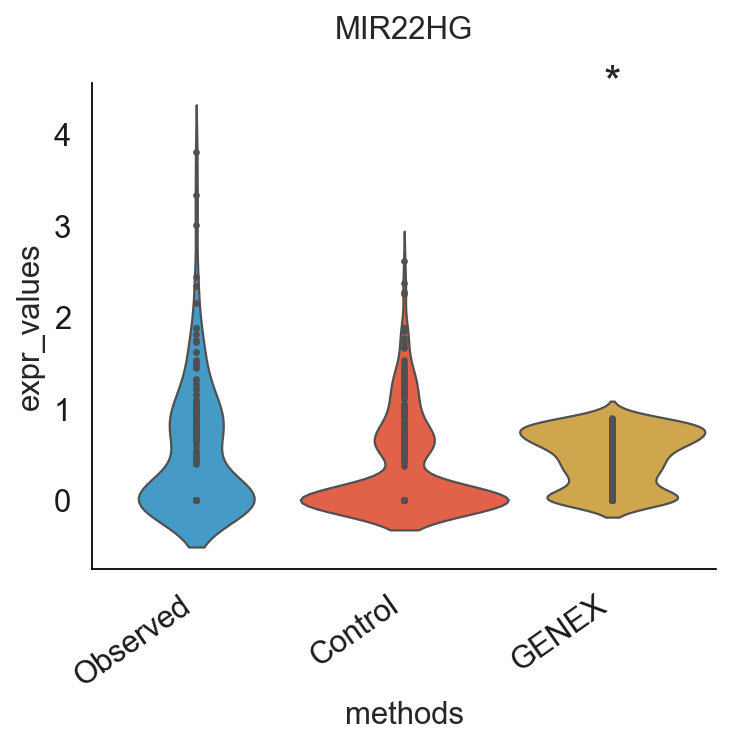

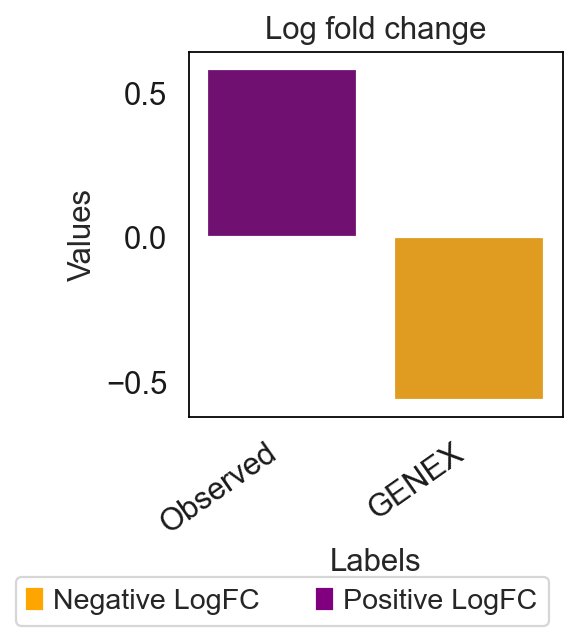

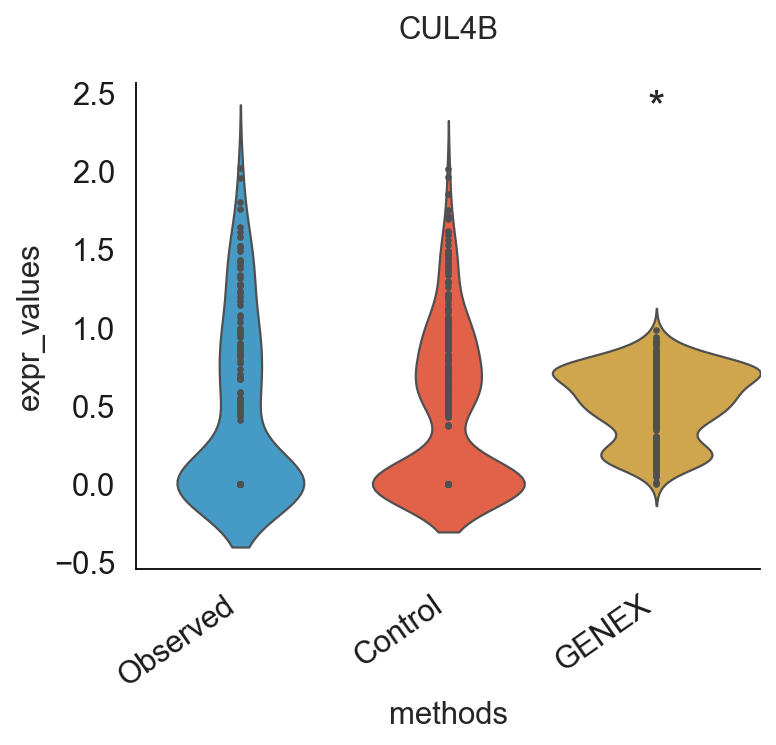

...

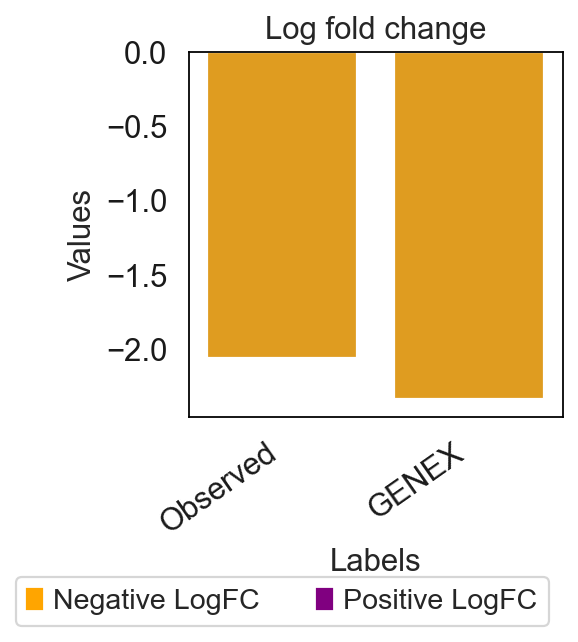

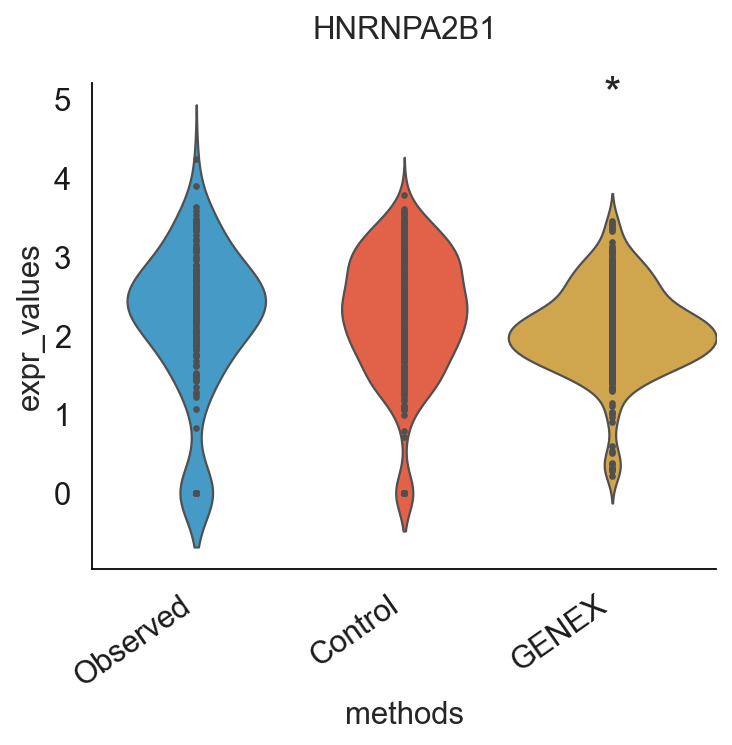

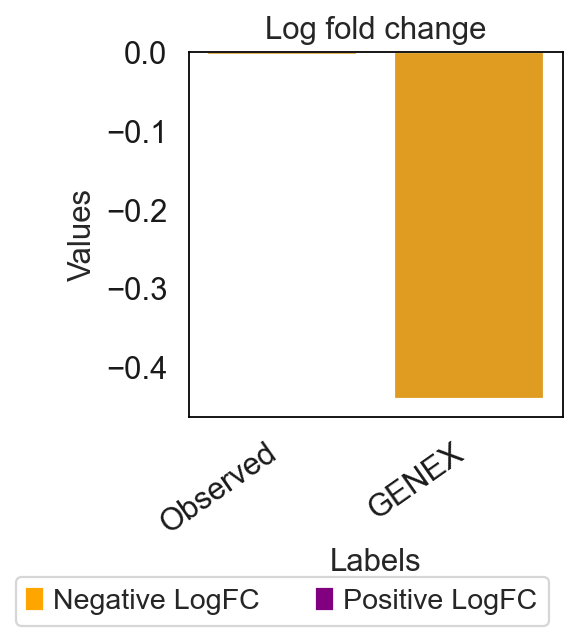

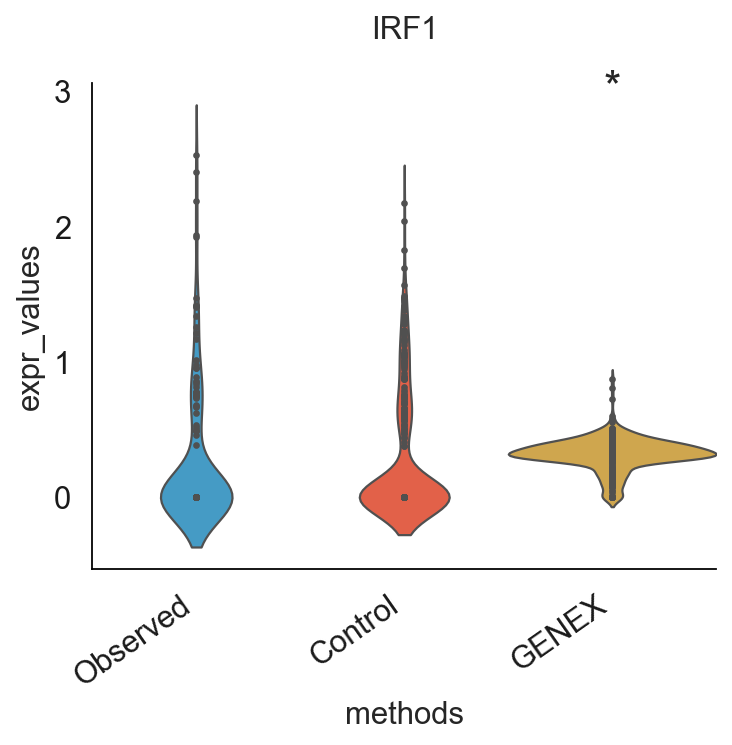

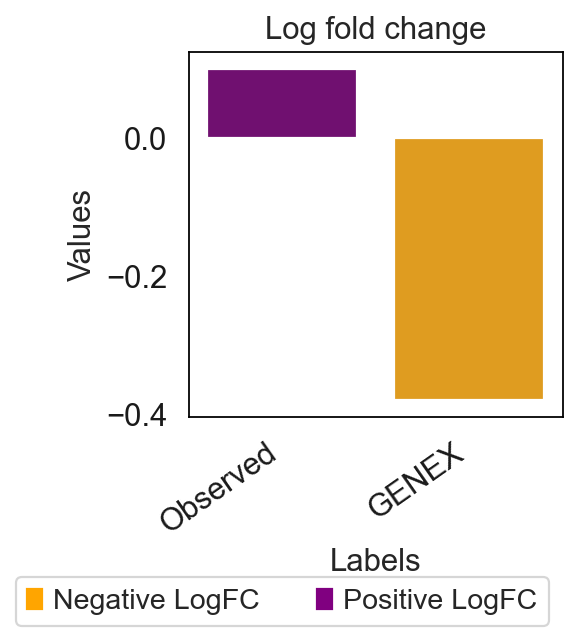

In [726]:
counter = 0

for gene in GENEX_gene:
    # subset to gene
    expr_data = plot_data[plot_data["genes"] == gene].copy()

    control_data = {"methods": "Control", "genes": gene, "logfc": 0.0, "pval_adj":"Not Significant", "Fraction of cells in group val" : 1.0, "Fraction of cells in group": 1.0}
    expr_data = pd.concat([expr_data, pd.DataFrame([control_data])], ignore_index=True)
    # print(expr_data)
    significant_list = list(expr_data["pval_adj"].values)
    significant_list.insert(1, "Not Significant")

    # obtain gene expression for all the model
    adata_gene = full_adata[:, gene].copy()

    # define list of item
    expr_list = []
    expr_list.append(list(adata_gene[adata_gene.obs[target_obs_label] == "observed"].X.toarray().copy().round(4).reshape(-1)))
    expr_list.append(list(adata_gene[adata_gene.obs[target_obs_label] == "GENEX"].X.toarray().copy().round(4).reshape(-1)))
    # expr_list.append(list(adata_gene[adata_gene.obs.condition == "scGen"].X.copy().round(4).reshape(-1)))
    # expr_list.append(list(adata_gene[adata_gene.obs.condition == "CellOT"].X.copy().round(4).reshape(-1)))
    # expr_list.append(list(adata_gene[adata_gene.obs.condition == "Biolord"].X.copy().round(4).reshape(-1)))
    expr_list.append(list(adata_gene[adata_gene.obs[target_obs_label] == "control"].X.copy().toarray().round(4).reshape(-1)))

    expr_data["expr_values"] = expr_list

    expr_data = expr_data.explode("expr_values")
    expr_data["expr_values"] = pd.to_numeric(expr_data["expr_values"])

    # Create violin plot
    plt.figure(figsize=(5, 4))
    sns.violinplot(x='methods', order = ["Observed", "Control", "GENEX"], y='expr_values', fill = False, data=expr_data, width = 1, linewidth=1,
                  inner="point", density_norm="count", palette = colors_list)
    
    # Add significance annotation
    # For example, let's annotate the first and third bars as significant
    # You need to replace these indices with your own significant indices
    offset = 1.25
    
    for i in range(len(significant_list)):
        if significant_list[i] == "Significant":
            plt.text(i, max(expr_data["expr_values"]) * offset, '*', ha='center', va='top', fontsize=20)

    
    plt.xticks(rotation = 35, ha = "right")
    plt.title(gene, pad = 20)
    plt.grid(False)
    sns.despine()
    # Show plot
    plt.show()

    barplot_data = plot_data[plot_data["genes"] == gene].copy()

    sns.barplot(x='methods', y='logfc', data=barplot_data,
                palette=['orange' if val < 0 else 'purple' for val in barplot_data["logfc"]])
    plt.xlabel('Labels')
    plt.ylabel('Values')
    plt.grid(False)
    plt.xticks(rotation = 35, ha = "right")
    # Add legend for the bar colors
    plt.legend(handles=[plt.Rectangle((0,0),1,1, color='orange', label='Negative LogFC'),
                        plt.Rectangle((0,0),1,1, color='purple', label='Positive LogFC')],
               loc='upper right', bbox_to_anchor = (1,-0.4), ncol = 2)
    plt.title('Log fold change')
    plt.show()

    counter += 1
    
    if counter == 10:
        break


/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


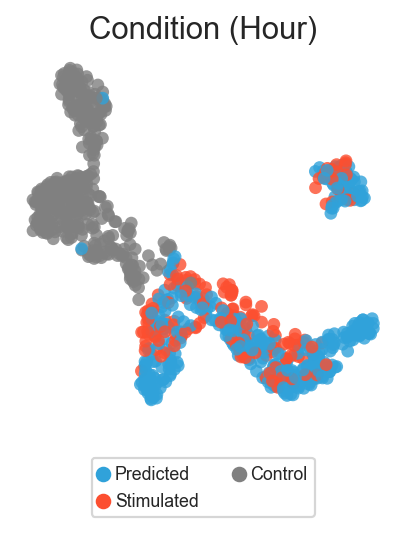

In [727]:
# model to plot
model_name = "GENEX"

model_list = [str(target_label), model_name, "control"]
plot_adata = full_adata[full_adata.obs[target_obs_label].isin(model_list)].copy()

sc.pp.neighbors(plot_adata, use_rep='X_pca', n_neighbors=30)
# sc.external.pp.bbknn(adata_all, batch_key='batch', use_rep='X_latent')
sc.tl.umap(plot_adata, random_state = 0)

# comment it out for raw data
plot_adata.obs[target_obs_label].replace(model_name, "Predicted", inplace = True)
plot_adata.obs[target_obs_label].replace(str(target_label), "Stimulated", inplace = True)
plot_adata.obs[target_obs_label].replace("control", "Control", inplace = True)
plot_adata.obs[target_obs_label] = plot_adata.obs[target_obs_label].astype("category")

desired_order = ["Predicted", "Stimulated", "Control"]
plot_adata.obs[target_obs_label] = plot_adata.obs[target_obs_label].cat.reorder_categories(desired_order)

# random ordering to better see the mixing and seperation of the cells.
custom_palette = cc.glasbey_hv

customed_color = custom_palette[:2]
customed_color.append("grey")

setup_seed(8)
random_indices=np.random.permutation(list(range(plot_adata.shape[0])))
sc.pl.umap(plot_adata[random_indices, :], color=[target_obs_label], alpha = 0.8, legend_fontsize = 9, return_fig = True,
           palette=customed_color)

# plot_adata.obs[target_obs_label] = plot_adata.obs[target_obs_label].cat.reorder_categories(desired_order)

plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.3), fontsize = 8, ncol = 2)
plot_save_svg()

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


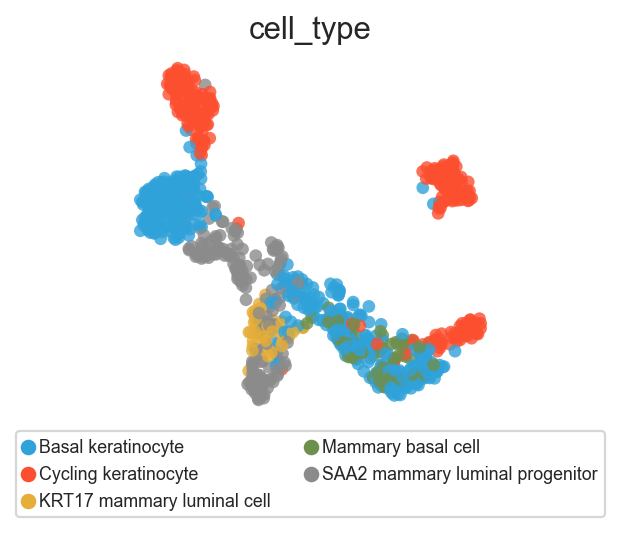

In [728]:
sc.pl.umap(plot_adata[random_indices, :], color=["cell_type"], alpha = 0.8, legend_fontsize = 9, return_fig = True,
           palette=custom_palette)

plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.3), fontsize = 8, ncol = 2)

In [729]:
adata_test.obs["cell_type"]

V19_T7     Cycling keratinocyte
V22_T7       Mammary basal cell
V24_T7       Mammary basal cell
V26_T7       Mammary basal cell
V30_T7     Cycling keratinocyte
                   ...         
V242_T7      Basal keratinocyte
V244_T7      Basal keratinocyte
V246_T7      Basal keratinocyte
V249_T7      Basal keratinocyte
V250_T7      Basal keratinocyte
Name: cell_type, Length: 166, dtype: category
Categories (4, object): ['Basal keratinocyte', 'Cycling keratinocyte', 'KRT17 mammary luminal cell', 'Mammary basal cell']

## Time series analysis

### Check for the marker gene of the dataset

In [730]:
full_dataset = adata.concatenate(adata_test).copy()
full_dataset

AnnData object with n_obs × n_vars = 1749 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'batch', 'batch_num'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'X_pca', 'X_umap'

/tmp/ipykernel_84595/198952951.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr


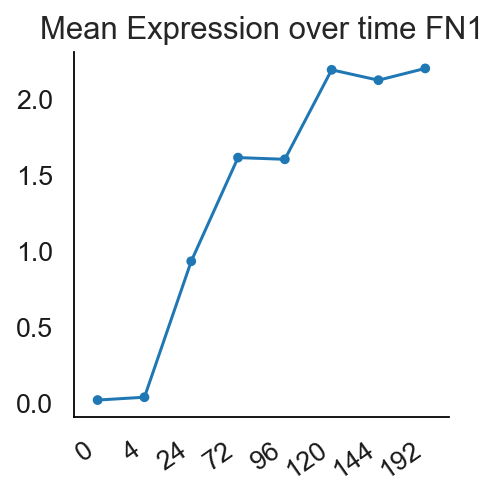

/tmp/ipykernel_84595/198952951.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr


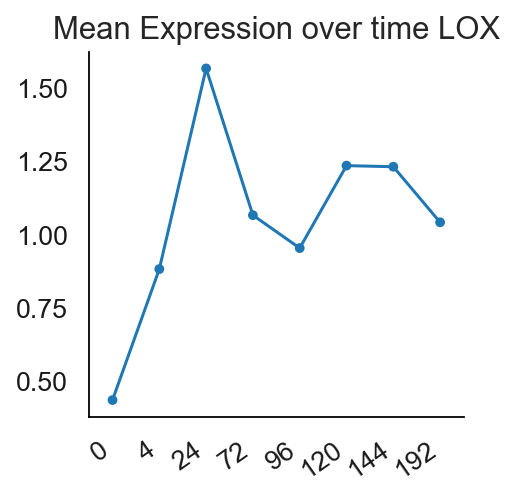

/tmp/ipykernel_84595/198952951.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr


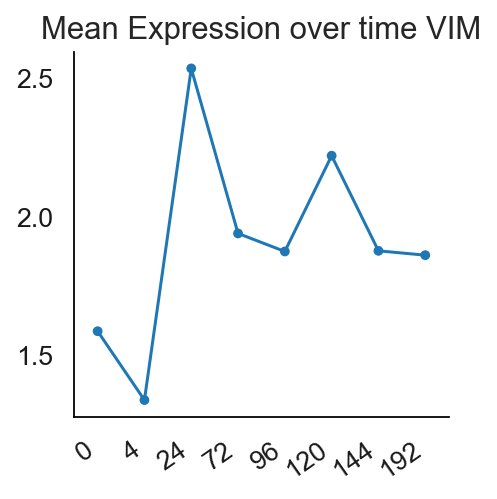

In [731]:
# Epithelial: CDH1, EPCAM, KRT14, MUC1
# Mesenchymal: FAP, FN1, LOX, VIM

colors_list = cc.glasbey_hv

epi_markers = ["EPCAM", "KRT14", "MUC1"]
mesenchymal = ["FN1", "LOX", "VIM"]

# check the mean expression over time for each of the 
for gene_name in mesenchymal:

    # gene_name = "EPCAM"
    gene_adata = full_dataset[:, gene_name].copy()
    
    df_gene = gene_adata.obs[[target_obs_label]]
    gene_expr = gene_adata.X.toarray()
    
    df_gene["expression"] = gene_expr
    
    df_gene_group = df_gene.groupby(target_obs_label).mean()
    df_gene_group.reset_index(inplace = True)
    
    data = df_gene_group
    
    sns.pointplot(x = target_obs_label, y = "expression", data = data, scale = 0.5)
    
    plt.grid(False)
    plt.xlabel('')
    plt.ylabel('')
    plt.yticks(fontsize = 12)
    plt.xticks(rotation = 35, ha = "right", fontsize = 12)
    plt.title("Mean Expression over time %s" % (gene_name), fontsize = 14)
    # plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.8), fontsize = 8, ncol = 4)
    sns.despine()
    plt.show()

## UMAP of all the time point for ground truth vs prediction

In [732]:
sns.set_theme(style="whitegrid")

sc.settings.verbosity = 1

sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')

In [733]:
# appoint the starting point of the prediction
start_adata = control_test.copy()
full_pred_adata = start_adata.copy()

full_dataset = adata.concatenate(adata_test).copy()
full_dataset

AnnData object with n_obs × n_vars = 1749 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'batch', 'batch_num'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    obsm: 'X_pca', 'X_umap'

In [734]:
# generate prediction based on the target tensor by reading the weight for each of the masked training
def GENEX_prediction(test_data, target_tensor):
    # test_data is the control cells and shall be in array format
    # predicting section
    print(int(target_tensor[0][0].cpu().detach().numpy()))
    
    G_AB.eval()
    
    with torch.no_grad():
        imgs = Variable(FloatTensor(test_data)).to(device_ids[0])
        src_labels = Variable(target_tensor).to(device_ids[0])
        static_sample = generate_data(G_AB, imgs, src_labels).cpu().detach().numpy()
    return static_sample

In [735]:
time_point_list = sorted(full_dataset.obs[target_obs_label].unique().tolist())[1:]
time_point_list

[4, 24, 72, 96, 120, 144, 192]

In [736]:
for time in time_point_list:
    # create a stack target label
    batch_size = test_data.shape[0]
    target_array = [time] * batch_size
    target_tensor = FloatTensor(target_array).unsqueeze(1)

    # get the gene expression for each of the label except for the control
    pred_gene_expr = GENEX_prediction(test_data.toarray(), target_tensor)

    pred_obs = control_test.obs[["leiden"]].copy()

    # creating the metadata for control cells
    data = np.array(["Predicted %s" % (time)])
    repeated_data = np.tile(data[np.newaxis, :], (batch_size, 1))
    pred_obs[target_obs_label] = repeated_data

    # assemble as anndata
    pred_time = AnnData(
        X=pred_gene_expr,
        obs=pred_obs
    )

    # reassign back the gene variable
    pred_time.var = control_test.var

    # concatenate as a prediction data to see the trajectory
    full_pred_adata = full_pred_adata.concatenate(pred_time)

# for reproducibility
setup_seed(8)

# Create PCA object and fit it to the data
pca = PCA(n_components=50)
pca.fit(full_pred_adata.X.toarray())

pca_matrix_pred = pca.components_

X_pca = full_pred_adata.X @ pca_matrix_pred.T
full_pred_adata.obsm["X_pca"] = X_pca.copy()

sc.pp.neighbors(full_pred_adata, use_rep='X_pca', n_neighbors=30)

# sc.external.pp.bbknn(adata_all, batch_key='batch', use_rep='X_latent')
sc.tl.umap(full_pred_adata)

custom_palette = cc.glasbey_hv

# sc.pl.umap(full_pred_adata, color=["cell_type"], wspace = 0.5,
#            palette=custom_palette)
random_indices=np.random.permutation(list(range(full_pred_adata.shape[0])))

# correct the order of the data
desired_order = ["control"] + ["Predicted %s" % (each) for each in time_point_list]
full_pred_adata.obs[target_obs_label] = full_pred_adata.obs[target_obs_label].astype("str").astype("category").cat.reorder_categories(desired_order)

4
24
72
96
120
144
192


/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


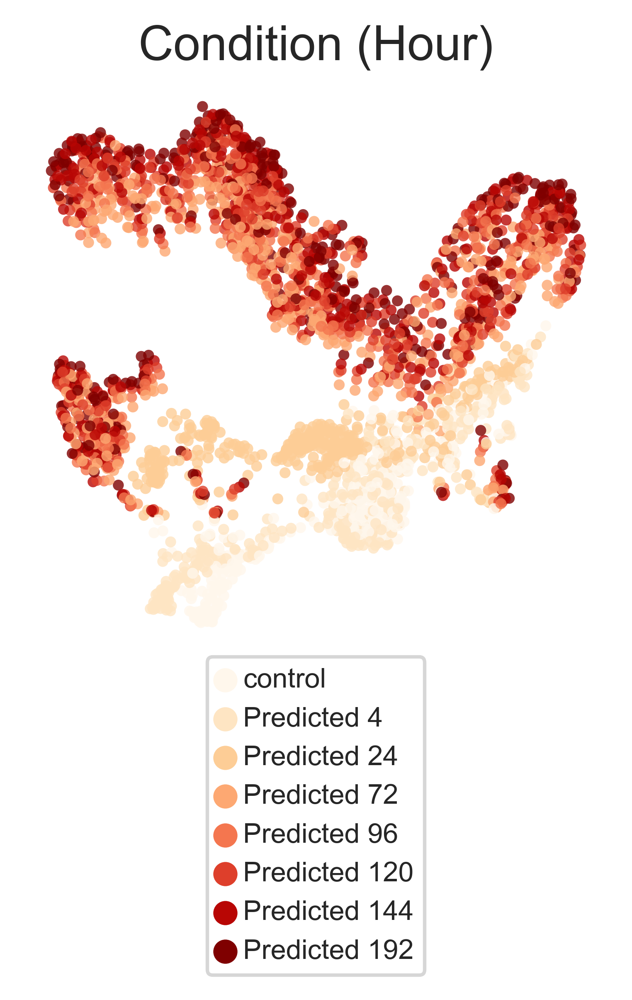

In [737]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm 
import scipy.stats as st

fig, ax = plt.subplots(figsize=(3, 3))

ax = sc.pl.umap(full_pred_adata[random_indices, :], color=[target_obs_label], alpha = 0.8, legend_fontsize = 9, show=False,
       palette="OrRd", ax = ax)

plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.6), fontsize = 8, ncol = 1)
plot_save_svg()

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


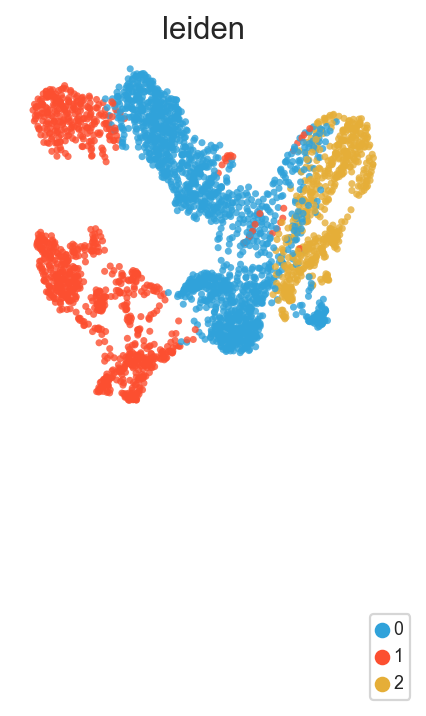

In [738]:
fig, ax = plt.subplots(figsize=(3, 3))

ax = sc.pl.umap(full_pred_adata, color=["leiden"], alpha = 0.8, palette = custom_palette, show = False, ax = ax)
plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
plot_save_svg()

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


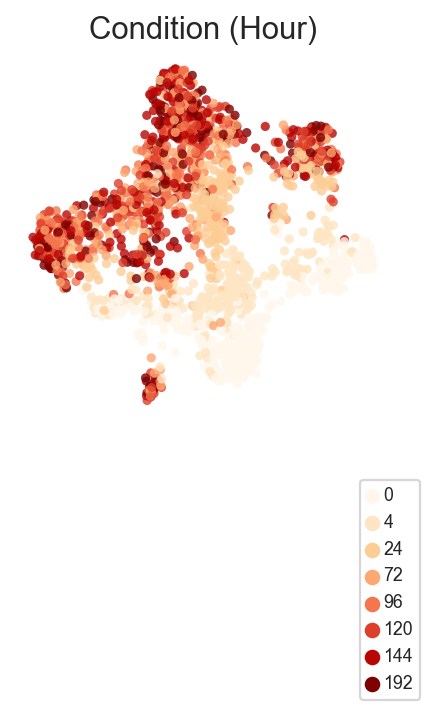

In [252]:
full_dataset.obs[target_obs_label] = full_dataset.obs[target_obs_label].astype("str").astype("category")
full_dataset.obs[target_obs_label] = full_dataset.obs[target_obs_label].cat.reorder_categories(["0"] + ["4", "24", "72", "96", "120", "144", "192"])

# Visualize
fig, ax = plt.subplots(figsize=(3, 3))
random_indices=np.random.permutation(list(range(full_dataset.shape[0])))
ax = sc.pl.umap(full_dataset[random_indices,:], color=target_obs_label, alpha = 0.8, show = False, edgecolor='w', linewidth=0.0, palette="OrRd", sort_order = False, ax = ax)
plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
plot_save_svg()

## DecoupleR

In [253]:
import scanpy as sc
import pandas as pd
import seaborn as sns
sns.set_theme(style="whitegrid")

# verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.verbosity = 1

sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')


In [254]:
import decoupler as dc

In [255]:
MSigDB = dc.get_resource("MSigDB", organism="human")

In [256]:
# subset to hallmark collection only
MSigDB_Hallmark = MSigDB[MSigDB["collection"] == "hallmark"]
MSigDB_Hallmark

,genesymbol,collection,geneset
233,MAFF,hallmark,HALLMARK_IL2_STAT5_SIGNALING
250,MAFF,hallmark,HALLMARK_COAGULATION
270,MAFF,hallmark,HALLMARK_HYPOXIA
373,MAFF,hallmark,HALLMARK_TNFA_SIGNALING_VIA_NFKB
377,MAFF,hallmark,HALLMARK_COMPLEMENT
...,...,...,...
1449668,STXBP1,hallmark,HALLMARK_PANCREAS_BETA_CELLS
1450315,ELP4,hallmark,HALLMARK_PANCREAS_BETA_CELLS
1450526,GCG,hallmark,HALLMARK_PANCREAS_BETA_CELLS
1450731,PCSK2,hallmark,HALLMARK_PANCREAS_BETA_CELLS


In [257]:
# Remove duplicated entries
markers = MSigDB_Hallmark[~MSigDB_Hallmark.duplicated(['geneset', 'genesymbol'])]
markers

,genesymbol,collection,geneset
233,MAFF,hallmark,HALLMARK_IL2_STAT5_SIGNALING
250,MAFF,hallmark,HALLMARK_COAGULATION
270,MAFF,hallmark,HALLMARK_HYPOXIA
373,MAFF,hallmark,HALLMARK_TNFA_SIGNALING_VIA_NFKB
377,MAFF,hallmark,HALLMARK_COMPLEMENT
...,...,...,...
1449668,STXBP1,hallmark,HALLMARK_PANCREAS_BETA_CELLS
1450315,ELP4,hallmark,HALLMARK_PANCREAS_BETA_CELLS
1450526,GCG,hallmark,HALLMARK_PANCREAS_BETA_CELLS
1450731,PCSK2,hallmark,HALLMARK_PANCREAS_BETA_CELLS


In [258]:
dc.run_ora(
    mat=full_pred_adata,
    net=markers,
    source='geneset',
    target='genesymbol',
    min_n=3,
    verbose=True,
    use_raw=False
)

acts = dc.get_acts(full_pred_adata, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

184 features of mat are empty, they will be removed.
Running ora on mat with 2992 samples and 1816 targets for 50 sources.


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2992/2992 [00:03<00:00, 939.99it/s]


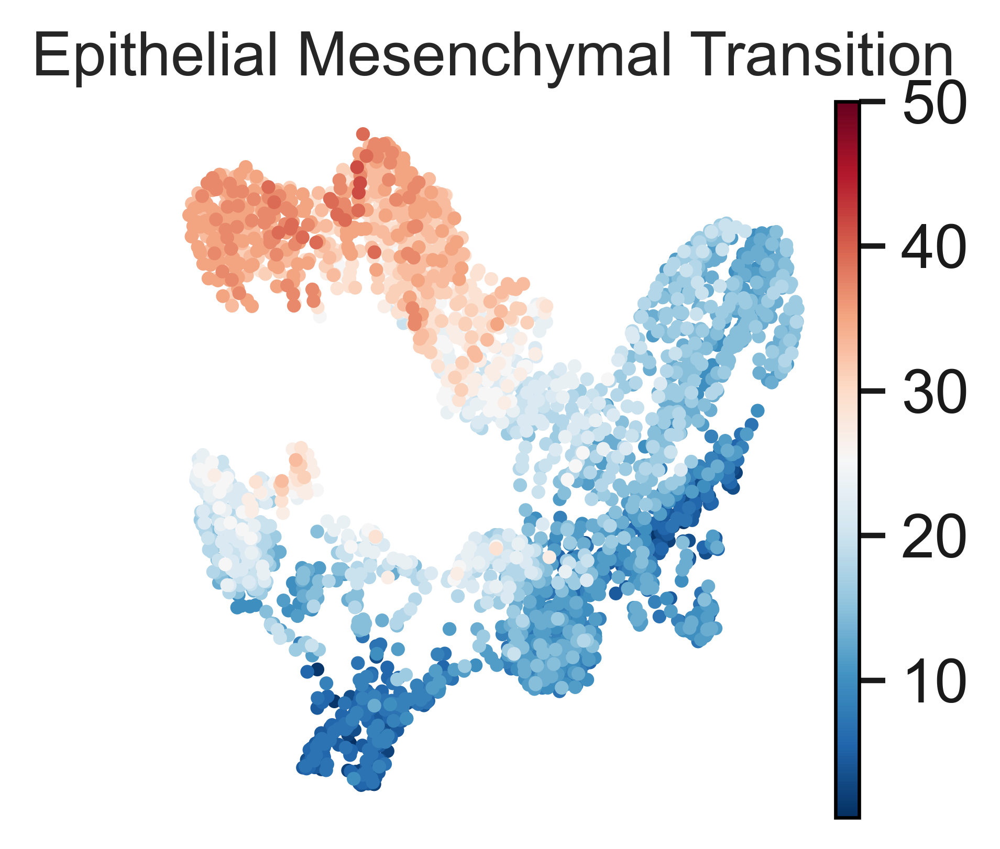

In [259]:
target_geneset = "HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION"

acts.obs[target_obs_label] = acts.obs[target_obs_label].astype("str").astype("category")

acts_arranged_label = ["control"] + ["Predicted %s" % (each) for each in time_point_list]

# acts.obs[target_obs_label] = acts.obs[target_obs_label].cat.reorder_categories(acts_arranged_label)

fig, ax = plt.subplots(figsize=(3, 3))

ax = sc.pl.umap(acts, color=[target_geneset], cmap='RdBu_r', show = False, vmax = 50, ax = ax)
plt.title("Epithelial Mesenchymal Transition")
plot_save_svg()

In [260]:
# random_indices=np.random.permutation(list(range(full_pred_adata.shape[0])))

# sc.pl.umap(full_pred_adata[random_indices, :], color=["cell_type"], alpha = 0.8, legend_fontsize = 9, return_fig = True,
#            palette=custom_palette)

# plt.legend(loc = "lower center", bbox_to_anchor=(0.5, -0.3), fontsize = 8, ncol = 2)

## UMAP of the predicted UMAP

In [739]:
full_pred_adata.obs[target_obs_label] = full_pred_adata.obs[target_obs_label].cat.reorder_categories(acts_arranged_label)

ValueError: items in new_categories are not the same as in old categories

In [740]:
full_pred_adata.obs[target_obs_label]

V4_T0-0-0-0-0-0-0-0           control
V7_T0-0-0-0-0-0-0-0           control
V9_T0-0-0-0-0-0-0-0           control
V10_T0-0-0-0-0-0-0-0          control
V12_T0-0-0-0-0-0-0-0          control
                            ...      
V379_T0-1               Predicted 192
V380_T0-1               Predicted 192
V381_T0-1               Predicted 192
V382_T0-1               Predicted 192
V383_T0-1               Predicted 192
Name: Condition (Hour), Length: 2992, dtype: category
Categories (8, object): ['control', 'Predicted 4', 'Predicted 24', 'Predicted 72', 'Predicted 96', 'Predicted 120', 'Predicted 144', 'Predicted 192']

In [741]:
from IPython.display import display, HTML

/tmp/ipykernel_84595/2619838912.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr
/tmp/ipykernel_84595/2619838912.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr
/tmp/ipykernel_84595/2619838912.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/use

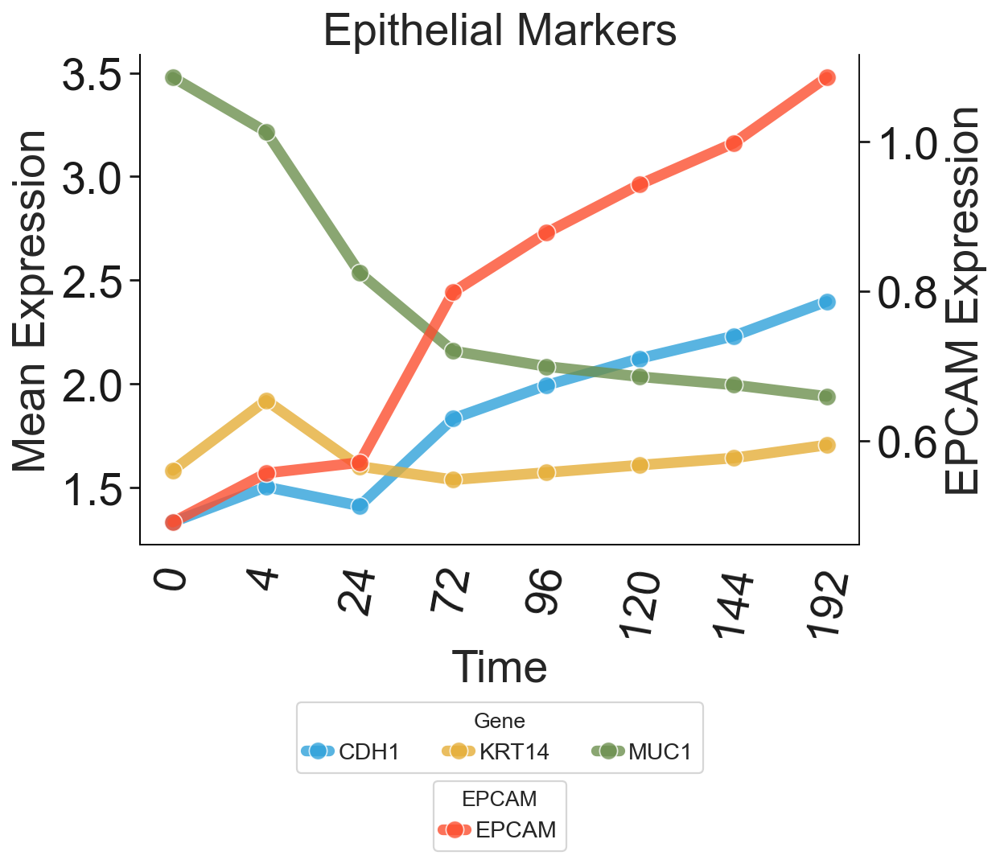

In [751]:
# Epithelial: CDH1, EPCAM, KRT14, MUC1
# Mesenchymal: FAP, FN1, LOX, VIM
import matplotlib.ticker as ticker 
colors_list = cc.glasbey_hv

epi_markers = ["CDH1", "EPCAM", "KRT14", "MUC1"]
mesenchymal = ["FAP", "FN1", "LOX", "VIM"]

# Function to get marker gene expression and plot
def get_marker_gene_expr(full_dataset, markers, title):
    num_markers = len(markers)
    num_cols = 4
    num_rows = (num_markers + 1) // num_cols

    fig, ax1 = plt.subplots(figsize=(8, 8))

    if "EPCAM" in markers:
        ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    for idx, gene_name in enumerate(markers):
        gene_adata = full_dataset[:, gene_name].copy()
        df_gene = gene_adata.obs[[target_obs_label]]
        gene_expr = gene_adata.X.toarray()
        df_gene["expression"] = gene_expr
        df_gene_group = df_gene.groupby(target_obs_label).mean()
        df_gene_group.reset_index(inplace=True)
        data = df_gene_group
        data[target_obs_label] = ["0"] + ["%s" % (x) for x in time_point_list]

        if gene_name == "EPCAM":
            sns.lineplot(
                x=target_obs_label, 
                y="expression", 
                data=data, 
                marker='o', 
                linewidth=6, 
                alpha=0.8, 
                markersize=10, 
                ax=ax2,  # plot EPCAM on the secondary y-axis
                label=gene_name,
                color=colors_list[idx % len(colors_list)]
            )
        else:
            sns.lineplot(
                x=target_obs_label, 
                y="expression", 
                data=data, 
                marker='o', 
                linewidth=6, 
                alpha=0.8, 
                markersize=10, 
                ax=ax1,
                label=gene_name,
                color=colors_list[idx % len(colors_list)]
            )

    ax1.grid(False)
    ax1.set_xlabel('Time', fontsize=25)
    ax1.set_ylabel('Mean Expression', fontsize=25)
    ax1.tick_params(axis='y', labelsize=25)
    ax1.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.1f'))
    ax1.tick_params(axis='x', rotation=80, labelsize=25)
    ax1.set_title(title, fontsize=25)
    ax1.legend(title='Gene', loc='upper center', bbox_to_anchor=(0.5, -0.3), ncol=4, handlelength=1)

    if "EPCAM" in markers:
        ax2.set_ylabel('EPCAM Expression', fontsize=25)
        ax2.tick_params(axis='y', labelsize=25)
        ax2.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.1f'))
        ax2.legend(title='EPCAM', loc='upper center',  bbox_to_anchor=(0.5, -0.46), handlelength=1)  # Move EPCAM legend to the right side
        sns.despine(ax=ax2, left=False)
        
    sns.despine(ax=ax1, right=False)
    
    plt.tight_layout()

    # output_filename
    output_filename = "combined_plot_single.svg"
    
    plt.grid(False)
    # plt.show()
    plt.savefig(output_filename, format='svg')
    display(HTML(f'<a href="{output_filename}" download>Download {output_filename}</a>'))

# Call the function for epithelial and mesenchymal markers
get_marker_gene_expr(full_pred_adata[full_pred_adata.obs["leiden"] == "2"], epi_markers, "Epithelial Markers")

/tmp/ipykernel_84595/2619838912.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr
/tmp/ipykernel_84595/2619838912.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr
/tmp/ipykernel_84595/2619838912.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/use

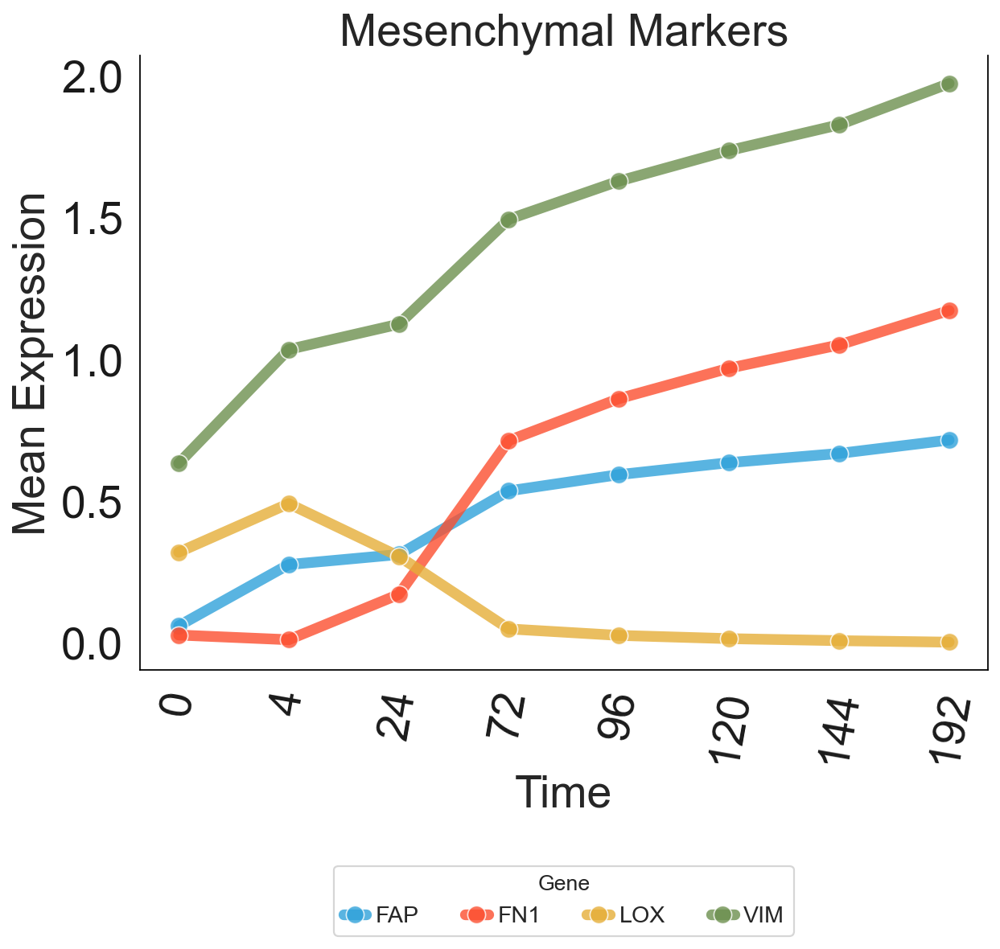

In [754]:
get_marker_gene_expr(full_pred_adata[full_pred_adata.obs["leiden"] == "2"], mesenchymal, "Mesenchymal Markers")

## Raw Dataset

In [545]:
full_dataset.obs[target_obs_label] = full_dataset.obs[target_obs_label].astype("str").astype("category")
full_dataset.obs[target_obs_label] = full_dataset.obs[target_obs_label].cat.reorder_categories(["0"] + ["%s" % (x) for x in time_point_list])

In [546]:
full_dataset.obs[target_obs_label]

V19_T2-0      24
V20_T2-0      24
V22_T2-0      24
V24_T2-0      24
V25_T2-0      24
            ... 
V242_T7-1    192
V244_T7-1    192
V246_T7-1    192
V249_T7-1    192
V250_T7-1    192
Name: Condition (Hour), Length: 1749, dtype: category
Categories (8, object): ['0', '4', '24', '72', '96', '120', '144', '192']

/tmp/ipykernel_84595/861882165.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr
/tmp/ipykernel_84595/861882165.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr
/tmp/ipykernel_84595/861882165.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_g

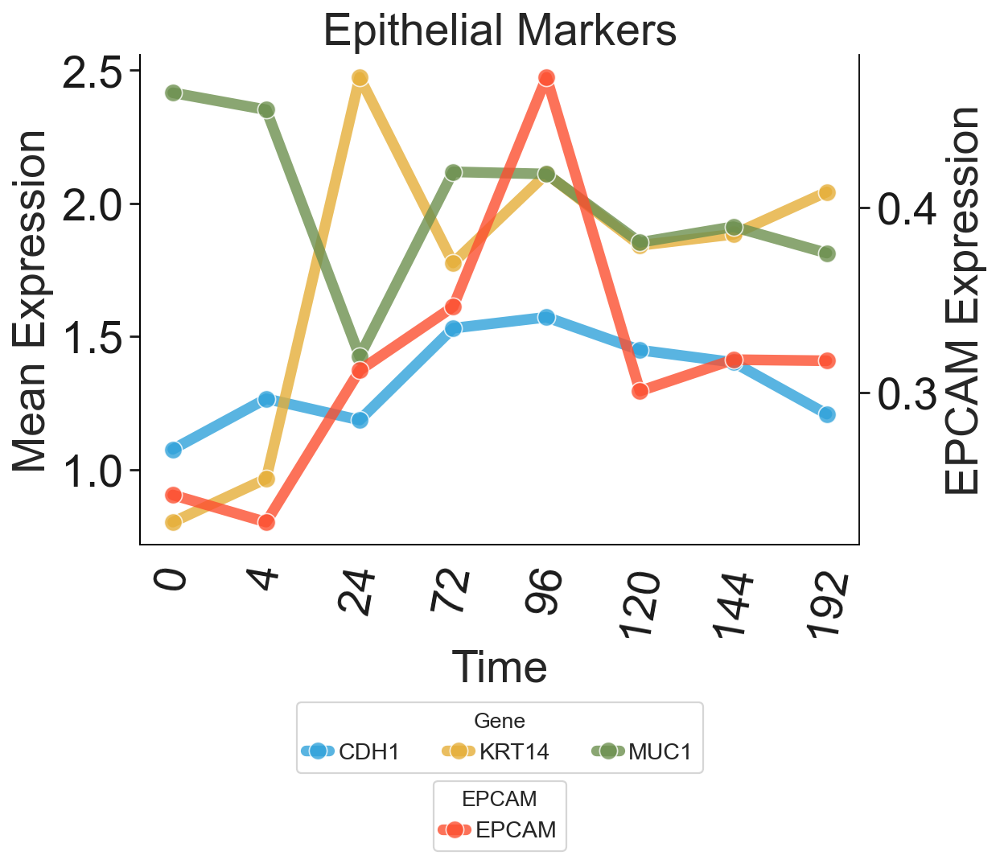

In [549]:
get_marker_gene_expr(full_dataset, epi_markers, "Epithelial Markers")

/tmp/ipykernel_84595/861882165.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr
/tmp/ipykernel_84595/861882165.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_gene["expression"] = gene_expr
/tmp/ipykernel_84595/861882165.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_g

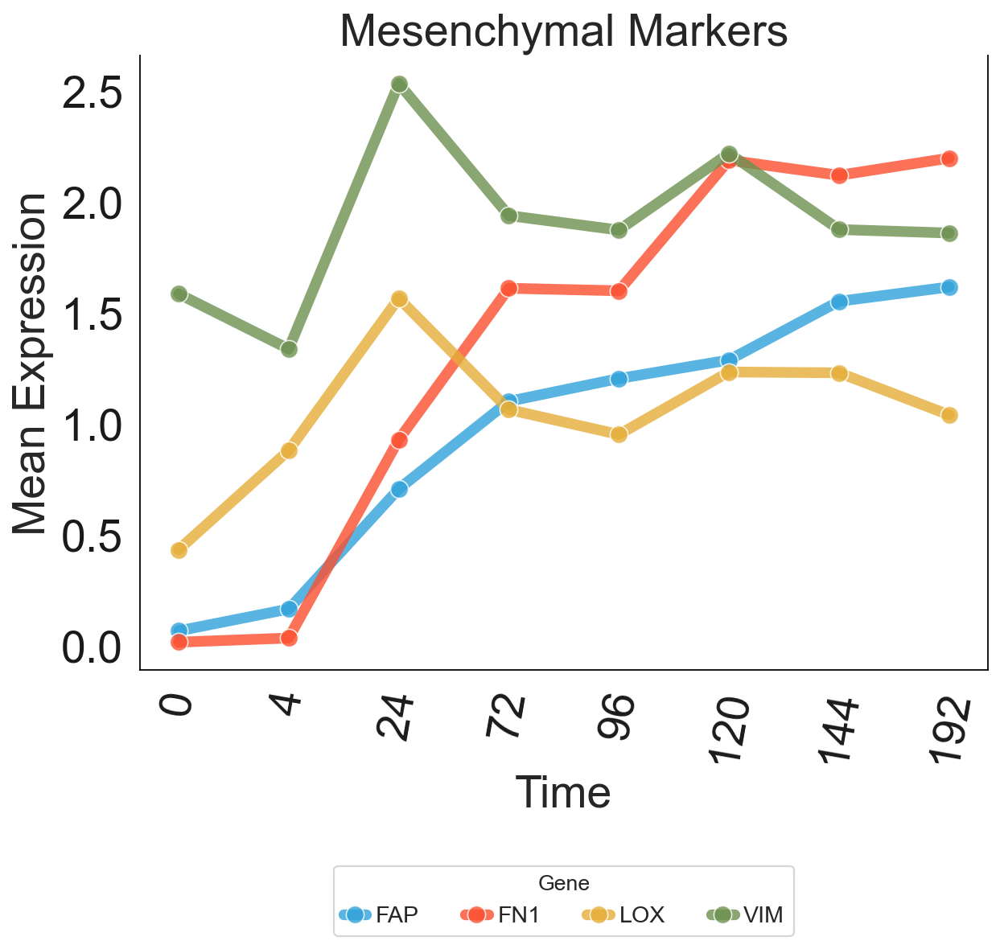

In [550]:
get_marker_gene_expr(full_dataset, mesenchymal, "Mesenchymal Markers")

## Geneset enrichment

In [551]:
import decoupler as dc

In [552]:
MSigDB = dc.get_resource("MSigDB", organism="human")

In [553]:
# subset to hallmark collection only
MSigDB_Hallmark = MSigDB[MSigDB["collection"] == "hallmark"]

# Remove duplicated entries
markers = MSigDB_Hallmark[~MSigDB_Hallmark.duplicated(['geneset', 'genesymbol'])]

In [554]:
dc.run_ora(
    mat=full_dataset,
    net=markers,
    source='geneset',
    target='genesymbol',
    min_n=3,
    verbose=True,
    use_raw=False
)

acts = dc.get_acts(full_dataset, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

Running ora on mat with 1749 samples and 2000 targets for 50 sources.


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1749/1749 [00:01<00:00, 981.80it/s]


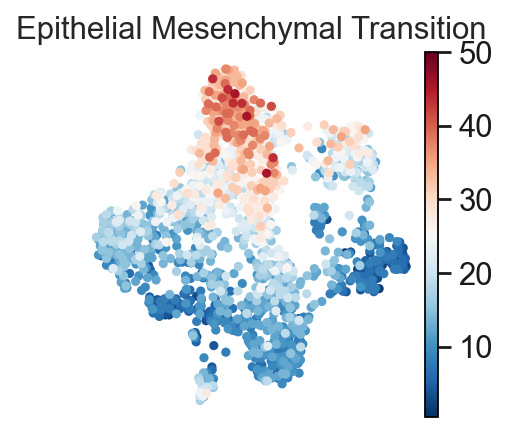

In [555]:
target_geneset = "HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION"

acts.obs[target_obs_label] = acts.obs[target_obs_label].astype("str").astype("category")

acts_arranged_label = ["0"] + ["%s" % (each) for each in time_point_list]

# acts.obs[target_obs_label] = acts.obs[target_obs_label].cat.reorder_categories(acts_arranged_label)
fig, ax = plt.subplots(figsize=(3, 3))

ax = sc.pl.umap(acts, color=[target_geneset], cmap='RdBu_r', show = False, vmax = 50, ax = ax)
plt.title("Epithelial Mesenchymal Transition")
# plt.show()
plot_save_svg()

In [556]:
# print(grouped_geneset_df[top_columns])

In [557]:
import scanpy as sc
import pandas as pd
import seaborn as sns
sns.set_theme(style="whitegrid")

# verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.verbosity = 1

sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')

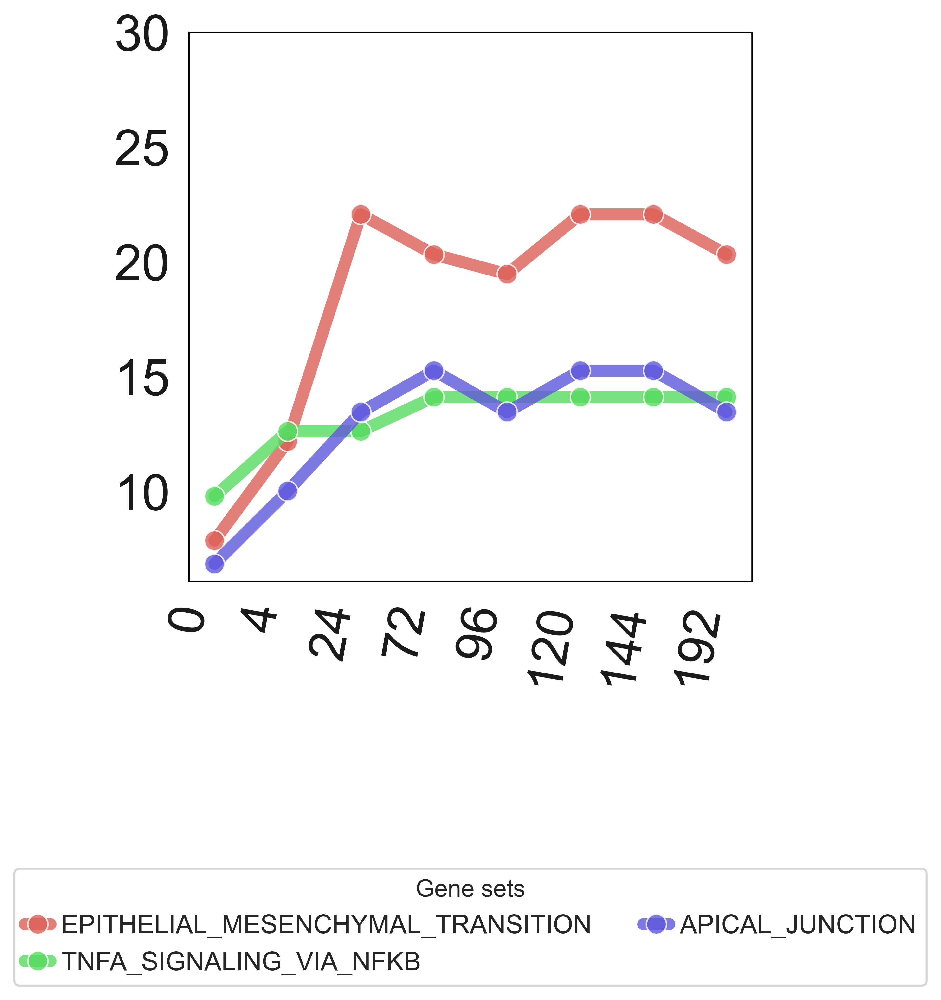

In [561]:
# Geneset enrichment line plot

geneset_df = pd.DataFrame(acts.X, columns = [x[9:] for x in list(acts.var.index)])
geneset_df["time point"] = np.array(acts.obs[target_obs_label])

grouped_geneset_df = geneset_df.groupby(["time point"]).median()
grouped_geneset_df

averages = grouped_geneset_df.mean()

# Identify the top 3 columns based on their average values
top_columns = averages.nlargest(3).index
top_columns

# Set the size of the plot
plt.figure(figsize=(5, 5))

# Define a color palette
palette = sns.color_palette("hls", n_colors=len(top_columns))

df_gene_group = grouped_geneset_df[top_columns]

arranged_label = ["0"] + ["%s" % (each) for each in time_point_list]

df_gene_group = df_gene_group.loc[arranged_label]

df_gene_group.reset_index(inplace = True)

# Create the line plot for the top 3 columns with the specified color palette
for i, column in enumerate(top_columns):
    sns.lineplot(data=df_gene_group, x = "time point", y = column, marker='o', label=column, color=palette[i], linewidth=6, alpha = 0.8, markersize=10)
    
plt.grid(False)
plt.ylabel("")
plt.ylim(None, 30)
plt.yticks(fontsize = 25)
plt.xlabel("")
plt.xticks(rotation=80, ha = 'right', fontsize = 25)
# Customize the legend
plt.legend(title='Gene sets', loc='upper center', bbox_to_anchor=(0.5, -0.5), ncol=2, handlelength=1)
# plt.tight_layout()
# plt.show()
plot_save_svg()

In [560]:
# # Geneset enrichment line plot

# geneset_df = pd.DataFrame(acts.X, columns = [x[9:] for x in list(acts.var.index)])
# geneset_df["time point"] = np.array(acts.obs[target_obs_label])

# grouped_geneset_df = geneset_df.groupby(["time point"]).median()
# grouped_geneset_df

# averages = grouped_geneset_df.mean()

# # Identify the top 3 columns based on their average values
# top_columns = averages.nlargest(1).index
# top_columns

# # Set the size of the plot
# plt.figure(figsize=(5, 5))

# # Define a color palette
# palette = sns.color_palette("hls", n_colors=len(top_columns))

# df_gene_group = grouped_geneset_df[top_columns]

# arranged_label = ["0"] + ["%s" % (each) for each in time_point_list]

# df_gene_group = df_gene_group.loc[arranged_label]

# df_gene_group.reset_index(inplace = True)

# # Create the line plot for the top 3 columns with the specified color palette
# # for i, column in enumerate(top_columns):

# print(df_gene_group)
# sns.lineplot(data=df_gene_group, x = "time point", y = "EPITHELIAL_MESENCHYMAL_TRANSITION", marker='o', color=palette[0], linewidth=6, alpha = 0.8, markersize=10)
    
# plt.grid(False)
# plt.ylabel("")
# plt.ylim(None, 30)
# plt.yticks(fontsize = 25)
# plt.xlabel("")
# plt.xticks(rotation=80, ha = 'right', fontsize = 25)
# # Customize the legend
# plt.legend(title='Gene sets', loc='upper center', bbox_to_anchor=(0.5, -0.5), ncol=2, handlelength=1)
# # plt.tight_layout()
# plt.show()

## predicted gene

In [279]:
dc.run_ora(
    mat=full_pred_adata,
    net=markers,
    source='geneset',
    target='genesymbol',
    min_n=3,
    verbose=True,
    use_raw=False
)

acts = dc.get_acts(full_pred_adata, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

184 features of mat are empty, they will be removed.
Running ora on mat with 2992 samples and 1816 targets for 50 sources.


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2992/2992 [00:03<00:00, 962.40it/s]


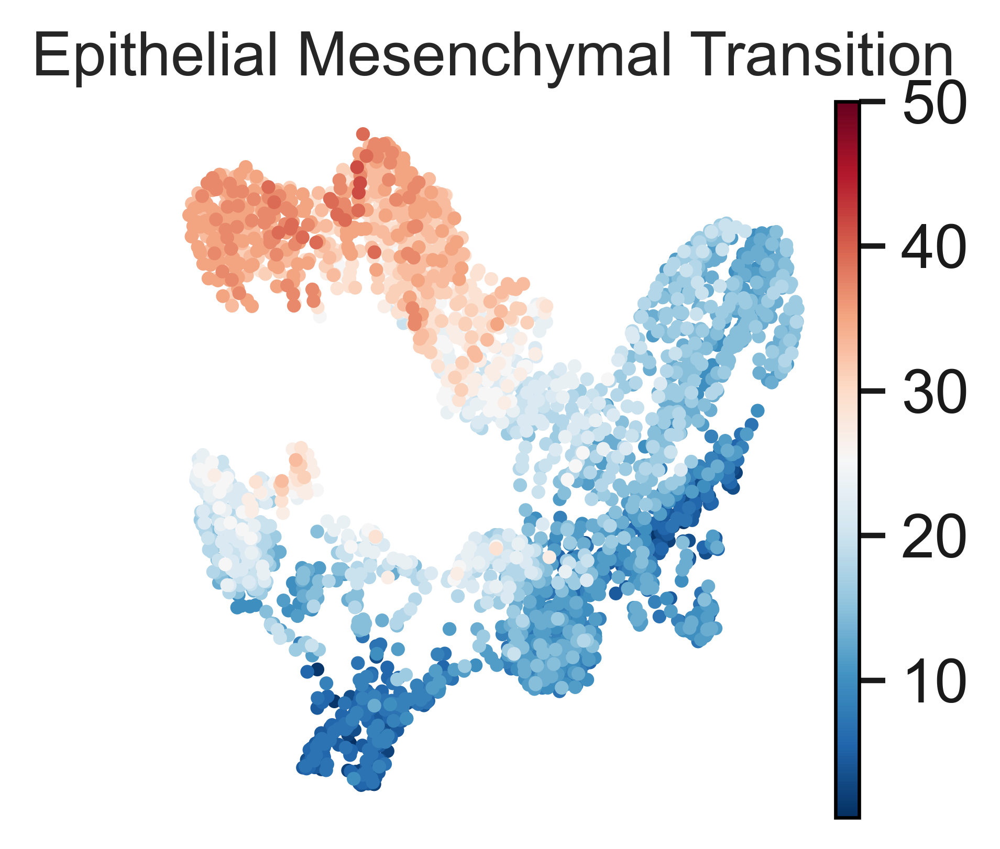

In [280]:
target_geneset = "HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION"

acts.obs[target_obs_label] = acts.obs[target_obs_label].astype("str").astype("category")

acts_arranged_label = ["control"] + ["Predicted %s" % (each) for each in time_point_list]

# acts.obs[target_obs_label] = acts.obs[target_obs_label].cat.reorder_categories(acts_arranged_label)
fig, ax = plt.subplots(figsize=(3, 3))
ax = sc.pl.umap(acts, color=[target_geneset], cmap='RdBu_r', show=False, vmax = 50, ax = ax)
plt.title("Epithelial Mesenchymal Transition")
plot_save_svg()

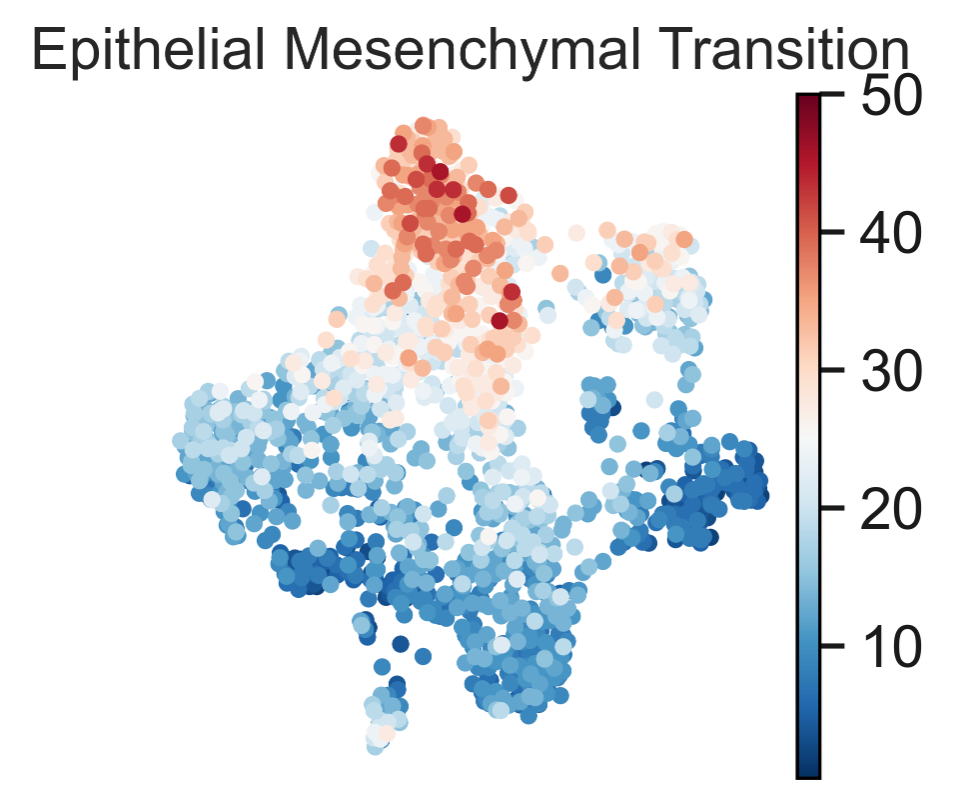

In [281]:
df_gene_group

,time point,EPITHELIAL_MESENCHYMAL_TRANSITION
0,0,7.866707
1,4,12.189446
2,24,22.074430
3,72,20.327663
4,96,19.472977
5,120,22.074430
6,144,22.074430
7,192,20.327663


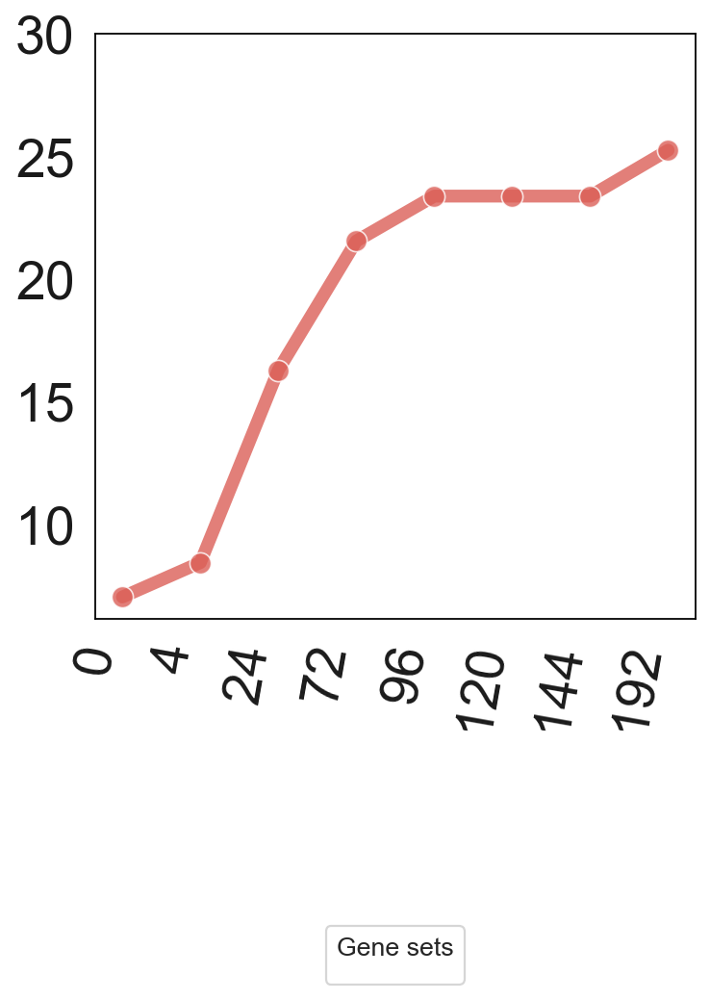

In [282]:
# Geneset enrichment line plot

geneset_df = pd.DataFrame(acts.X, columns = [x[9:] for x in list(acts.var.index)])
geneset_df["time point"] = np.array(acts.obs[target_obs_label])

grouped_geneset_df = geneset_df.groupby(["time point"]).median()
grouped_geneset_df

averages = grouped_geneset_df.mean()

# Identify the top 3 columns based on their average values
top_columns = averages.nlargest(1).index
top_columns

# Set the size of the plot
plt.figure(figsize=(5, 5))

# Define a color palette
palette = sns.color_palette("hls", n_colors=len(top_columns))

df_gene_group = grouped_geneset_df[top_columns]

arranged_label = ["control"] + ["Predicted %s" % (each) for each in time_point_list]

df_gene_group = df_gene_group.loc[arranged_label]
df_gene_group.reset_index(inplace = True)

df_gene_group["time point"] = ["0"] + ["%s" % (each) for each in time_point_list]

# Create the line plot for the top 3 columns with the specified color palette
# for i, column in enumerate(top_columns):

line_plot = sns.lineplot(data=df_gene_group, x = "time point", y = "EPITHELIAL_MESENCHYMAL_TRANSITION", marker='o', color=palette[0], linewidth=6, alpha = 0.8, markersize=10)
    
plt.grid(False)
plt.ylabel("")
plt.ylim(None, 30)
plt.yticks(fontsize = 25)
plt.xlabel("")
plt.xticks(rotation=80, ha = 'right', fontsize = 25)
line_plot.yaxis.set_major_formatter(ticker.FormatStrFormatter('%.0f'))
# Customize the legend
plt.legend(title='Gene sets', loc='upper center', bbox_to_anchor=(0.5, -0.5), ncol=2, handlelength=1)
# plt.tight_layout()
plt.show()

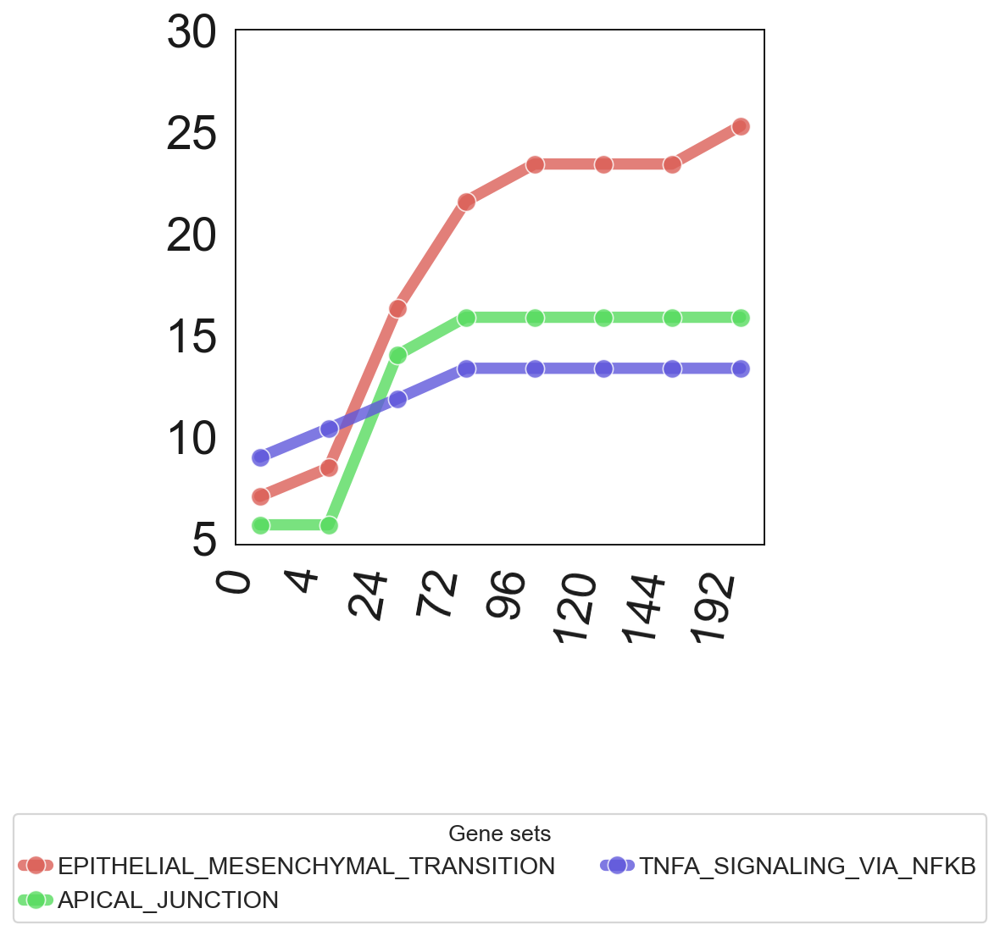

In [283]:
# Geneset enrichment line plot

geneset_df = pd.DataFrame(acts.X, columns = [x[9:] for x in list(acts.var.index)])
geneset_df["time point"] = np.array(acts.obs[target_obs_label])

grouped_geneset_df = geneset_df.groupby(["time point"]).median()
grouped_geneset_df

averages = grouped_geneset_df.mean()

# Identify the top 3 columns based on their average values
top_columns = averages.nlargest(3).index
top_columns

# Set the size of the plot
plt.figure(figsize=(5, 5))

# Define a color palette
palette = sns.color_palette("hls", n_colors=len(top_columns))

df_gene_group = grouped_geneset_df[top_columns]

arranged_label = ["control"] + ["Predicted %s" % (each) for each in time_point_list]

df_gene_group = df_gene_group.loc[arranged_label]

df_gene_group.reset_index(inplace = True)

df_gene_group["time point"] = ["0"] + ["%s" % (each) for each in time_point_list]

# Create the line plot for the top 3 columns with the specified color palette
for i, column in enumerate(top_columns):
    sns.lineplot(data=df_gene_group, x = "time point", y = column, marker='o', label=column, color=palette[i], linewidth=6, alpha = 0.8, markersize=10)
    
plt.grid(False)
plt.ylabel("")
plt.ylim(None, 30)
plt.yticks(fontsize = 25)
plt.xlabel("")
plt.xticks(rotation=80, ha = 'right', fontsize = 25)
# Customize the legend
plt.legend(title='Gene sets', loc='upper center', bbox_to_anchor=(0.5, -0.5), ncol=2, handlelength=1)
# plt.tight_layout()
# plt.show()

plot_save_svg()

## Trajectory Inference analysis

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


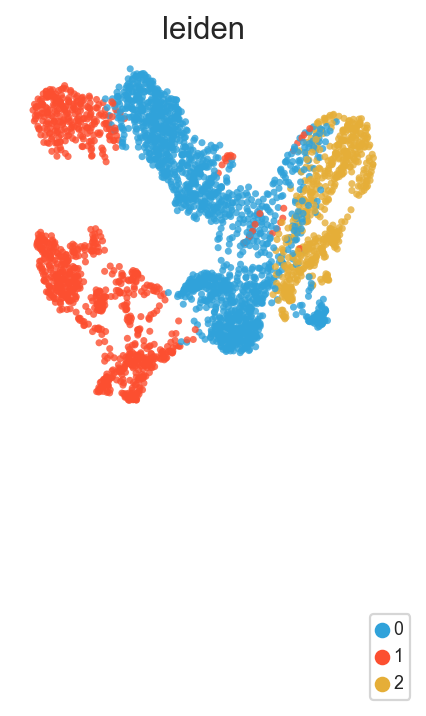

In [284]:
sc.pl.umap(full_pred_adata, color=["leiden"], alpha = 0.8, palette = custom_palette, show = False)
plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
plt.show()
# # Visualize
# sc.pl.umap(full_pred_adata, color='celltype', alpha = 0.8, show = False, edgecolor='w', linewidth=0.0, size=80, palette=custom_palette)
# plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
# plt.show()

In [285]:
# def get_deg_cluster(adata_test_deg, group_name, cluster_name, layer_name = "X_pred", top = 20):

#     '''
#     layer_name must be either X_raw or X_pred
#     '''
#     adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
    
#     # uncomment for raw data degs
#     adata_test_deg.obsm[f'{layer_name}_pca'] = adata_test_deg.layers[layer_name] @ pca_matrix.T

#     sc.tl.dendrogram(adata_test_deg, use_rep = f'{layer_name}_pca', groupby = group_name, optimal_ordering=False)
    
#     adata_test_deg.X = adata_test_deg.layers[layer_name]
#     adata_test_deg.X[adata_test_deg.X < 1] = 0
#     adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
#     sc.tl.rank_genes_groups(adata_test_deg, c, method='wilcoxon', use_raw = False, corr_method='benjamini-hochberg', layer = layer_name, pts = True)

#     deg_fc = compute_logfc(adata_test_deg, cluster_name, group_name, layer_name)

#     deg_df = sc.get.rank_genes_groups_df(adata_test_deg, group = cluster_name, key='rank_genes_groups')
#     deg_df.set_index("names", inplace = True)
#     # deg_df = deg_df.loc[genes]
#     deg_df["logfoldchanges"] = deg_fc

#     # setting the filter parameters
#     # deg_df = deg_df[(deg_df["pct_nz_group"] >= 0.5) & (deg_df["pct_nz_reference"] >= 0.05) & (deg_df["pvals_adj"] < 0.05)]

#     deg_df = deg_df[(deg_df["pvals_adj"] < 0.05)]
    
#     filtered_deg = deg_df.sort_values("logfoldchanges", ascending = False)
    
#     raw_deg = list(filtered_deg.index.values)

#     # we only want to get top 20
#     return raw_deg[:top]

# get_deg_cluster(full_pred_adata, "leiden", "0")

## Cell Type annotation

In [286]:
# import celltypist
# from celltypist import models

# models.download_models(model = ['Immune_All_Low.pkl', 'Immune_All_High.pkl'], force_update = True)
# #Show the local directory storing these models.
# models.models_path

In [287]:
# models.models_description(on_the_fly = True)

In [288]:
# model = models.Model.load(model = 'Cells_Adult_Breast.pkl')

In [289]:
# model.cell_types

In [290]:
# celltypist.annotate(full_pred_adata, model = 'Cells_Adult_Breast.pkl')

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


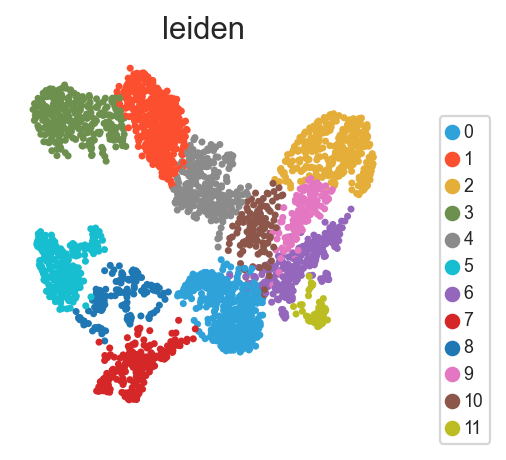

In [526]:
# Create PCA object and fit it to the data
setup_seed(8)
pca = PCA(n_components=50)
pca.fit(full_pred_adata.X.toarray())

pca_matrix_pred = pca.components_

X_pca = full_pred_adata.X @ pca_matrix_pred.T
full_pred_adata.obsm["X_pca"] = X_pca.copy()

sc.pp.neighbors(full_pred_adata, use_rep='X_pca', n_neighbors=30)

# Using the igraph implementation and a fixed number of iterations can be significantly faster, especially for larger datasets
sc.tl.leiden(full_pred_adata, resolution=1.0)
fig, ax = plt.subplots(figsize=(3, 3))
ax = sc.pl.umap(full_pred_adata, color=["leiden"], show = False, palette = custom_palette, ax = ax)
plt.legend(loc = "lower center", bbox_to_anchor=(1.2, -0.1), fontsize = 8, ncol = 1)
plot_save_svg()

In [527]:
# list of marker gene to check
# Fibroblast: DCN LUM
# Endothelial cell: PECAM1
# immune: PTPRC
# Perivascular cell: RGS5
# Epithelial cell: KRT7 KRT8

In [528]:
# all_marker = ["DCN", "KRT7","CDH1", "EPCAM", "CDH1", "EPCAM","KRT14","KRT8","KRT18","MUC1","MKI67", "PCNA"]

# ax = sc.pl.umap(full_pred_adata, color=all_marker, cmap='magma', show = False)
# plot_save_svg()

In [529]:
# all_marker = ["DCN", "KRT7","CDH1", "EPCAM", "CDH1", "EPCAM","KRT14","KRT8","KRT18","MUC1","MKI67", "PCNA"]

# sc.pl.umap(full_dataset, color=all_marker, cmap='magma', return_fig = True)
# plt.show()

In [530]:
# all_marker = ["VIM", "FN1", "CDH2", "SNAI1", "SNAI2", "ZEB1"]

# sc.pl.umap(full_pred_adata, color=all_marker, cmap='magma', return_fig = True)
# plt.show()

In [531]:
# all_marker = ["VIM", "FN1", "CDH2", "SNAI1", "SNAI2", "ZEB1"]

# sc.pl.umap(full_dataset, color=all_marker, cmap='magma', return_fig = True)
# plt.show()

In [532]:
# all_marker = ["CDH1", "EPCAM", "KRT14", "KRT8", "KRT18"]

# sc.pl.umap(full_pred_adata, color=all_marker, cmap='magma', return_fig = True)
# plt.show()

In [533]:
# get all the cell type markers coming from the Cellmarker2.0 paper
# cell_markers = pd.read_excel("Cell_marker_Human.xlsx")
# cell_markers.head()

In [534]:
# breast_cancer_markers = breast_marker[breast_marker["cell_type"] == "Cancer cell"]
# breast_cancer_markers.to_csv("breast_cancer_markers.csv", index = False)

# breast_cancer_markers = pd.read_csv("breast_cancer_markers.csv")
# breast_cancer_markers

In [535]:
# we already filter and clean up the data to get only the normal cell for the breast tissue type.
breast_normal_marker = pd.read_csv("MCF10A_marker.csv")
breast_normal_marker

,cell_name,Symbol,Detail
0,Luminal Epithelial Cells,KRT8,Differentiated cells forming the inner lining ...
1,Luminal Epithelial Cells,KRT18,Differentiated cells forming the inner lining ...
2,Luminal Epithelial Cells,CDH1,Differentiated cells forming the inner lining ...
3,Luminal Epithelial Cells,EPCAM,Differentiated cells forming the inner lining ...
4,Basal Epithelial Cells,KRT14,"Less differentiated, located at the basal laye..."
5,Basal Epithelial Cells,KRT5,"Less differentiated, located at the basal laye..."
6,Basal Epithelial Cells,TP63,"Less differentiated, located at the basal laye..."
7,Basal Epithelial Cells,KRT17,"Less differentiated, located at the basal laye..."
8,Progenitor Epithelial Cells,CD44,Cells with stem-like properties capable of dif...
9,Progenitor Epithelial Cells,ALDH1A1,Cells with stem-like properties capable of dif...


In [536]:
# Query Omnipath and get CelLTypist
# markers = dc.get_resource('CellTypist')
# Remove duplicated entries
markers = breast_normal_marker.copy()
markers = markers[~markers.duplicated(['cell_name', 'Symbol'])]
setup_seed(8)
dc.run_ora(
    mat=full_pred_adata,
    net=markers,
    source='cell_name',
    target='Symbol',
    min_n=1,
    verbose=True,
    use_raw=False
)

acts = dc.get_acts(full_pred_adata, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

df = dc.rank_sources_groups(acts, groupby='leiden', reference='rest', method='t-test_overestim_var')

n_ctypes = 1
ctypes_dict = df.groupby('group').head(n_ctypes).groupby('group')['names'].apply(lambda x: list(x)).to_dict()
ctypes_dict

184 features of mat are empty, they will be removed.
Running ora on mat with 2992 samples and 1816 targets for 5 sources.


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2992/2992 [00:02<00:00, 1044.13it/s]


{'0': ['Luminal Epithelial Cells'],
 '1': ['Mesenchymal Cells'],
 '10': ['Luminal Epithelial Cells'],
 '11': ['Luminal Epithelial Cells'],
 '2': ['Luminal Epithelial Cells'],
 '3': ['Mesenchymal Cells'],
 '4': ['Mesenchymal Cells'],
 '5': ['Myoepithelial Cells'],
 '6': ['Luminal Epithelial Cells'],
 '7': ['Luminal Epithelial Cells'],
 '8': ['Basal Epithelial Cells'],
 '9': ['Luminal Epithelial Cells']}

In [538]:
# markers = markers[~markers.duplicated(['cell_subtype', 'genesymbol'])]
# markers

In [539]:
# sc.pl.umap(acts, color=['Epithelial cells'], cmap='RdBu_r')

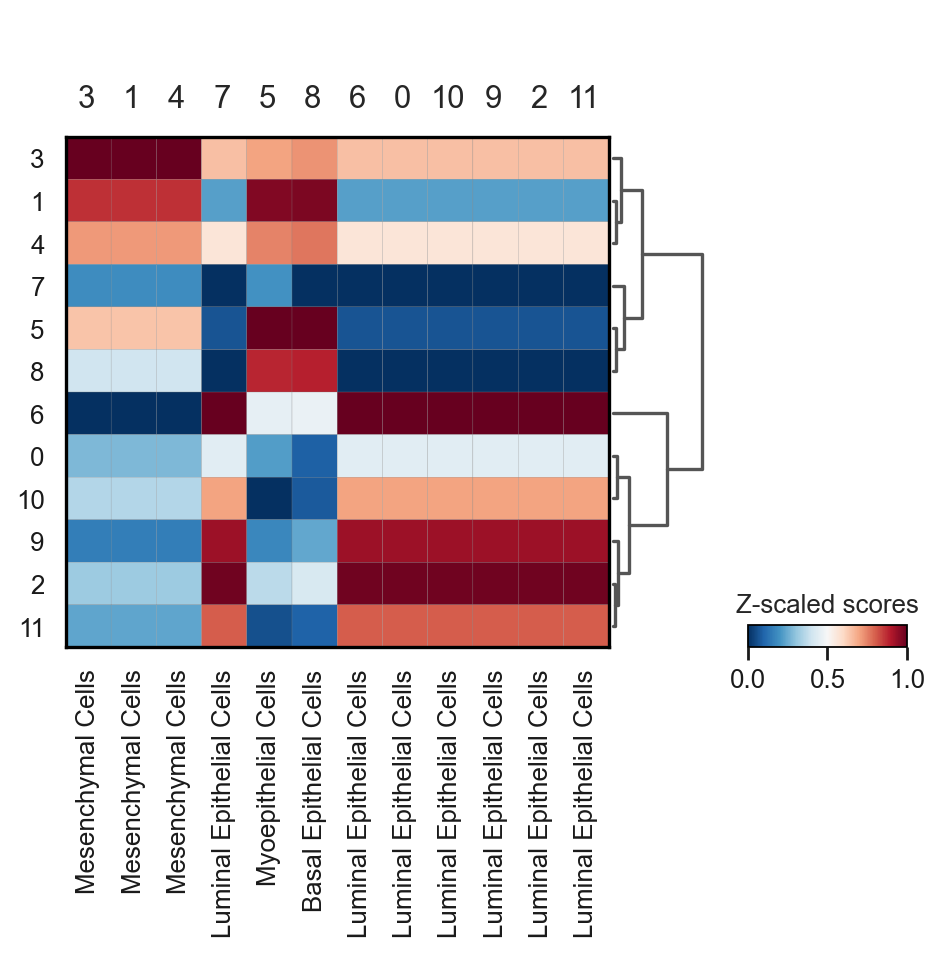

In [540]:
sc.tl.dendrogram(acts, groupby = 'leiden')

sc.pl.matrixplot(acts, ctypes_dict, 'leiden', dendrogram=True, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='RdBu_r')
plt.show()

In [541]:
annotation_dict = df.groupby('group').head(1).set_index('group')['names'].to_dict()
# manually adjust the cluster label
# annotation_dict["11"] = "Luminal epithelial cell"
# Add cell type column based on annotation
full_pred_adata.obs['celltype'] = [annotation_dict[clust] for clust in full_pred_adata.obs['leiden']]

In [542]:
annotation_dict

{'0': 'Luminal Epithelial Cells',
 '1': 'Mesenchymal Cells',
 '10': 'Luminal Epithelial Cells',
 '11': 'Luminal Epithelial Cells',
 '2': 'Luminal Epithelial Cells',
 '3': 'Mesenchymal Cells',
 '4': 'Mesenchymal Cells',
 '5': 'Myoepithelial Cells',
 '6': 'Luminal Epithelial Cells',
 '7': 'Luminal Epithelial Cells',
 '8': 'Basal Epithelial Cells',
 '9': 'Luminal Epithelial Cells'}

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


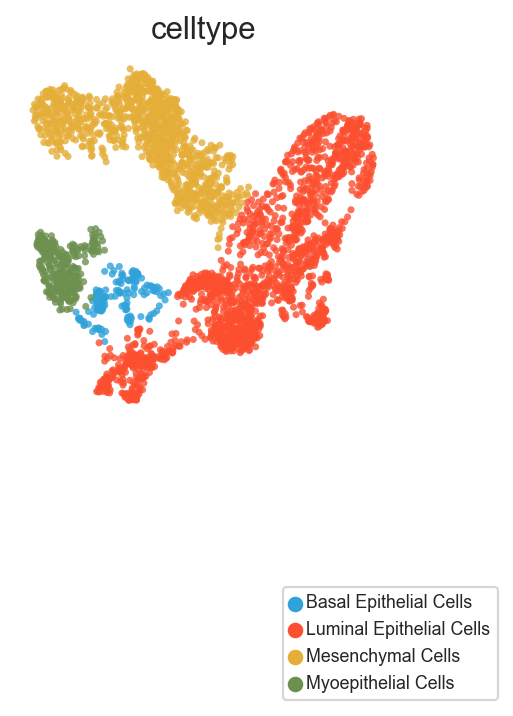

In [543]:
# Visualize
fig, ax = plt.subplots(figsize=(3, 3))
ax = sc.pl.umap(full_pred_adata, color='celltype', alpha = 0.8, show = False, edgecolor='w', linewidth=0.0, palette=custom_palette, ax = ax)
plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
plot_save_svg()

In [784]:
# marker_genes_plot = list(set(["KRT8","MUC1", "KRT18", "SYTL2", "KRT14", "VIM", "TP63", "MYLK", "FN1", "CDH2", "FAP", "MCAM"] + \
# ["KRT8","MUC1", "KRT18", "SYTL2", "CD24", "CDH1", "ALCAM", "TP63", "KRT14", "EPCAM",
#              "S100A9", "MCAM"]))
marker_genes_plot = ['CDH1', 'EPCAM', 'KRT14', 'MUC1', 'FAP', 'FN1', 'LOX', 'VIM', 'TP63', 'KRT17',
       'KRT8', 'TP63', 'KRT8', 'CDH2','SNAI2']

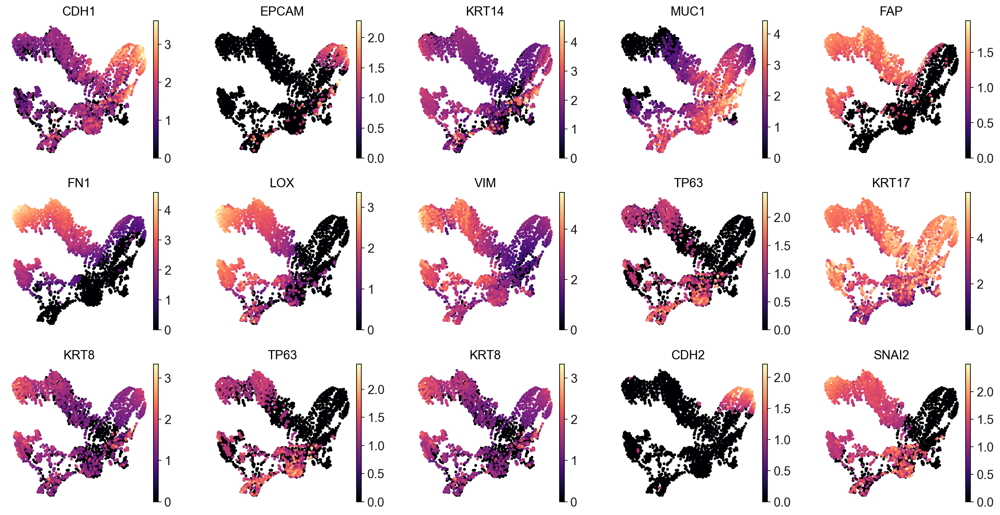

In [785]:
# checking for the marker genes related to the cell type
# all_marker = ["KRT8","MUC1", "KRT18", "SYTL2", "KRT14", "VIM", "TP63", "MYLK", "FN1", "CDH2", "FAP", "MCAM"]

sc.pl.umap(full_pred_adata, color=marker_genes_plot, cmap='magma', return_fig = True, ncols=5)
# plt.show()
plot_save_svg()

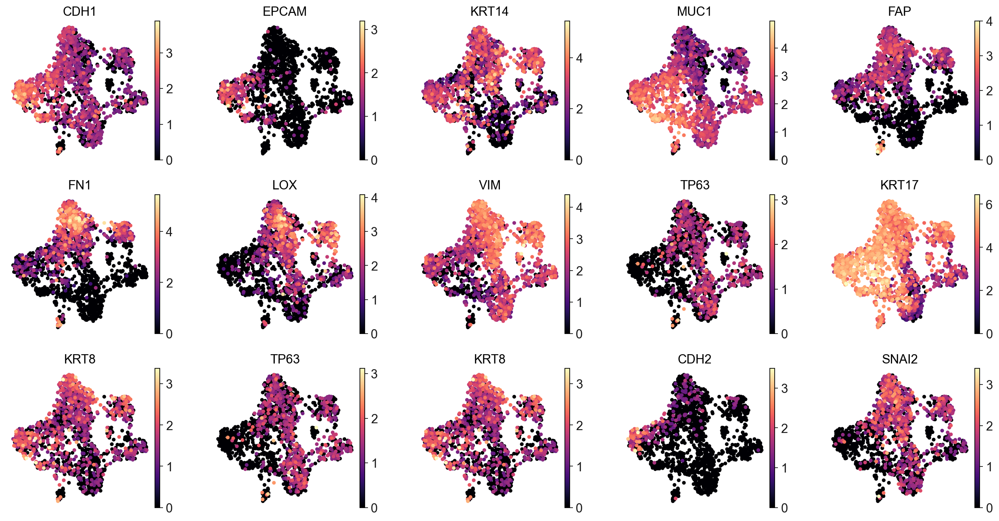

In [786]:
# checking for the marker genes related to the cell type

# all_marker = ["KRT8","MUC1", "KRT18", "SYTL2", "KRT14", "VIM", "TP63", "MYLK", "FN1", "CDH2", "FAP", "MCAM"]
sc.pl.umap(full_dataset, color=marker_genes_plot, cmap='magma', ncols = 5, return_fig = True)
# plt.show()
plot_save_svg()

## Raw data

In [312]:
# Query Omnipath and get CelLTypist
# markers = dc.get_resource('CellTypist')
# Remove duplicated entries
# markers = markers[~markers.duplicated(['Cell Type 1', 'Gene'])]

dc.run_ora(
    mat=full_dataset,
    net=markers,
    source='cell_name',
    target='Symbol',
    min_n=3,
    verbose=True,
    use_raw=False
)

Running ora on mat with 1749 samples and 2000 targets for 12 sources.


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1749/1749 [00:01<00:00, 1076.73it/s]


/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


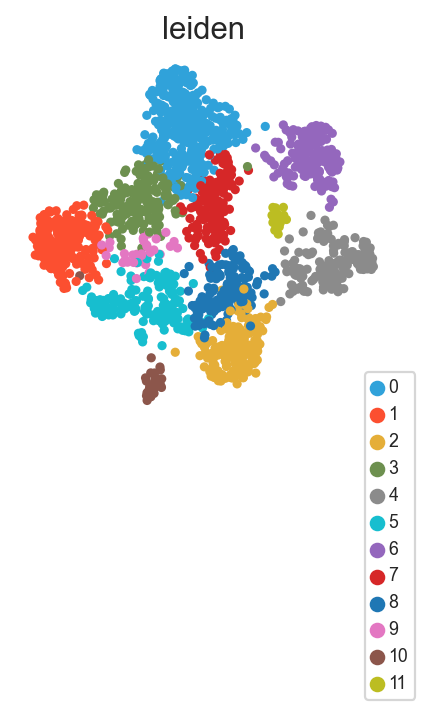

In [313]:
# Create PCA object and fit it to the data
setup_seed(8)
pca = PCA(n_components=50)
pca.fit(full_dataset.X.toarray())

pca_matrix_raw = pca.components_

X_pca = full_dataset.X @ pca_matrix_raw.T
full_dataset.obsm["X_pca"] = X_pca.copy()

sc.pp.neighbors(full_dataset, use_rep='X_pca', n_neighbors=30)

# Using the igraph implementation and a fixed number of iterations can be significantly faster, especially for larger datasets
sc.tl.leiden(full_dataset, resolution=None)

sc.pl.umap(full_dataset, color=["leiden"], show = False, palette = custom_palette)
plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
plt.show()

In [572]:
full_pred_adata

AnnData object with n_obs × n_vars = 2992 × 2000
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'percent_mt', 'RNA_snn_res_0_8', 'seurat_clusters', 'cell_type', 'cell_type_score', 'sampling_weight', 'Sample', 'Project', 'Status', 'Sample Type', 'Platform', 'Cellline', 'Condition (Hour)', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'batch', 'celltype'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'neighbors', 'umap', 'leiden_colors', 'leiden', 'dendrogram_leiden', 'celltype_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    obsp: 'distances', 'connectivities'

In [573]:
acts = dc.get_acts(full_dataset, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

df = dc.rank_sources_groups(acts, groupby='leiden', reference='rest', method='t-test_overestim_var')
df

,group,reference,names,statistic,meanchange,pvals,pvals_adj
0,0,rest,HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION,29.126120,15.006721,1.638221e-121,8.191103e-120
1,0,rest,HALLMARK_APICAL_JUNCTION,23.413654,7.446470,1.689893e-89,4.224732e-88
2,0,rest,HALLMARK_ANDROGEN_RESPONSE,18.981023,3.848849,8.090179e-65,1.348363e-63
3,0,rest,HALLMARK_MYOGENESIS,13.421561,2.333364,1.131364e-36,1.414205e-35
4,0,rest,HALLMARK_HEDGEHOG_SIGNALING,11.234737,0.967363,5.419253e-27,3.870895e-26
...,...,...,...,...,...,...,...
595,9,rest,HALLMARK_DNA_REPAIR,-2.566908,-0.459922,1.308107e-02,9.343622e-02
596,9,rest,HALLMARK_MTORC1_SIGNALING,-2.650960,-1.373302,1.025119e-02,8.542658e-02
597,9,rest,HALLMARK_PI3K_AKT_MTOR_SIGNALING,-3.047009,-1.221393,3.334891e-03,4.168614e-02
598,9,rest,HALLMARK_P53_PATHWAY,-3.158414,-2.779514,2.462482e-03,4.104137e-02


In [574]:
n_ctypes = 1
ctypes_dict = df.groupby('group').head(n_ctypes).groupby('group')['names'].apply(lambda x: list(x)).to_dict()
ctypes_dict

{'0': ['HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION'],
 '1': ['HALLMARK_KRAS_SIGNALING_UP'],
 '10': ['HALLMARK_TNFA_SIGNALING_VIA_NFKB'],
 '11': ['HALLMARK_REACTIVE_OXYGEN_SPECIES_PATHWAY'],
 '2': ['HALLMARK_UV_RESPONSE_UP'],
 '3': ['HALLMARK_TGF_BETA_SIGNALING'],
 '4': ['HALLMARK_E2F_TARGETS'],
 '5': ['HALLMARK_ESTROGEN_RESPONSE_EARLY'],
 '6': ['HALLMARK_E2F_TARGETS'],
 '7': ['HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION'],
 '8': ['HALLMARK_UV_RESPONSE_UP'],
 '9': ['HALLMARK_INTERFERON_ALPHA_RESPONSE']}

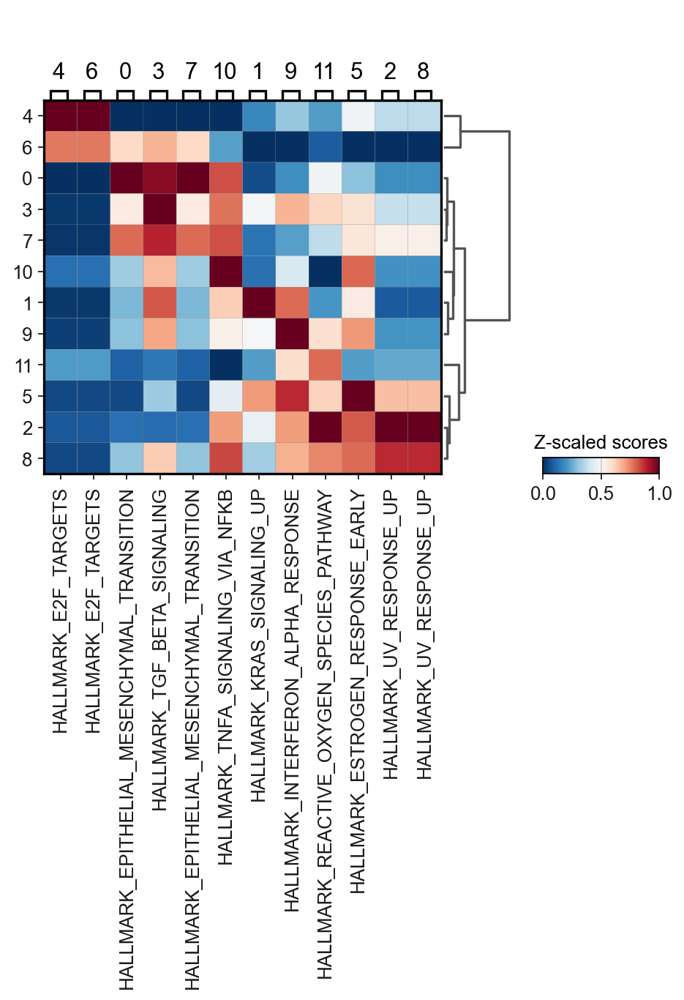

In [575]:
sc.tl.dendrogram(acts, groupby = 'leiden')

sc.pl.matrixplot(acts, ctypes_dict, 'leiden', dendrogram=True, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='RdBu_r')


In [576]:
annotation_dict = df.groupby('group').head(1).set_index('group')['names'].to_dict()
# Add cell type column based on annotation
full_dataset.obs['celltype'] = [annotation_dict[clust] for clust in full_dataset.obs['leiden']]

/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


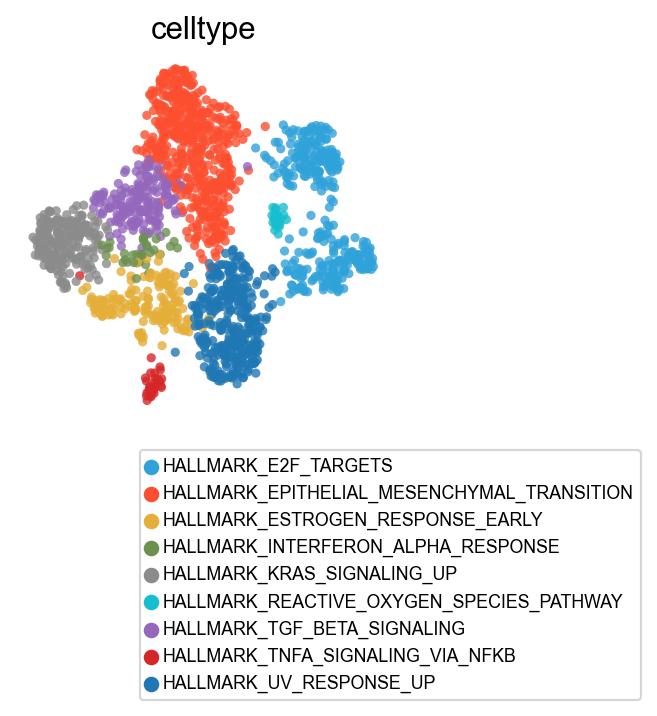

In [577]:
# Visualize
sc.pl.umap(full_dataset, color='celltype', alpha = 0.8, show = False, edgecolor='w', linewidth=0.0, palette=custom_palette)
plt.legend(loc = "lower center", bbox_to_anchor=(1, -0.8), fontsize = 8, ncol = 1)
plt.show()

## Heatmap of the gene module

In [578]:
def get_deg_time(adata_test_deg, target_group, layer_name = "X_raw", top = 20):

    '''
    layer_name must be either X_raw or X_pred
    '''
    adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()

    # convert from the integer into str and categorical
    adata_test_deg.obs[target_obs_label] = adata_test_deg.obs[target_obs_label].astype("str").astype("category")
    
    # uncomment for raw data degs
    adata_test_deg.obsm[f'{layer_name}_pca'] = adata_test_deg.layers[layer_name] @ pca_matrix.T

    sc.tl.dendrogram(adata_test_deg, use_rep = f'{layer_name}_pca', groupby = group_name, optimal_ordering=False)
    
    group_index = 0
    adata_test_deg.X = adata_test_deg.layers[layer_name]
    adata_test_deg.X[adata_test_deg.X < 1] = 0
    adata_test_deg.layers[layer_name] = adata_test_deg.X.copy()
    sc.tl.rank_genes_groups(adata_test_deg, group_name, method='wilcoxon', use_raw = False, corr_method='benjamini-hochberg', layer = layer_name, pts = True)

    deg_fc = compute_logfc(adata_test_deg, groups[group_index], group_name, layer_name)

    
    deg_df = sc.get.rank_genes_groups_df(adata_test_deg, group = target_group, key='rank_genes_groups')
    deg_df.set_index("names", inplace = True)
    # deg_df = deg_df.loc[genes]
    deg_df["logfoldchanges"] = deg_fc

    # setting the filter parameters
    # deg_df = deg_df[(deg_df["pct_nz_group"] >= 0.5) & (deg_df["pct_nz_reference"] >= 0.05) & (deg_df["pvals_adj"] < 0.05)]

    deg_df = deg_df[(deg_df["pvals_adj"] < 0.05)]
    
    filtered_deg = deg_df.sort_values("logfoldchanges", ascending = False)
    
    raw_deg = list(filtered_deg.index.values)

    # we only want to get top 20
    return raw_deg[:top]

In [590]:
import seaborn as sns
sns.set_theme(style="whitegrid")

In [591]:
gene_list = ["EPCAM", "KRT14", "MUC1", "FN1", "LOX", "VIM"]

def plot_heatmap_gene(full_dataset, gene_list):

    # ground truth data
    heatmap_adata = full_dataset[:, gene_list].copy()
    gene_expr = heatmap_adata.X.toarray().copy()
    metadata = heatmap_adata.obs[target_obs_label]
    
    gene_expr = pd.DataFrame(gene_expr)
    gene_expr.columns = gene_list
    gene_expr[target_obs_label] = metadata.values
    gene_expr.head()
    
    data = gene_expr.groupby([target_obs_label]).mean().transpose()

    # rearrange from 0 to 192
    try:
        data = data[["0", "4", "24", "72", "96", "120", "144", "192"]]
    except:
        data = data[["control", "Predicted 4", "Predicted 24", "Predicted 72", "Predicted 96", "Predicted 120", "Predicted 144", "Predicted 192"]]
        data.columns = ["0", "4", "24", "72", "96", "120", "144", "192"]
    # Calculate aspect ratio
    n_rows, n_cols = data.shape
    aspect_ratio = n_cols / n_rows

    # Create a clustered heatmap with square cells
    clustered_heatmap = sns.clustermap(
        data, 
        annot=False, 
        linewidths=2, 
        cmap='OrRd', 
        cbar_kws={"shrink": .9, "orientation": "horizontal"}, 
        col_cluster=False,
        cbar_pos=(1.25, 0.2, 0.25, 0.02),  # Adjusted color bar position for horizontal orientation
        dendrogram_ratio=(0.1, 0.2), 
        figsize=(7, 7 / aspect_ratio),  # Adjust figsize to get square cells
        vmin=0, 
        vmax=3
    )

    # Customize the color bar font size
    colorbar = clustered_heatmap.cax
    colorbar.tick_params(labelsize=24)  # Change the font size here
    colorbar.set_title("Mean Expression", fontsize=24)
    # Add border to the color bar
    for spine in colorbar.spines.values():
        spine.set_edgecolor('black')
        spine.set_linewidth(2)
    
    # Rotate x-tick and y-tick labels
    plt.setp(clustered_heatmap.ax_heatmap.get_xticklabels(), rotation=90, fontsize=32, ha="center")
    plt.setp(clustered_heatmap.ax_heatmap.get_yticklabels(), rotation=0, fontsize=32)
    
    clustered_heatmap.ax_heatmap.set_xlabel('', fontsize=14)
    
    # Show the clustered heatmap
    # plt.show()
    plt.grid(False)
    plot_save_svg()

# plot_heatmap_gene(full_dataset, gene_list)

/tmp/ipykernel_84595/3061632486.py:18: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0


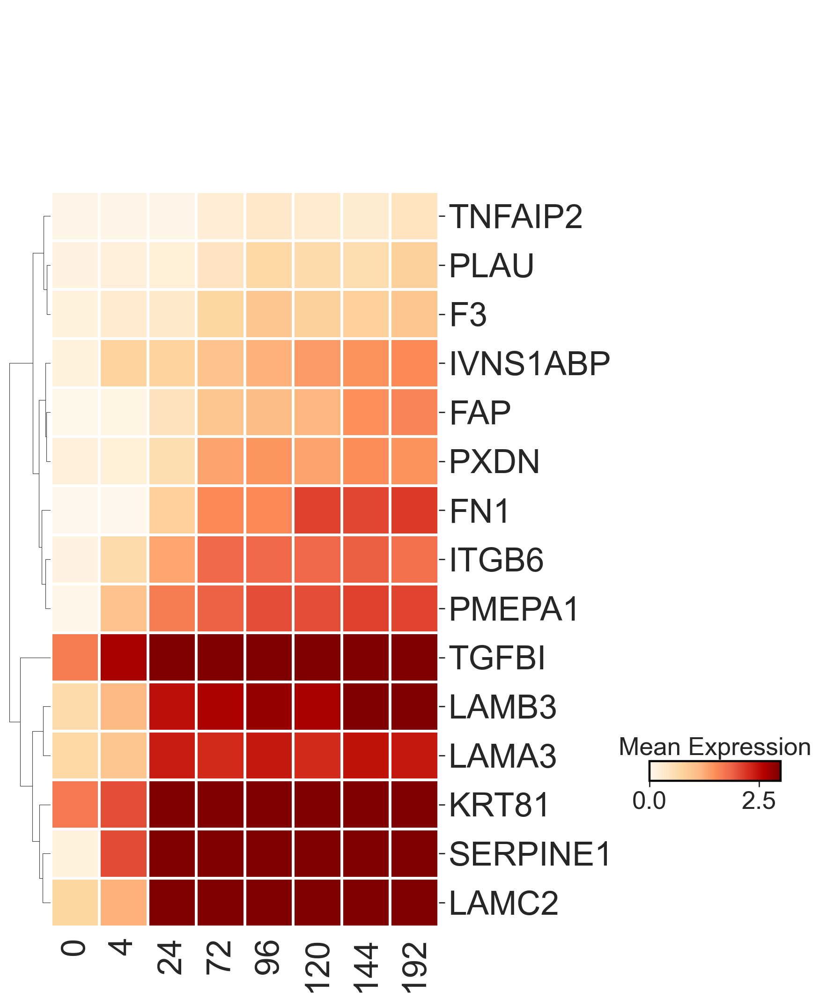

In [592]:
plot_heatmap_gene(full_dataset, get_deg_time(full_dataset, target_group = "192", top=15))

/tmp/ipykernel_84595/3061632486.py:18: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


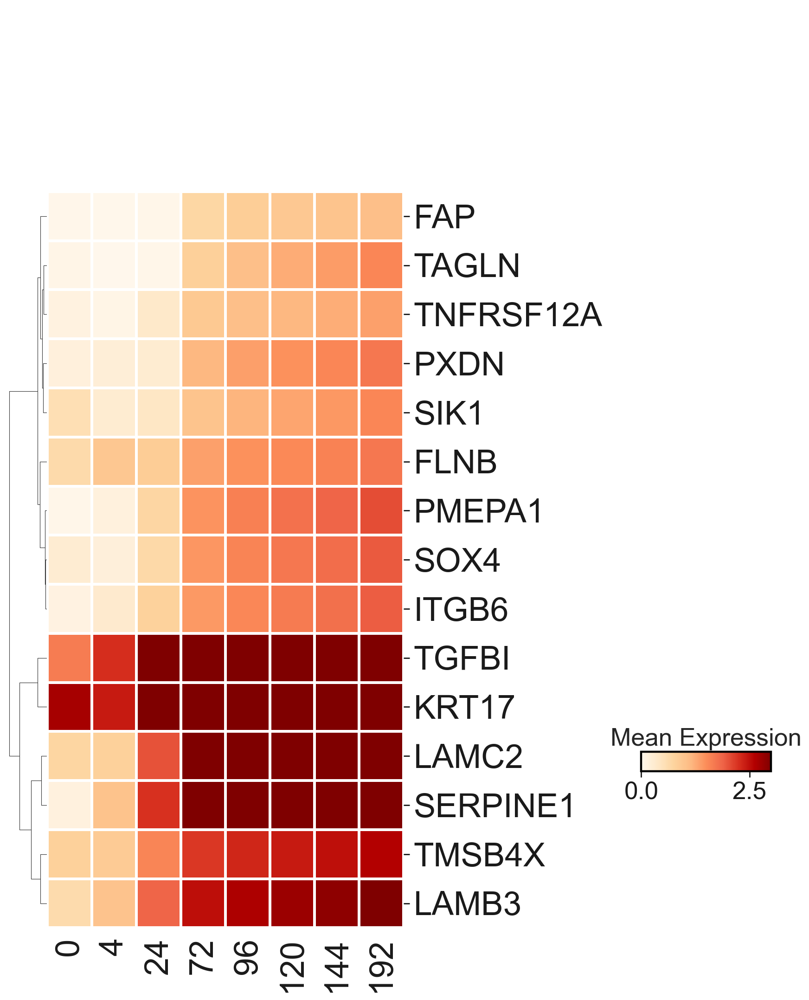

In [593]:
plot_heatmap_gene(full_pred_adata, get_deg_time(full_pred_adata, target_group = "Predicted 192", top=15))

In [582]:
len(get_deg_time(full_dataset, target_group = "192", top=100))

/tmp/ipykernel_84595/3061632486.py:18: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0


100

/tmp/ipykernel_84595/3061632486.py:18: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/tmp/ipykernel_84595/4015562233.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(all_data["Term"], fontsize=25)


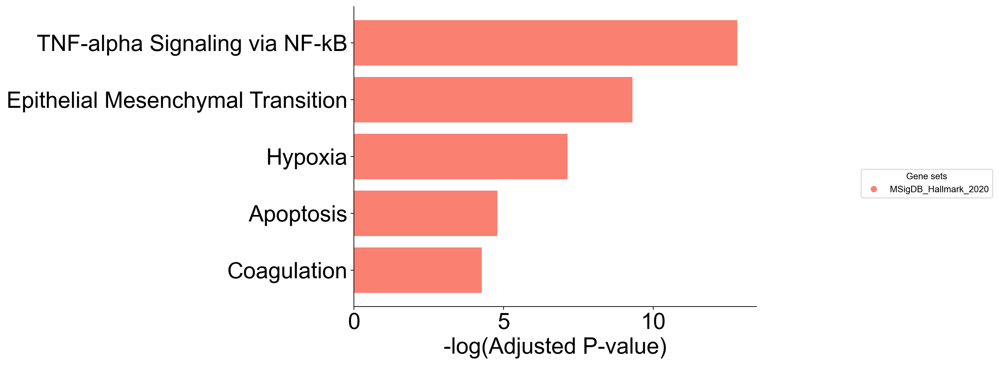

In [779]:
import gseapy
from matplotlib.lines import Line2D 

# gene sets
gene_sets = ['MSigDB_Hallmark_2020']

# enrichment analysis
enr_res = gseapy.enrichr(gene_list=get_deg_time(full_dataset, target_group = "192", top=100),
                     organism='Human',
                     gene_sets=gene_sets,
                     # description='Ontologies',
                     cutoff = 0.5)

# changing the term and get the top 5
GO_BP = enr_res.results[enr_res.results["Gene_set"] == "MSigDB_Hallmark_2020"].head(5)

# concatenate
# all_data = pd.concat([GO_BP, GO_CC,KEGG]).sort_values("Adjusted P-value")
all_data = pd.concat([GO_BP]).sort_values("Adjusted P-value")

# plotting function
plt.rcdefaults()
fig, ax = plt.subplots(figsize=(8, 6))

colors = {"MSigDB_Hallmark_2020": "salmon"}

ax.barh(all_data["Term"], -np.log10(all_data["Adjusted P-value"]), align='center', color = all_data["Gene_set"].map(colors))
# ax.barh(GO_CC["Term"].str.split(" \(GO").str[0], -np.log10(GO_CC["Adjusted P-value"]), align='center', label = "GO:CC")
# ax.barh(KEGG["Term"], -np.log10(KEGG["Adjusted P-value"]), align='center', label = "KEGG")
ax.invert_yaxis()  # labels read top-to-bottom
ax.grid(False)
ax.set_yticklabels(all_data["Term"], fontsize=25)

# Increase the fontsize of the x-axis tick labels
ax.tick_params(axis='x', labelsize=25)

ax.set_xlabel('-log(Adjusted P-value)', fontsize = 25)
axbox = ax.get_position()
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in colors.items()]
ax.legend(loc='center right', handles = handles, bbox_to_anchor=(axbox.x0 + axbox.width * 1.9, axbox.y0 + 0.3), title = "Gene sets")
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
# ax.spines['left'].set_visible(False)
# plt.show()
plot_save_svg()

/tmp/ipykernel_84595/3061632486.py:18: SparseEfficiencyWarning: Comparing a sparse matrix with a scalar greater than zero using < is inefficient, try using >= instead.
  adata_test_deg.X[adata_test_deg.X < 1] = 0
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/rom/miniforge3/envs/genex/lib/python3.10/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/tmp/ipykernel_84595/3496981988.py:30: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(all_data["Term"], fontsize=25)


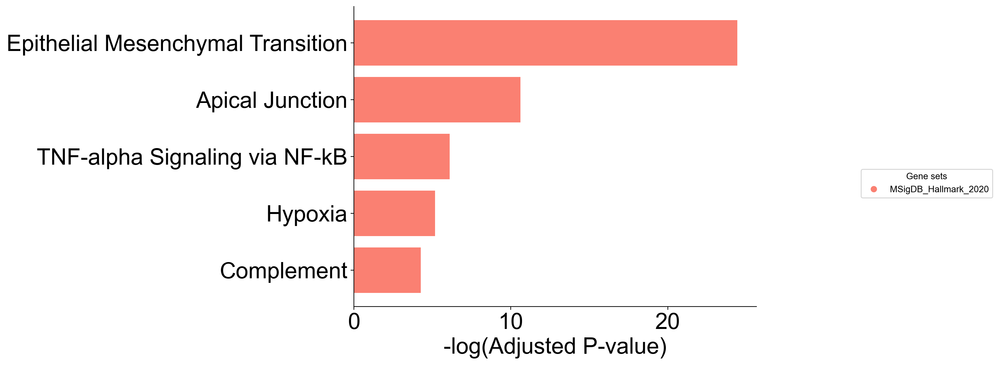

In [781]:
# gene sets
gene_sets = ['MSigDB_Hallmark_2020']

# enrichment analysis
enr_res = gseapy.enrichr(gene_list=get_deg_time(full_pred_adata, target_group = "Predicted 192", top=100),
                     organism='Human',
                     gene_sets=gene_sets,
                     # description='Ontologies',
                     cutoff = 0.5)

# changing the term and get the top 5
GO_BP = enr_res.results[enr_res.results["Gene_set"] == "MSigDB_Hallmark_2020"].head(5)

# concatenate
# all_data = pd.concat([GO_BP, GO_CC,KEGG]).sort_values("Adjusted P-value")
all_data = pd.concat([GO_BP]).sort_values("Adjusted P-value")

# plotting function
plt.rcdefaults()
fig, ax = plt.subplots(figsize=(8, 6))

# colors = {"MSigDB_Hallmark_2020": "salmon", "Reactome_2022": "palegreen", "KEGG_2021_Human": "plum"}
colors = {"MSigDB_Hallmark_2020": "salmon"}

ax.barh(all_data["Term"], -np.log10(all_data["Adjusted P-value"]), align='center', color = all_data["Gene_set"].map(colors))
# ax.barh(GO_CC["Term"].str.split(" \(GO").str[0], -np.log10(GO_CC["Adjusted P-value"]), align='center', label = "GO:CC")
# ax.barh(KEGG["Term"], -np.log10(KEGG["Adjusted P-value"]), align='center', label = "KEGG")
ax.invert_yaxis()  # labels read top-to-bottom
ax.grid(False)
ax.set_yticklabels(all_data["Term"], fontsize=25)

# Increase the fontsize of the x-axis tick labels
ax.tick_params(axis='x', labelsize=25)

ax.set_xlabel('-log(Adjusted P-value)', fontsize = 25)
axbox = ax.get_position()
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in colors.items()]
ax.legend(loc='center right', handles = handles, bbox_to_anchor=(axbox.x0 + axbox.width * 1.9, axbox.y0 + 0.3), title = "Gene sets")
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
# ax.spines['left'].set_visible(False)
# plt.show()
plot_save_svg()

## Other cell mapping from treated to control

In [ ]:
import scanpy as sc
import pandas as pd
import seaborn as sns

# verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.verbosity = 1
sc.settings.set_figure_params(
    dpi=300, frameon=False, figsize=(3, 3), facecolor='white')

In [ ]:
# mapping from 192 to 0
# treated_cell = adata_test.copy()
testing_label = "4"
treated_cell = full_dataset[full_dataset.obs[target_obs_label] == testing_label].copy()

In [ ]:
treated_cell.obs[target_obs_label]

In [ ]:
control_test.obs[target_obs_label]

In [ ]:
test_data = treated_cell.X

batch_size = test_data.shape[0]

target_array = [0.0] * batch_size
target_tensor = FloatTensor(target_array).unsqueeze(1)

with torch.no_grad():
    imgs = Variable(FloatTensor(test_data.toarray())).to(device_ids[0])
    src_labels = Variable(target_tensor).to(device_ids[0])

    static_sample = generate_data(G_AB, imgs, src_labels).cpu().detach().numpy()
output_results = static_sample

# creating the metadata for control cells
data = np.array([testing_label])
repeated_data = np.tile(data[np.newaxis, :], (batch_size, 1))
pred_meta = pd.DataFrame(repeated_data, columns=[target_obs_label])
pred_meta["cell_type"] = np.array(treated_cell.obs["cell_type"])

# getting the true population and its metadata
true_perturb_pop = control_test[control_test.obs[target_obs_label] == "control"].X.toarray()
pop_meta = control_test[control_test.obs[target_obs_label] == "control"].obs

combine_meta = pd.concat([pred_meta[[target_obs_label, "cell_type"]], pop_meta[[target_obs_label, "cell_type"]]])
combine_gene_exp = np.concatenate([output_results, true_perturb_pop])

print(combine_meta.head())
print(combine_gene_exp.shape)

pred_test_adata = AnnData(
    X=combine_gene_exp,
    obs=combine_meta
)

# for reproducibility
setup_seed(8)

# pca = PCA(n_components = 50, random_state = 8)
# pca.fit(pred_test_adata.X)
# pca_matrix_new = pca.components_

X_pca = pred_test_adata.X @ pca_matrix.T
pred_test_adata.obsm["X_pca"] = X_pca.copy()

# compute neighbor and plotting function
pred_test_adata.obs[target_obs_label].replace(testing_label, "Predicted Cells", inplace = True)
pred_test_adata.obs[target_obs_label].replace("control", "0", inplace = True)

# adding the starting point
pred_test_adata.var = treated_cell.var

pred_test_adata = pred_test_adata.concatenate(treated_cell)

sc.pp.neighbors(pred_test_adata, use_rep='X_pca', n_neighbors=30)

# sc.external.pp.bbknn(adata_all, batch_key='batch', use_rep='X_latent')
sc.tl.umap(pred_test_adata)

custom_palette = cc.glasbey_hv

pred_test_adata.obs[target_obs_label] = pd.Categorical(pred_test_adata.obs[target_obs_label])
print(pred_test_adata.obs[target_obs_label])
pred_test_adata.obs[target_obs_label] = pred_test_adata.obs[target_obs_label].cat.reorder_categories(["Predicted Cells", "0", testing_label])

# setup_seed(8)
random_indices=np.random.permutation(list(range(pred_test_adata.shape[0])))
# sc.pl.umap(plot_adata[random_indices, :], color=[target_obs_label], alpha = 0.8, legend_fontsize = 9, return_fig = True,
#            palette=customed_color)

sc.pl.umap(pred_test_adata[random_indices,:], color=[target_obs_label], wspace = 0.5, alpha = 0.8, return_fig = True,
           palette=customed_color)

plot_save_svg()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Generating a random matrix
matrix = np.random.rand(5, 3)

# Creating a heatmap with a color range from light grey to dark grey
fig, ax = plt.subplots(figsize=(8, 8))  # Adjusting the figure size to be square
cax = ax.matshow(matrix, cmap='Oranges', aspect='equal')
# Setting grid
ax.set_xticks(np.arange(-.5, 3, 1), minor=True)
ax.set_yticks(np.arange(-.5, 3, 1), minor=True)
ax.grid(which='minor', color='black', linestyle='-', linewidth=2)
# Hiding tick labels
ax.tick_params(which='both', bottom=False, left=False, labelbottom=False, labelleft=False)
# Removing tick labels explicitly
ax.set_xticks([])
ax.set_yticks([])

plt.title('')
plt.grid(False)
plot_save_svg()